**ENCS5141, INTELLIGENT SYSTEMS LAB**


---

**Assignment III**

---
**Raghad Afaghani 1192423**

---


**Abstract**

This case study aims to compare the performance of three clustering algorithms (K-means, Gaussian Mixture Model, and DBSCAN) in image segmentation tasks. The evaluation includes both qualitative and quantitative assessments, with a focus on the impact of feature space variation (RGB vs. augmented with coordinates) and data preprocessing (standardization).

**Image Used**

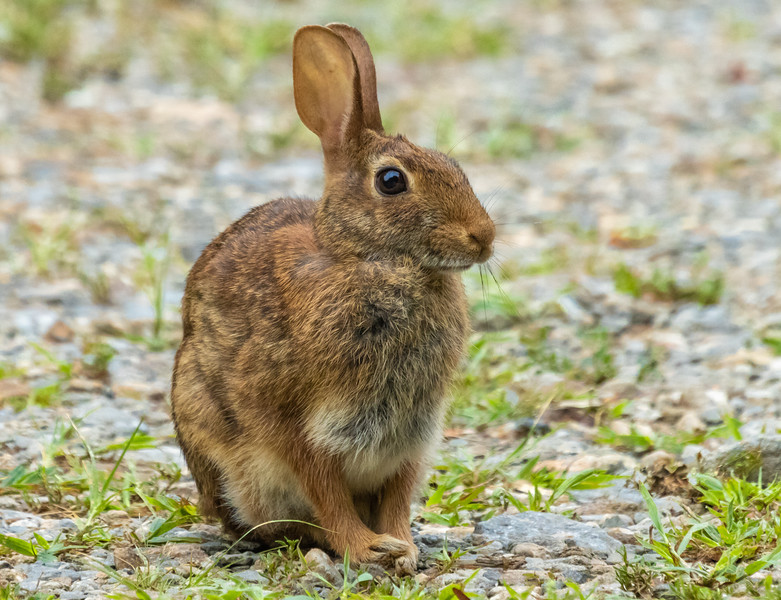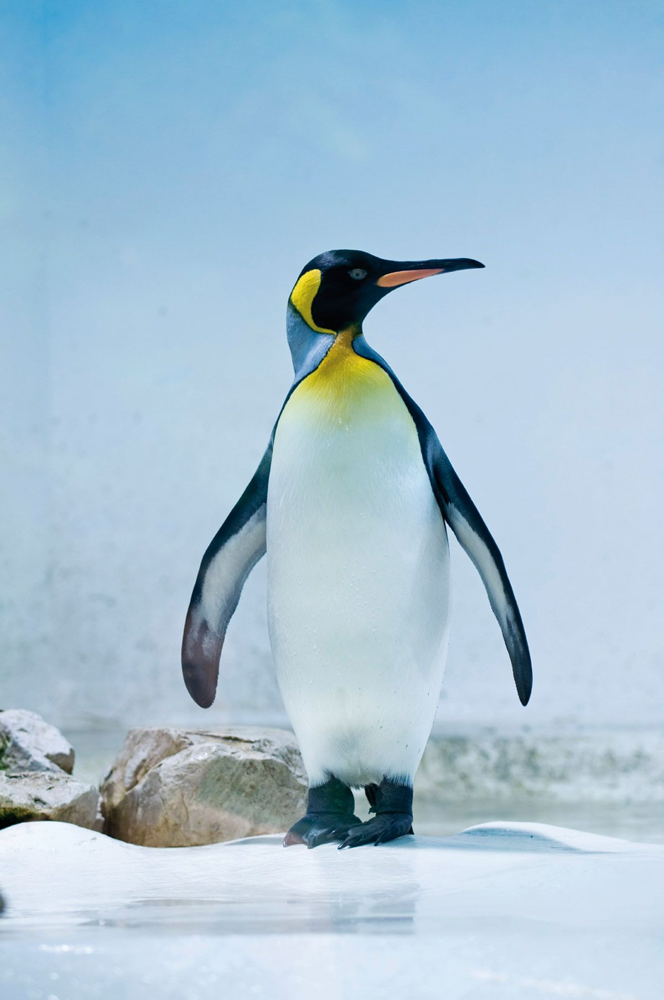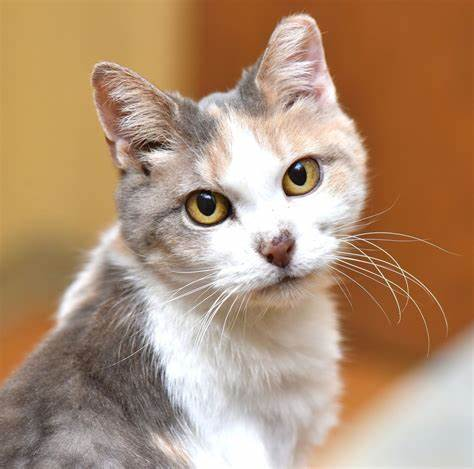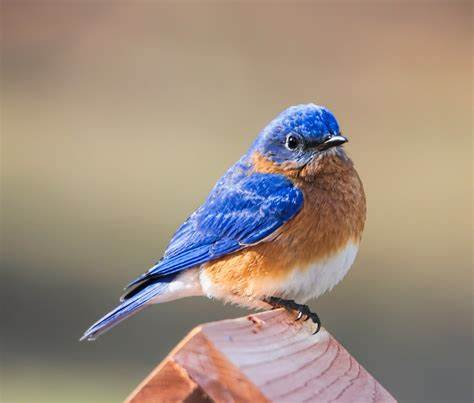

***K-Mean***

 Trying K-means clustering for image segmentation with different numbers of clusters (K=2, K=5, K=10) and under different conditions (RGB Space, Augmented Space, Standardized Space)

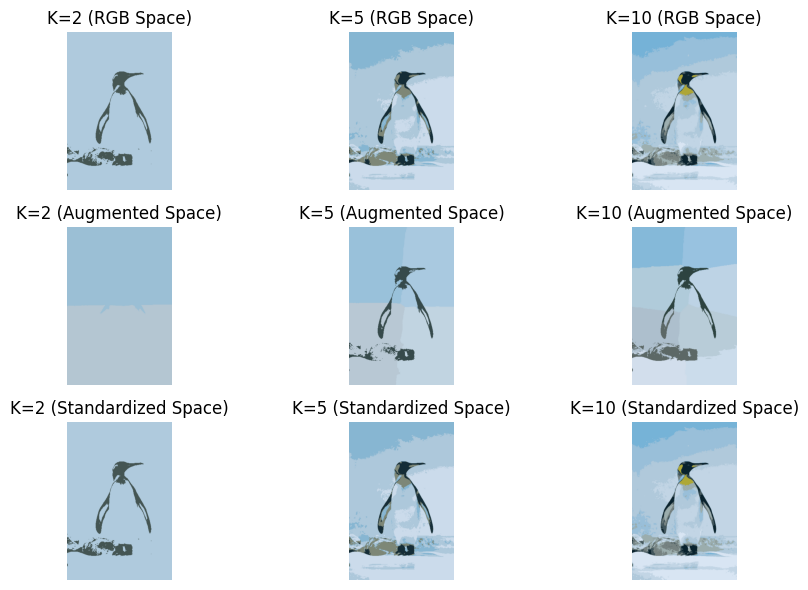

In [2]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score

# Load the image path
image = cv2.imread('/content/penguin.jpeg')

resized_image = cv2.resize(image, None, fx=0.25, fy=0.25, interpolation=cv2.INTER_AREA)

# Convert BGR image to RGB
image_rgb = cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB)

# Reshaping K-Means clustering
height, width, channels = image_rgb.shape
image_data = image_rgb.reshape((height * width, channels))

# K-Means clustering in the RGB space
k_values = [2, 5, 10]
clustered_images_rgb = []
for k in k_values:
    kmeans_rgb = KMeans(n_clusters=k, n_init=10, random_state=0)
    kmeans_rgb.fit(image_data)
    clustered_image_rgb = kmeans_rgb.cluster_centers_[kmeans_rgb.labels_].reshape((height, width, channels))
    clustered_images_rgb.append(clustered_image_rgb)

# Augment RGB channels (with x-y coordinates as needed)
xy_coordinates = np.column_stack((np.repeat(np.arange(height), width), np.tile(np.arange(width), height)))
image_data_augmented = np.concatenate((image_data, xy_coordinates), axis=1)

# K-Means clustering in augmented space
clustered_images_augmented = []
for k in k_values:
    kmeans_augmented = KMeans(n_clusters=k, n_init=10, random_state=0)
    kmeans_augmented.fit(image_data_augmented)
    rgb_values = kmeans_augmented.cluster_centers_[:, :3]
    clustered_image_augmented = rgb_values[kmeans_augmented.labels_].reshape((height, width, channels))
    clustered_images_augmented.append(clustered_image_augmented)

# Standardization of RGB
scaler = StandardScaler()
image_data_std = scaler.fit_transform(image_data)

# K-Means clustering on standardized data
clustered_images_std = []
for k in k_values:
    kmeans_std = KMeans(n_clusters=k, n_init=10, random_state=0)
    kmeans_std.fit(image_data_std)
    # Inverse transform
    rgb_values_std = scaler.inverse_transform(kmeans_std.cluster_centers_)[:, :3]
    clustered_image_std = rgb_values_std[kmeans_std.labels_].reshape((height, width, channels))
    clustered_images_std.append(clustered_image_std)

# Calculate evaluation metrics
silhouette_scores_rgb = []
calinski_harabasz_scores_rgb = []
davies_bouldin_scores_rgb = []

silhouette_scores_augmented = []
calinski_harabasz_scores_augmented = []
davies_bouldin_scores_augmented = []

silhouette_scores_std = []
calinski_harabasz_scores_std = []
davies_bouldin_scores_std = []

for k in k_values:
    #  RGB space metrics
    silhouette_rgb = silhouette_score(image_data, kmeans_rgb.labels_)
    calinski_harabasz_rgb = calinski_harabasz_score(image_data, kmeans_rgb.labels_)
    davies_bouldin_rgb = davies_bouldin_score(image_data, kmeans_rgb.labels_)

    silhouette_scores_rgb.append(silhouette_rgb)
    calinski_harabasz_scores_rgb.append(calinski_harabasz_rgb)
    davies_bouldin_scores_rgb.append(davies_bouldin_rgb)

    # Augmented space metrics
    silhouette_augmented = silhouette_score(image_data_augmented, kmeans_augmented.labels_)
    calinski_harabasz_augmented = calinski_harabasz_score(image_data_augmented, kmeans_augmented.labels_)
    davies_bouldin_augmented = davies_bouldin_score(image_data_augmented, kmeans_augmented.labels_)

    silhouette_scores_augmented.append(silhouette_augmented)
    calinski_harabasz_scores_augmented.append(calinski_harabasz_augmented)
    davies_bouldin_scores_augmented.append(davies_bouldin_augmented)

    # Standardized space metrics
    silhouette_std = silhouette_score(image_data_std, kmeans_std.labels_)
    calinski_harabasz_std = calinski_harabasz_score(image_data_std, kmeans_std.labels_)
    davies_bouldin_std = davies_bouldin_score(image_data_std, kmeans_std.labels_)

    silhouette_scores_std.append(silhouette_std)
    calinski_harabasz_scores_std.append(calinski_harabasz_std)
    davies_bouldin_scores_std.append(davies_bouldin_std)

# Results
plt.figure(figsize=(10, 6))

for i, k in enumerate(k_values):
    plt.subplot(3, 3, i + 1)
    plt.title(f'K={k} (RGB Space)')
    plt.imshow(clustered_images_rgb[i].astype(np.uint8))
    plt.axis('off')

for i, k in enumerate(k_values):
    plt.subplot(3, 3, i + 4)
    plt.title(f'K={k} (Augmented Space)')
    plt.imshow(clustered_images_augmented[i].astype(np.uint8))
    plt.axis('off')

for i, k in enumerate(k_values):
    plt.subplot(3, 3, i + 7)
    plt.title(f'K={k} (Standardized Space)')
    plt.imshow(clustered_images_std[i].astype(np.uint8))
    plt.axis('off')

plt.tight_layout()
plt.show()

# Print or use the evaluation scores as needed
print("RGB Space:")
print("Silhouette Scores:", silhouette_scores_rgb)
print("Calinski-Harabasz Scores:", calinski_harabasz_scores_rgb)
print("Davies-Bouldin Scores:", davies_bouldin_scores_rgb)

print("Augmented Space:")
print("Silhouette Scores:", silhouette_scores_augmented)
print("Calinski-Harabasz Scores:", calinski_harabasz_scores_augmented)
print("Davies-Bouldin Scores:", davies_bouldin_scores_augmented)

print("Standardized Space:")
print("Silhouette Scores:", silhouette_scores_std)
print("Calinski-Harabasz Scores:", calinski_harabasz_scores_std)
print("Davies-Bouldin Scores:", davies_bouldin_scores_std)


In [5]:
print("RGB Space")
print("Silhouette Scores:", silhouette_scores_rgb)
print("Calinski-Harabasz Scores:", calinski_harabasz_scores_rgb)
print("Davies-Bouldin Scores:", davies_bouldin_scores_rgb)

print("================================================================================")

print("Augmented Space")
print("Silhouette Scores:", silhouette_scores_augmented)
print("Calinski-Harabasz Scores:", calinski_harabasz_scores_augmented)
print("Davies-Bouldin Scores:", davies_bouldin_scores_augmented)

print("================================================================================")

print("Standardized Space")
print("Silhouette Scores:", silhouette_scores_std)
print("Calinski-Harabasz Scores:", calinski_harabasz_scores_std)
print("Davies-Bouldin Scores:", davies_bouldin_scores_std)


RGB Space
Silhouette Scores: [0.43979295073502855, 0.43979295073502855, 0.43979295073502855]
Calinski-Harabasz Scores: [289391.30279629526, 289391.30279629526, 289391.30279629526]
Davies-Bouldin Scores: [0.7371895869946073, 0.7371895869946073, 0.7371895869946073]
Augmented Space
Silhouette Scores: [0.35421271390616366, 0.35421271390616366, 0.35421271390616366]
Calinski-Harabasz Scores: [95445.41645399261, 95445.41645399261, 95445.41645399261]
Davies-Bouldin Scores: [0.9191341937430387, 0.9191341937430387, 0.9191341937430387]
Standardized Space
Silhouette Scores: [0.43863080593653064, 0.43863080593653064, 0.43863080593653064]
Calinski-Harabasz Scores: [296493.80199052143, 296493.80199052143, 296493.80199052143]
Davies-Bouldin Scores: [0.7401657347280082, 0.7401657347280082, 0.7401657347280082]


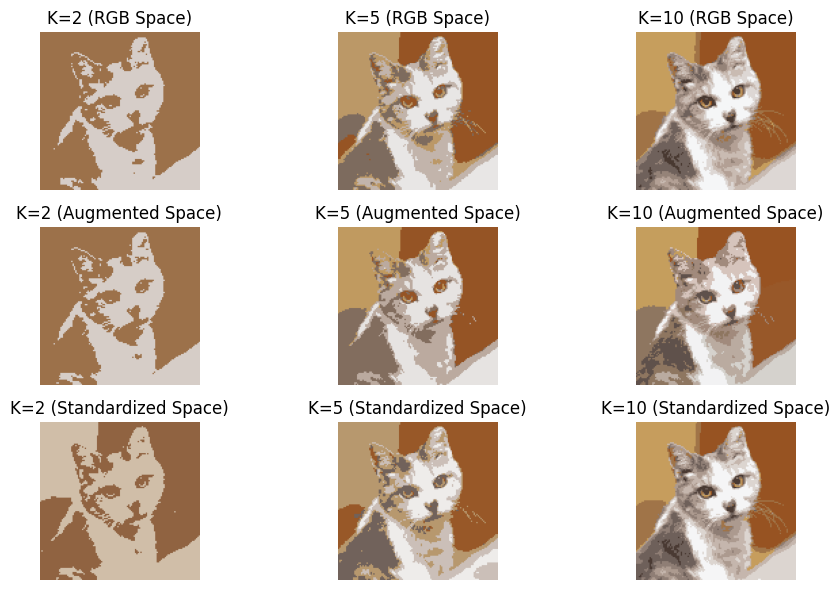

In [7]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score

# Load the image path
image = cv2.imread('/content/cat.jpeg')

resized_image = cv2.resize(image, None, fx=0.25, fy=0.25, interpolation=cv2.INTER_AREA)

# Convert BGR image to RGB
image_rgb = cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB)

# Reshaping K-Means clustering
height, width, channels = image_rgb.shape
image_data = image_rgb.reshape((height * width, channels))

# K-Means clustering in the RGB space
k_values = [2, 5, 10]
clustered_images_rgb = []
for k in k_values:
    kmeans_rgb = KMeans(n_clusters=k, n_init=10, random_state=0)
    kmeans_rgb.fit(image_data)
    clustered_image_rgb = kmeans_rgb.cluster_centers_[kmeans_rgb.labels_].reshape((height, width, channels))
    clustered_images_rgb.append(clustered_image_rgb)

# Augment RGB channels (with x-y coordinates as needed)
xy_coordinates = np.column_stack((np.repeat(np.arange(height), width), np.tile(np.arange(width), height)))
image_data_augmented = np.concatenate((image_data, xy_coordinates), axis=1)

# K-Means clustering in augmented space
clustered_images_augmented = []
for k in k_values:
    kmeans_augmented = KMeans(n_clusters=k, n_init=10, random_state=0)
    kmeans_augmented.fit(image_data_augmented)
    rgb_values = kmeans_augmented.cluster_centers_[:, :3]
    clustered_image_augmented = rgb_values[kmeans_augmented.labels_].reshape((height, width, channels))
    clustered_images_augmented.append(clustered_image_augmented)

# Standardization of RGB
scaler = StandardScaler()
image_data_std = scaler.fit_transform(image_data)

# K-Means clustering on standardized data
clustered_images_std = []
for k in k_values:
    kmeans_std = KMeans(n_clusters=k, n_init=10, random_state=0)
    kmeans_std.fit(image_data_std)
    # Inverse transform
    rgb_values_std = scaler.inverse_transform(kmeans_std.cluster_centers_)[:, :3]
    clustered_image_std = rgb_values_std[kmeans_std.labels_].reshape((height, width, channels))
    clustered_images_std.append(clustered_image_std)

# Calculate evaluation metrics
silhouette_scores_rgb = []
calinski_harabasz_scores_rgb = []
davies_bouldin_scores_rgb = []

silhouette_scores_augmented = []
calinski_harabasz_scores_augmented = []
davies_bouldin_scores_augmented = []

silhouette_scores_std = []
calinski_harabasz_scores_std = []
davies_bouldin_scores_std = []

for k in k_values:
    #  RGB space metrics
    silhouette_rgb = silhouette_score(image_data, kmeans_rgb.labels_)
    calinski_harabasz_rgb = calinski_harabasz_score(image_data, kmeans_rgb.labels_)
    davies_bouldin_rgb = davies_bouldin_score(image_data, kmeans_rgb.labels_)

    silhouette_scores_rgb.append(silhouette_rgb)
    calinski_harabasz_scores_rgb.append(calinski_harabasz_rgb)
    davies_bouldin_scores_rgb.append(davies_bouldin_rgb)

    # Augmented space metrics
    silhouette_augmented = silhouette_score(image_data_augmented, kmeans_augmented.labels_)
    calinski_harabasz_augmented = calinski_harabasz_score(image_data_augmented, kmeans_augmented.labels_)
    davies_bouldin_augmented = davies_bouldin_score(image_data_augmented, kmeans_augmented.labels_)

    silhouette_scores_augmented.append(silhouette_augmented)
    calinski_harabasz_scores_augmented.append(calinski_harabasz_augmented)
    davies_bouldin_scores_augmented.append(davies_bouldin_augmented)

    # Standardized space metrics
    silhouette_std = silhouette_score(image_data_std, kmeans_std.labels_)
    calinski_harabasz_std = calinski_harabasz_score(image_data_std, kmeans_std.labels_)
    davies_bouldin_std = davies_bouldin_score(image_data_std, kmeans_std.labels_)

    silhouette_scores_std.append(silhouette_std)
    calinski_harabasz_scores_std.append(calinski_harabasz_std)
    davies_bouldin_scores_std.append(davies_bouldin_std)

# Results
plt.figure(figsize=(10, 6))

for i, k in enumerate(k_values):
    plt.subplot(3, 3, i + 1)
    plt.title(f'K={k} (RGB Space)')
    plt.imshow(clustered_images_rgb[i].astype(np.uint8))
    plt.axis('off')

for i, k in enumerate(k_values):
    plt.subplot(3, 3, i + 4)
    plt.title(f'K={k} (Augmented Space)')
    plt.imshow(clustered_images_augmented[i].astype(np.uint8))
    plt.axis('off')

for i, k in enumerate(k_values):
    plt.subplot(3, 3, i + 7)
    plt.title(f'K={k} (Standardized Space)')
    plt.imshow(clustered_images_std[i].astype(np.uint8))
    plt.axis('off')

plt.tight_layout()
plt.show()



In [8]:
print("RGB Space")
print("Silhouette Scores:", silhouette_scores_rgb)
print("Calinski-Harabasz Scores:", calinski_harabasz_scores_rgb)
print("Davies-Bouldin Scores:", davies_bouldin_scores_rgb)

print("================================================================================")

print("Augmented Space")
print("Silhouette Scores:", silhouette_scores_augmented)
print("Calinski-Harabasz Scores:", calinski_harabasz_scores_augmented)
print("Davies-Bouldin Scores:", davies_bouldin_scores_augmented)

print("================================================================================")

print("Standardized Space")
print("Silhouette Scores:", silhouette_scores_std)
print("Calinski-Harabasz Scores:", calinski_harabasz_scores_std)
print("Davies-Bouldin Scores:", davies_bouldin_scores_std)


RGB Space
Silhouette Scores: [0.5574529433752426, 0.5574529433752426, 0.5574529433752426]
Calinski-Harabasz Scores: [49841.150100006824, 49841.150100006824, 49841.150100006824]
Davies-Bouldin Scores: [0.6631209963657778, 0.6631209963657778, 0.6631209963657778]
Augmented Space
Silhouette Scores: [0.3706796134077635, 0.3706796134077635, 0.3706796134077635]
Calinski-Harabasz Scores: [13192.103767179155, 13192.103767179155, 13192.103767179155]
Davies-Bouldin Scores: [1.0451732417817996, 1.0451732417817996, 1.0451732417817996]
Standardized Space
Silhouette Scores: [0.5325740858767946, 0.5325740858767946, 0.5325740858767946]
Calinski-Harabasz Scores: [40334.26430455524, 40334.26430455524, 40334.26430455524]
Davies-Bouldin Scores: [0.714016718578176, 0.714016718578176, 0.714016718578176]


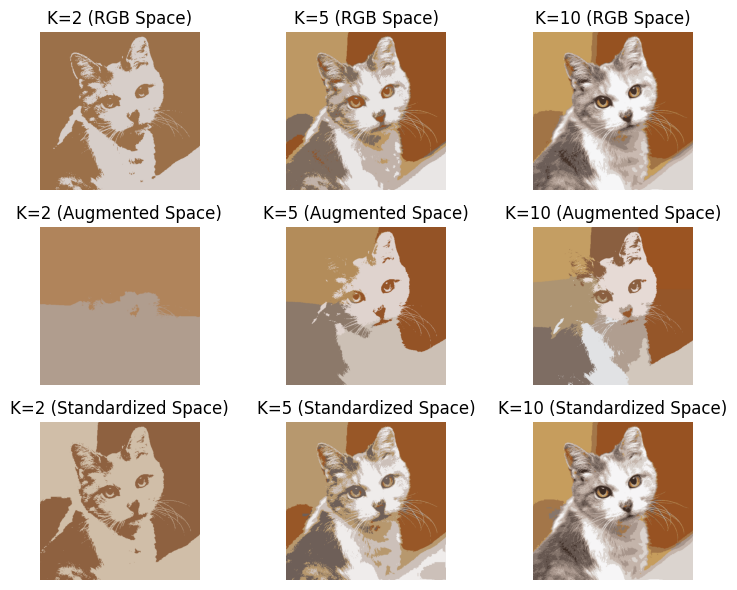

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

# Load the image path
image = cv2.imread('/content/cat.jpeg')

# Convert BGR image to RGB
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Reshaping K-Means clustering
height, width, channels = image_rgb.shape
image_data = image_rgb.reshape((height * width, channels))

# K-Means clustering in the RGB space
k_values = [2, 5, 10]
clustered_images_rgb = []
for k in k_values:
    kmeans_rgb = KMeans(n_clusters=k, n_init=10, random_state=0)
    kmeans_rgb.fit(image_data)
    clustered_image_rgb = kmeans_rgb.cluster_centers_[kmeans_rgb.labels_].reshape((height, width, channels))
    clustered_images_rgb.append(clustered_image_rgb)

# Augment RGB channels (with x-y coordinates as needed)
xy_coordinates = np.column_stack((np.repeat(np.arange(height), width), np.tile(np.arange(width), height)))
image_data_augmented = np.concatenate((image_data, xy_coordinates), axis=1)

# K-Means clustering in augmented space
clustered_images_augmented = []
for k in k_values:
    kmeans_augmented = KMeans(n_clusters=k, n_init=10, random_state=0)
    kmeans_augmented.fit(image_data_augmented)
    rgb_values = kmeans_augmented.cluster_centers_[:, :3]
    clustered_image_augmented = rgb_values[kmeans_augmented.labels_].reshape((height, width, channels))
    clustered_images_augmented.append(clustered_image_augmented)

# Standardization of RGB
scaler = StandardScaler()
image_data_std = scaler.fit_transform(image_data)

# K-Means clustering on standardized data
clustered_images_std = []
for k in k_values:
    kmeans_std = KMeans(n_clusters=k, n_init=10, random_state=0)
    kmeans_std.fit(image_data_std)
    # Inverse transform to get back to the original feature space
    rgb_values_std = scaler.inverse_transform(kmeans_std.cluster_centers_)[:, :3]
    clustered_image_std = rgb_values_std[kmeans_std.labels_].reshape((height, width, channels))
    clustered_images_std.append(clustered_image_std)

# Results
plt.figure(figsize=(8, 6))  # Adjust the figure size here

for i, k in enumerate(k_values):
    plt.subplot(3, 3, i + 1)
    plt.title(f'K={k} (RGB Space)')
    plt.imshow(clustered_images_rgb[i].astype(np.uint8))
    plt.axis('off')

for i, k in enumerate(k_values):
    plt.subplot(3, 3, i + 4)
    plt.title(f'K={k} (Augmented Space)')
    plt.imshow(clustered_images_augmented[i].astype(np.uint8))
    plt.axis('off')

for i, k in enumerate(k_values):
    plt.subplot(3, 3, i + 7)
    plt.title(f'K={k} (Standardized Space)')
    plt.imshow(clustered_images_std[i].astype(np.uint8))
    plt.axis('off')

plt.tight_layout()
plt.show()


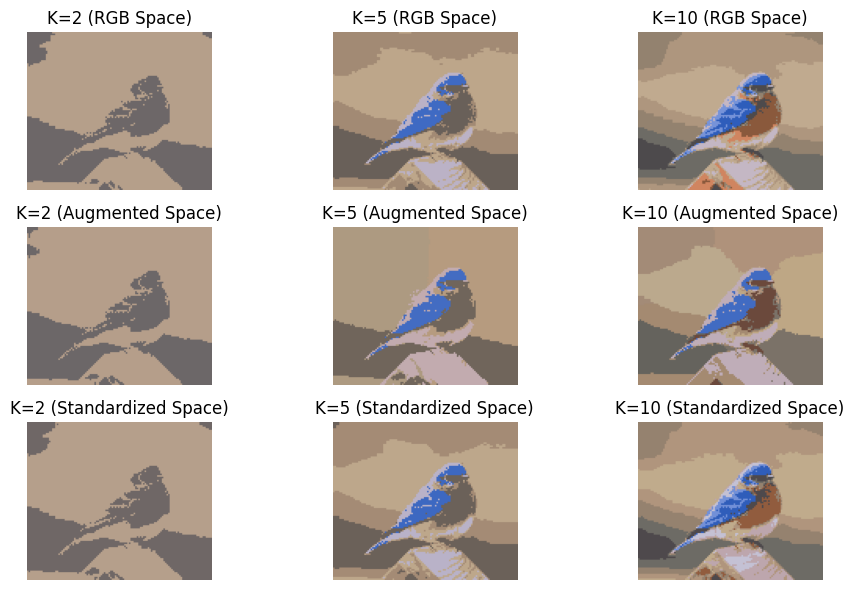

In [9]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score

# Load the image path
image = cv2.imread('/content/bird.jpeg')

resized_image = cv2.resize(image, None, fx=0.25, fy=0.25, interpolation=cv2.INTER_AREA)

# Convert BGR image to RGB
image_rgb = cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB)

# Reshaping K-Means clustering
height, width, channels = image_rgb.shape
image_data = image_rgb.reshape((height * width, channels))

# K-Means clustering in the RGB space
k_values = [2, 5, 10]
clustered_images_rgb = []
for k in k_values:
    kmeans_rgb = KMeans(n_clusters=k, n_init=10, random_state=0)
    kmeans_rgb.fit(image_data)
    clustered_image_rgb = kmeans_rgb.cluster_centers_[kmeans_rgb.labels_].reshape((height, width, channels))
    clustered_images_rgb.append(clustered_image_rgb)

# Augment RGB channels (with x-y coordinates as needed)
xy_coordinates = np.column_stack((np.repeat(np.arange(height), width), np.tile(np.arange(width), height)))
image_data_augmented = np.concatenate((image_data, xy_coordinates), axis=1)

# K-Means clustering in augmented space
clustered_images_augmented = []
for k in k_values:
    kmeans_augmented = KMeans(n_clusters=k, n_init=10, random_state=0)
    kmeans_augmented.fit(image_data_augmented)
    rgb_values = kmeans_augmented.cluster_centers_[:, :3]
    clustered_image_augmented = rgb_values[kmeans_augmented.labels_].reshape((height, width, channels))
    clustered_images_augmented.append(clustered_image_augmented)

# Standardization of RGB
scaler = StandardScaler()
image_data_std = scaler.fit_transform(image_data)

# K-Means clustering on standardized data
clustered_images_std = []
for k in k_values:
    kmeans_std = KMeans(n_clusters=k, n_init=10, random_state=0)
    kmeans_std.fit(image_data_std)
    # Inverse transform
    rgb_values_std = scaler.inverse_transform(kmeans_std.cluster_centers_)[:, :3]
    clustered_image_std = rgb_values_std[kmeans_std.labels_].reshape((height, width, channels))
    clustered_images_std.append(clustered_image_std)

# Calculate evaluation metrics
silhouette_scores_rgb = []
calinski_harabasz_scores_rgb = []
davies_bouldin_scores_rgb = []

silhouette_scores_augmented = []
calinski_harabasz_scores_augmented = []
davies_bouldin_scores_augmented = []

silhouette_scores_std = []
calinski_harabasz_scores_std = []
davies_bouldin_scores_std = []

for k in k_values:
    #  RGB space metrics
    silhouette_rgb = silhouette_score(image_data, kmeans_rgb.labels_)
    calinski_harabasz_rgb = calinski_harabasz_score(image_data, kmeans_rgb.labels_)
    davies_bouldin_rgb = davies_bouldin_score(image_data, kmeans_rgb.labels_)

    silhouette_scores_rgb.append(silhouette_rgb)
    calinski_harabasz_scores_rgb.append(calinski_harabasz_rgb)
    davies_bouldin_scores_rgb.append(davies_bouldin_rgb)

    # Augmented space metrics
    silhouette_augmented = silhouette_score(image_data_augmented, kmeans_augmented.labels_)
    calinski_harabasz_augmented = calinski_harabasz_score(image_data_augmented, kmeans_augmented.labels_)
    davies_bouldin_augmented = davies_bouldin_score(image_data_augmented, kmeans_augmented.labels_)

    silhouette_scores_augmented.append(silhouette_augmented)
    calinski_harabasz_scores_augmented.append(calinski_harabasz_augmented)
    davies_bouldin_scores_augmented.append(davies_bouldin_augmented)

    # Standardized space metrics
    silhouette_std = silhouette_score(image_data_std, kmeans_std.labels_)
    calinski_harabasz_std = calinski_harabasz_score(image_data_std, kmeans_std.labels_)
    davies_bouldin_std = davies_bouldin_score(image_data_std, kmeans_std.labels_)

    silhouette_scores_std.append(silhouette_std)
    calinski_harabasz_scores_std.append(calinski_harabasz_std)
    davies_bouldin_scores_std.append(davies_bouldin_std)

# Results
plt.figure(figsize=(10, 6))

for i, k in enumerate(k_values):
    plt.subplot(3, 3, i + 1)
    plt.title(f'K={k} (RGB Space)')
    plt.imshow(clustered_images_rgb[i].astype(np.uint8))
    plt.axis('off')

for i, k in enumerate(k_values):
    plt.subplot(3, 3, i + 4)
    plt.title(f'K={k} (Augmented Space)')
    plt.imshow(clustered_images_augmented[i].astype(np.uint8))
    plt.axis('off')

for i, k in enumerate(k_values):
    plt.subplot(3, 3, i + 7)
    plt.title(f'K={k} (Standardized Space)')
    plt.imshow(clustered_images_std[i].astype(np.uint8))
    plt.axis('off')

plt.tight_layout()
plt.show()



In [10]:
# Print or use the evaluation scores as needed
print("RGB Space")
print("Silhouette Scores:", silhouette_scores_rgb)
print("Calinski-Harabasz Scores:", calinski_harabasz_scores_rgb)
print("Davies-Bouldin Scores:", davies_bouldin_scores_rgb)

print("================================================================================")

print("Augmented Space")
print("Silhouette Scores:", silhouette_scores_augmented)
print("Calinski-Harabasz Scores:", calinski_harabasz_scores_augmented)
print("Davies-Bouldin Scores:", davies_bouldin_scores_augmented)

print("================================================================================")

print("Standardized Space")
print("Silhouette Scores:", silhouette_scores_std)
print("Calinski-Harabasz Scores:", calinski_harabasz_scores_std)
print("Davies-Bouldin Scores:", davies_bouldin_scores_std)


RGB Space
Silhouette Scores: [0.43049427244545924, 0.43049427244545924, 0.43049427244545924]
Calinski-Harabasz Scores: [11722.29220372234, 11722.29220372234, 11722.29220372234]
Davies-Bouldin Scores: [0.7360517191242992, 0.7360517191242992, 0.7360517191242992]
Augmented Space
Silhouette Scores: [0.37258909799906004, 0.37258909799906004, 0.37258909799906004]
Calinski-Harabasz Scores: [5544.728514243718, 5544.728514243718, 5544.728514243718]
Davies-Bouldin Scores: [0.9486032926433616, 0.9486032926433616, 0.9486032926433616]
Standardized Space
Silhouette Scores: [0.41884034662338215, 0.41884034662338215, 0.41884034662338215]
Calinski-Harabasz Scores: [11543.468817976533, 11543.468817976533, 11543.468817976533]
Davies-Bouldin Scores: [0.801630994753635, 0.801630994753635, 0.801630994753635]


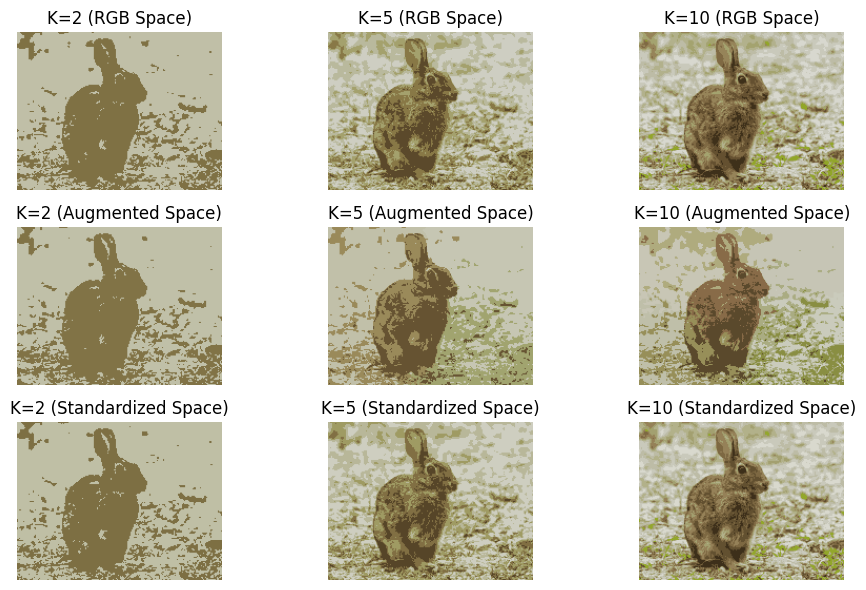

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score

# Load the image path
image = cv2.imread('/content/rabbit.jpg')

resized_image = cv2.resize(image, None, fx=0.25, fy=0.25, interpolation=cv2.INTER_AREA)

# Convert BGR image to RGB
image_rgb = cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB)

# Reshaping K-Means clustering
height, width, channels = image_rgb.shape
image_data = image_rgb.reshape((height * width, channels))

# K-Means clustering in the RGB space
k_values = [2, 5, 10]
clustered_images_rgb = []
for k in k_values:
    kmeans_rgb = KMeans(n_clusters=k, n_init=10, random_state=0)
    kmeans_rgb.fit(image_data)
    clustered_image_rgb = kmeans_rgb.cluster_centers_[kmeans_rgb.labels_].reshape((height, width, channels))
    clustered_images_rgb.append(clustered_image_rgb)

# Augment RGB channels (with x-y coordinates as needed)
xy_coordinates = np.column_stack((np.repeat(np.arange(height), width), np.tile(np.arange(width), height)))
image_data_augmented = np.concatenate((image_data, xy_coordinates), axis=1)

# K-Means clustering in augmented space
clustered_images_augmented = []
for k in k_values:
    kmeans_augmented = KMeans(n_clusters=k, n_init=10, random_state=0)
    kmeans_augmented.fit(image_data_augmented)
    rgb_values = kmeans_augmented.cluster_centers_[:, :3]
    clustered_image_augmented = rgb_values[kmeans_augmented.labels_].reshape((height, width, channels))
    clustered_images_augmented.append(clustered_image_augmented)

# Standardization of RGB
scaler = StandardScaler()
image_data_std = scaler.fit_transform(image_data)

# K-Means clustering on standardized data
clustered_images_std = []
for k in k_values:
    kmeans_std = KMeans(n_clusters=k, n_init=10, random_state=0)
    kmeans_std.fit(image_data_std)
    # Inverse transform
    rgb_values_std = scaler.inverse_transform(kmeans_std.cluster_centers_)[:, :3]
    clustered_image_std = rgb_values_std[kmeans_std.labels_].reshape((height, width, channels))
    clustered_images_std.append(clustered_image_std)

# Calculate evaluation metrics
silhouette_scores_rgb = []
calinski_harabasz_scores_rgb = []
davies_bouldin_scores_rgb = []

silhouette_scores_augmented = []
calinski_harabasz_scores_augmented = []
davies_bouldin_scores_augmented = []

silhouette_scores_std = []
calinski_harabasz_scores_std = []
davies_bouldin_scores_std = []

for k in k_values:
    #  RGB space metrics
    silhouette_rgb = silhouette_score(image_data, kmeans_rgb.labels_)
    calinski_harabasz_rgb = calinski_harabasz_score(image_data, kmeans_rgb.labels_)
    davies_bouldin_rgb = davies_bouldin_score(image_data, kmeans_rgb.labels_)

    silhouette_scores_rgb.append(silhouette_rgb)
    calinski_harabasz_scores_rgb.append(calinski_harabasz_rgb)
    davies_bouldin_scores_rgb.append(davies_bouldin_rgb)

    # Augmented space metrics
    silhouette_augmented = silhouette_score(image_data_augmented, kmeans_augmented.labels_)
    calinski_harabasz_augmented = calinski_harabasz_score(image_data_augmented, kmeans_augmented.labels_)
    davies_bouldin_augmented = davies_bouldin_score(image_data_augmented, kmeans_augmented.labels_)

    silhouette_scores_augmented.append(silhouette_augmented)
    calinski_harabasz_scores_augmented.append(calinski_harabasz_augmented)
    davies_bouldin_scores_augmented.append(davies_bouldin_augmented)

    # Standardized space metrics
    silhouette_std = silhouette_score(image_data_std, kmeans_std.labels_)
    calinski_harabasz_std = calinski_harabasz_score(image_data_std, kmeans_std.labels_)
    davies_bouldin_std = davies_bouldin_score(image_data_std, kmeans_std.labels_)

    silhouette_scores_std.append(silhouette_std)
    calinski_harabasz_scores_std.append(calinski_harabasz_std)
    davies_bouldin_scores_std.append(davies_bouldin_std)

# Results
plt.figure(figsize=(10, 6))

for i, k in enumerate(k_values):
    plt.subplot(3, 3, i + 1)
    plt.title(f'K={k} (RGB Space)')
    plt.imshow(clustered_images_rgb[i].astype(np.uint8))
    plt.axis('off')

for i, k in enumerate(k_values):
    plt.subplot(3, 3, i + 4)
    plt.title(f'K={k} (Augmented Space)')
    plt.imshow(clustered_images_augmented[i].astype(np.uint8))
    plt.axis('off')

for i, k in enumerate(k_values):
    plt.subplot(3, 3, i + 7)
    plt.title(f'K={k} (Standardized Space)')
    plt.imshow(clustered_images_std[i].astype(np.uint8))
    plt.axis('off')

plt.tight_layout()
plt.show()



In [12]:
print("RGB Space")
print("Silhouette Scores:", silhouette_scores_rgb)
print("Calinski-Harabasz Scores:", calinski_harabasz_scores_rgb)
print("Davies-Bouldin Scores:", davies_bouldin_scores_rgb)

print("================================================================================")

print("Augmented Space")
print("Silhouette Scores:", silhouette_scores_augmented)
print("Calinski-Harabasz Scores:", calinski_harabasz_scores_augmented)
print("Davies-Bouldin Scores:", davies_bouldin_scores_augmented)

print("================================================================================")

print("Standardized Space")
print("Silhouette Scores:", silhouette_scores_std)
print("Calinski-Harabasz Scores:", calinski_harabasz_scores_std)
print("Davies-Bouldin Scores:", davies_bouldin_scores_std)


RGB Space
Silhouette Scores: [0.446631530143152, 0.446631530143152, 0.446631530143152]
Calinski-Harabasz Scores: [800720.6924423951, 800720.6924423951, 800720.6924423951]
Davies-Bouldin Scores: [0.7608352460377426, 0.7608352460377426, 0.7608352460377426]
Augmented Space
Silhouette Scores: [0.34022540847727234, 0.34022540847727234, 0.34022540847727234]
Calinski-Harabasz Scores: [210938.63129311995, 210938.63129311995, 210938.63129311995]
Davies-Bouldin Scores: [0.9752251161578751, 0.9752251161578751, 0.9752251161578751]
Standardized Space
Silhouette Scores: [0.43061610258594224, 0.43061610258594224, 0.43061610258594224]
Calinski-Harabasz Scores: [717843.7028813456, 717843.7028813456, 717843.7028813456]
Davies-Bouldin Scores: [0.7920712110964295, 0.7920712110964295, 0.7920712110964295]


**Quality of the clustered images**

In the RGB space, increasing the number of clusters leads to more defined segmentation, capturing more details in the images,leads to best result.

In Augmented Space, the location of each color dot (pixel) was also used, the image didn't really show clear objects, just different colors grouped together. This method made the colors blend in unusual ways, and it was hard to see the animals , especially when using more color groups.


The  standardization in K-Means clustering  show that as the number of clusters increases, the segmentation of the image also becomes more defined.. However, the results shown was near form the rgb space.

**Qualitative assessment**

1. Silhouette Score: The aim of the Silhouette Score is to determine how well each data point fits into its assigned cluster. It achieves this by comparing the closeness of each point to other points in its own cluster versus points in the nearest different cluster. The goal is to find if the clusters are distinct and well-separated, with points well-suited to their clusters.



2. Calinski-Harabasz Score: This metric aims to measure the quality of a clustering by looking at two things: how compact the clusters are (that is, how close the points in each cluster are to each other), and how well-separated the clusters are from each other (meaning, how far apart different clusters are). A higher score means the clusters are dense and distinct, which is generally a sign of good clustering.



3. Davies-Bouldin Score: The Davies-Bouldin Score's purpose is to evaluate the clustering by examining how compact and separated the clusters are, similar to the Calinski-Harabasz Score. However, it specifically focuses on the ratio of the sum of within-cluster distances to between-cluster distances. A lower score is desirable, indicating that clusters are both small (tight) and far apart from each other, suggesting effective clustering.



In Silhouette Score, the images received high scores, indicating good quality, while in Calinski-Harabasz, they received slightly lower scores, suggesting need for improvement.Davies-Bouldin method produced results near to the first one, in terms of these score metrics. This demonstrates how the choice of method can impact the quality of the generated animal images.



---



***DBSCAN***

In  DBSCAN clustering analysis for image segmentation, the performance evaluated  under different conditions and hypermeters, including RGB Space, Augmented Space, and Standardized Space.

**RGB Space**

Trying eps=3, min_samples=5
RGB Space
Silhouette Score (eps=3, min_samples=5): -0.36966940678131976
Calinski-Harabasz Score (eps=3, min_samples=5): 279.5370175157784
Davies-Bouldin Score (eps=3, min_samples=5): 2.443084320976193


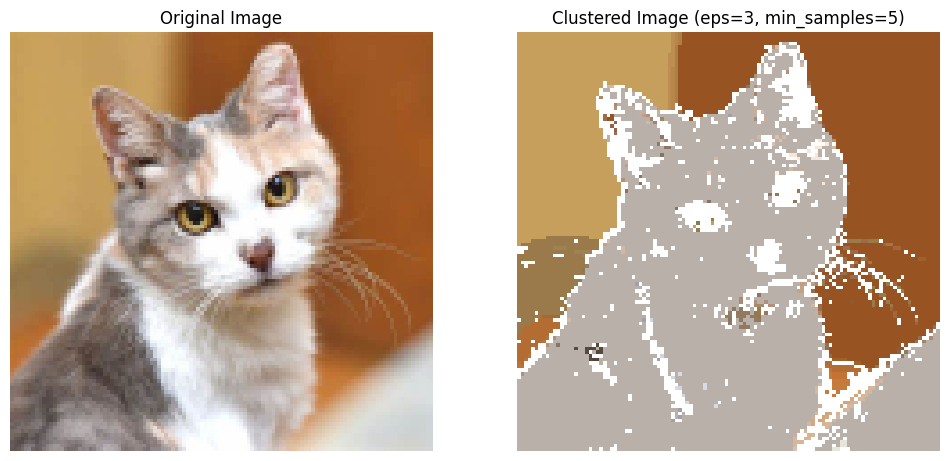

Trying eps=3, min_samples=10
RGB Space
Silhouette Score (eps=3, min_samples=10): -0.30979628685115057
Calinski-Harabasz Score (eps=3, min_samples=10): 338.0602438406728
Davies-Bouldin Score (eps=3, min_samples=10): 1.9908039531400639


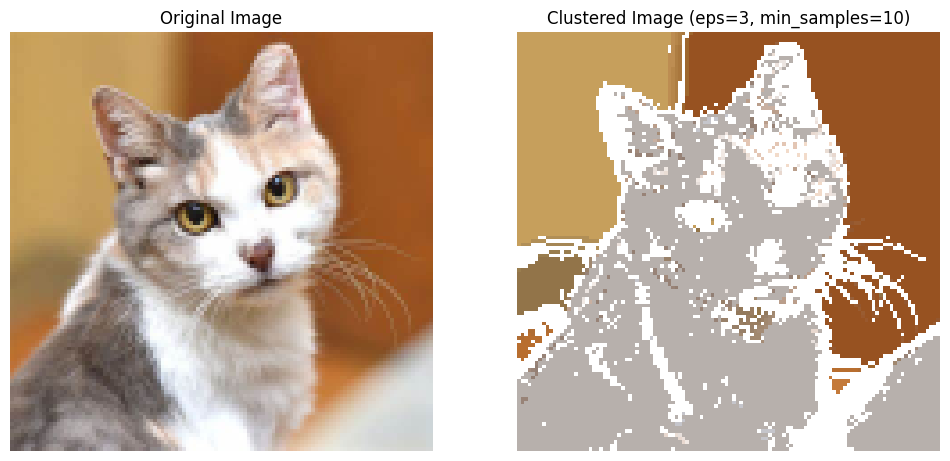

Trying eps=3, min_samples=15
RGB Space
Silhouette Score (eps=3, min_samples=15): -0.08969071217129504
Calinski-Harabasz Score (eps=3, min_samples=15): 1751.1430459738535
Davies-Bouldin Score (eps=3, min_samples=15): 2.6560880570361327


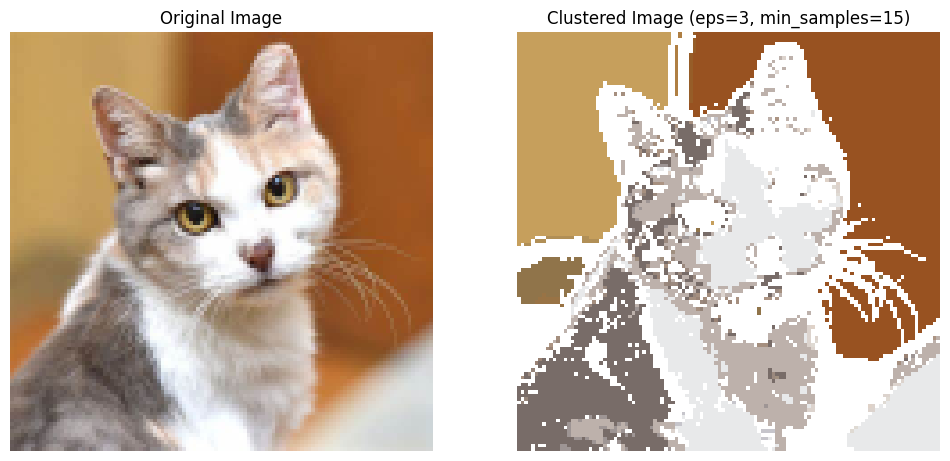

Trying eps=5, min_samples=5
RGB Space
Silhouette Score (eps=5, min_samples=5): -0.4293456378452863
Calinski-Harabasz Score (eps=5, min_samples=5): 28.727475391106715
Davies-Bouldin Score (eps=5, min_samples=5): 2.530166719786752


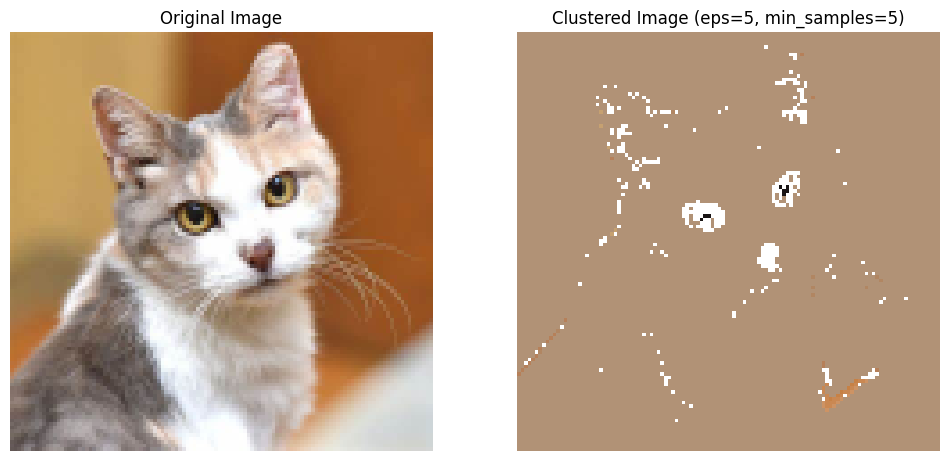

Trying eps=5, min_samples=10
RGB Space
Silhouette Score (eps=5, min_samples=10): -0.47072022547922754
Calinski-Harabasz Score (eps=5, min_samples=10): 31.254749328628925
Davies-Bouldin Score (eps=5, min_samples=10): 3.3296491184297357


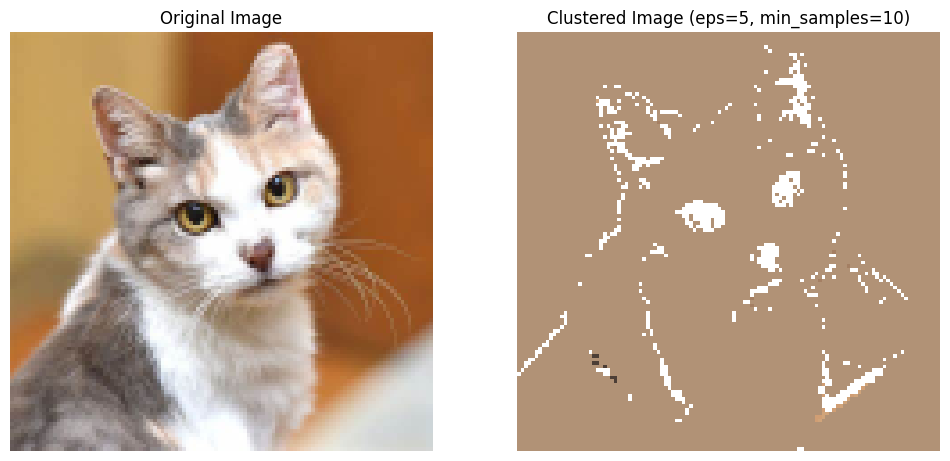

Trying eps=5, min_samples=15
RGB Space
Silhouette Score (eps=5, min_samples=15): -0.24136076685396493
Calinski-Harabasz Score (eps=5, min_samples=15): 1686.5372765551654
Davies-Bouldin Score (eps=5, min_samples=15): 2.302675518272552


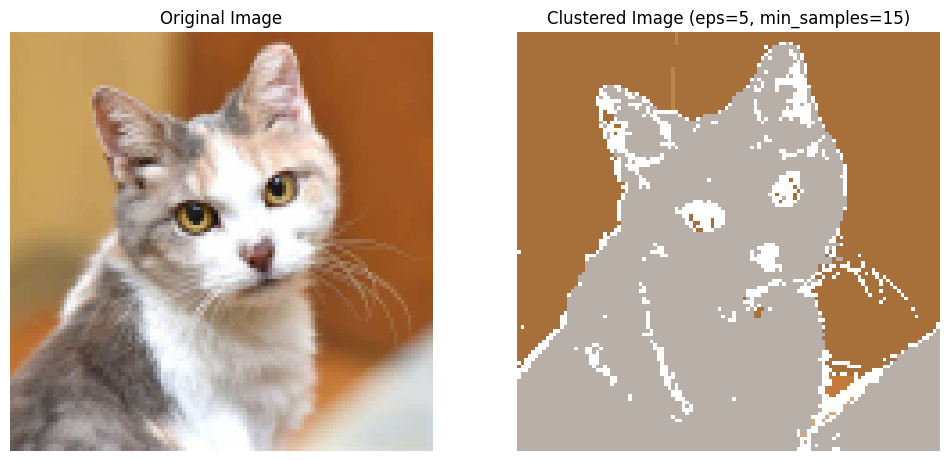

Trying eps=7, min_samples=5
RGB Space
Silhouette Score (eps=7, min_samples=5): 0.15151028627434093
Calinski-Harabasz Score (eps=7, min_samples=5): 83.2933343371245
Davies-Bouldin Score (eps=7, min_samples=5): 1.035314239268257


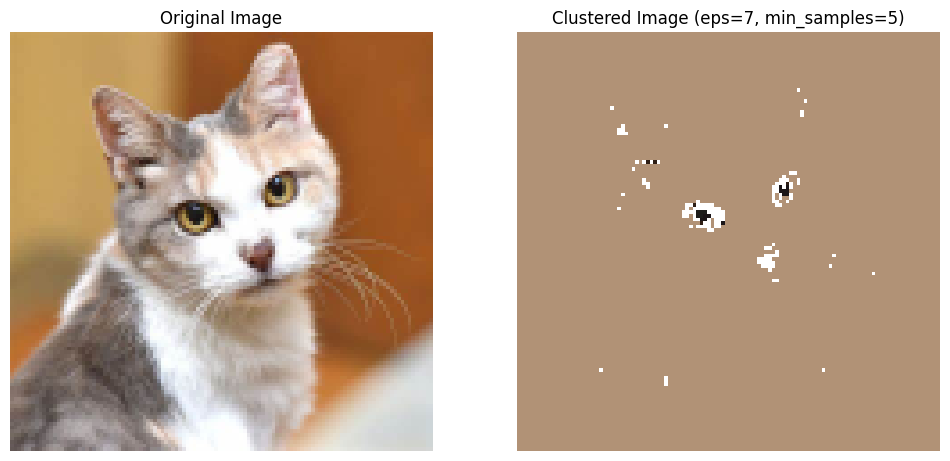

Trying eps=7, min_samples=10
RGB Space
Silhouette Score (eps=7, min_samples=10): -0.24558836911727921
Calinski-Harabasz Score (eps=7, min_samples=10): 100.54797554065154
Davies-Bouldin Score (eps=7, min_samples=10): 1.5822159890586156


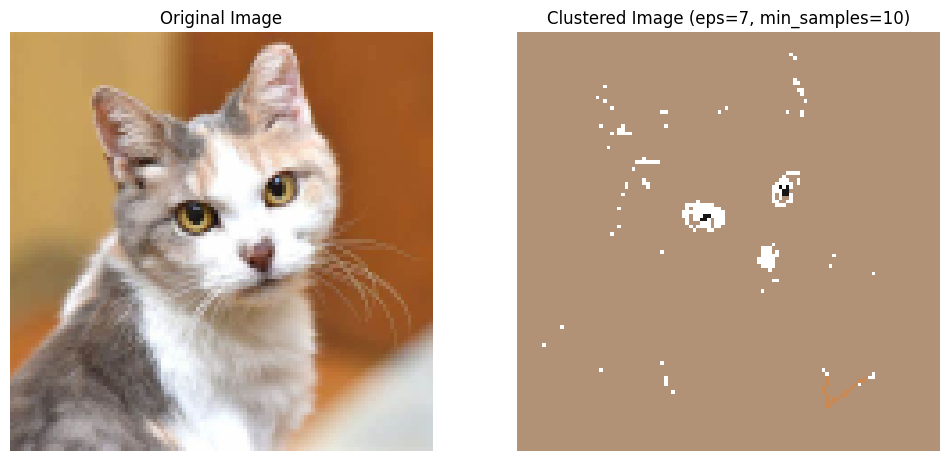

Trying eps=7, min_samples=15
RGB Space
Silhouette Score (eps=7, min_samples=15): None
Calinski-Harabasz Score (eps=7, min_samples=15): None
Davies-Bouldin Score (eps=7, min_samples=15): None


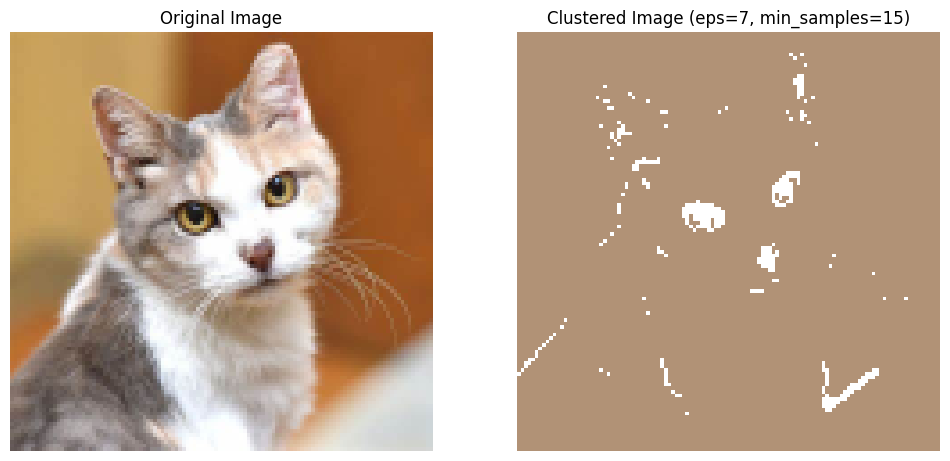

In [ ]:
import cv2
import numpy as np
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
import matplotlib.pyplot as plt

def dbscan_on_image_rgb(image, eps, min_samples):
    # Convert BGR to RGB
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Reshape the image to a 2D array of pixels and 3 color values (RGB)
    pixels = image_rgb.reshape((-1, 3))

    # DBSCAN clustering
    dbscan = DBSCAN(eps=eps, min_samples=min_samples).fit(pixels)

    # Get labels for each pixel
    labels = dbscan.labels_
    unique_labels = set(labels)
    unique_labels.discard(-1)
    n_clusters = len(unique_labels)

    # Initialize sum of colors for each cluster and pixel counts
    cluster_sums = np.zeros((n_clusters, 3), np.float64)
    cluster_counts = np.zeros(n_clusters, np.float64)

    # Sum up the pixel colors for each cluster
    for pixel, label in zip(pixels, labels):
        if label != -1:  # Ignore noise points
            cluster_sums[label] += pixel
            cluster_counts[label] += 1

    # Calculate the average color of each cluster
    for i in range(n_clusters):
        if cluster_counts[i] > 0:
            cluster_sums[i] /= cluster_counts[i]

    # Assign the average color to each pixel in the cluster
    clustered_pixels = np.zeros_like(pixels)
    for i, label in enumerate(labels):
        if label != -1:
            clustered_pixels[i] = cluster_sums[label]
        else:
            clustered_pixels[i] = [255, 255, 255]

    # Reshape to the original image shape
    clustered_image = clustered_pixels.reshape(image_rgb.shape)

    return clustered_image, labels, n_clusters

# Path to the image file
image_path = '/content/cat.jpeg'
original_image = cv2.imread(image_path)

if original_image is None:
    print(f"Image not found at {image_path}")
else:
    # Resize the image more if necessary
    resized_image = cv2.resize(original_image, (0, 0), fx=0.25, fy=0.25, interpolation=cv2.INTER_AREA)
    pixels = resized_image.reshape((-1, 3))
    # Define the hyperparameters for DBSCAN
    eps_values = [3, 5, 7]
    min_samples_values = [5, 10, 15]

    # Apply DBSCAN with different hyperparameters
    for eps_val in eps_values:
        for min_samples_val in min_samples_values:
            print(f"Trying eps={eps_val}, min_samples={min_samples_val}")
            clustered_image, labels, n_clusters = dbscan_on_image_rgb(resized_image, eps_val, min_samples_val)

            # Only compute the metrics if there are clusters found
            if n_clusters > 1:
                silhouette_score_val = silhouette_score(pixels, labels)
                calinski_harabasz_score_val = calinski_harabasz_score(pixels, labels)
                davies_bouldin_score_val = davies_bouldin_score(pixels, labels)
            else:
                silhouette_score_val = None
                calinski_harabasz_score_val = None
                davies_bouldin_score_val = None

            # Print the evaluation scores
            print("================================================================================")
            print("RGB Space")
            print(f"Silhouette Score (eps={eps_val}, min_samples={min_samples_val}):", silhouette_score_val)
            print(f"Calinski-Harabasz Score (eps={eps_val}, min_samples={min_samples_val}):", calinski_harabasz_score_val)
            print(f"Davies-Bouldin Score (eps={eps_val}, min_samples={min_samples_val}):", davies_bouldin_score_val)
            print("================================================================================")

            # Display the original and clustered images
            plt.figure(figsize=(12, 6))
            plt.subplot(121), plt.imshow(cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB))
            plt.title('Original Image'), plt.axis('off')
            plt.subplot(122), plt.imshow(clustered_image)
            plt.title(f'Clustered Image (eps={eps_val}, min_samples={min_samples_val})'), plt.axis('off')
            plt.show()


Trying eps=3, min_samples=5
RGB Space
Silhouette Score (eps=3, min_samples=5): -0.6027223013327195
Calinski-Harabasz Score (eps=3, min_samples=5): 49.743516229688126
Davies-Bouldin Score (eps=3, min_samples=5): 1.439692971344875


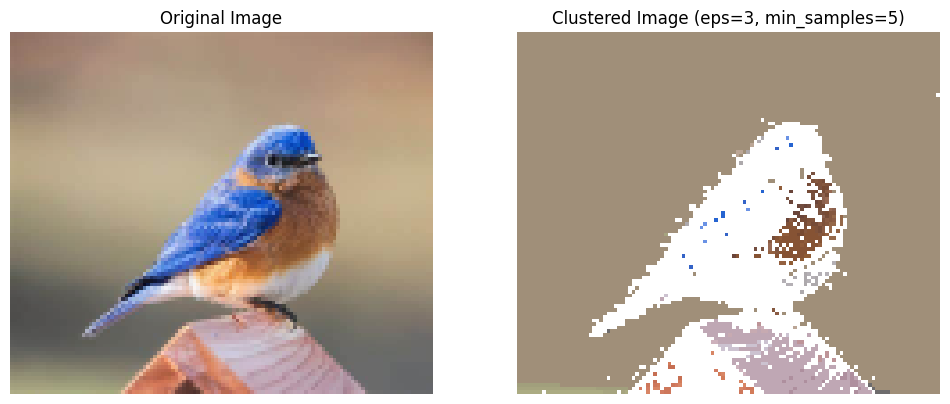

Trying eps=3, min_samples=10
RGB Space
Silhouette Score (eps=3, min_samples=10): -0.45024344269880295
Calinski-Harabasz Score (eps=3, min_samples=10): 75.73241631292998
Davies-Bouldin Score (eps=3, min_samples=10): 1.8245174682991059


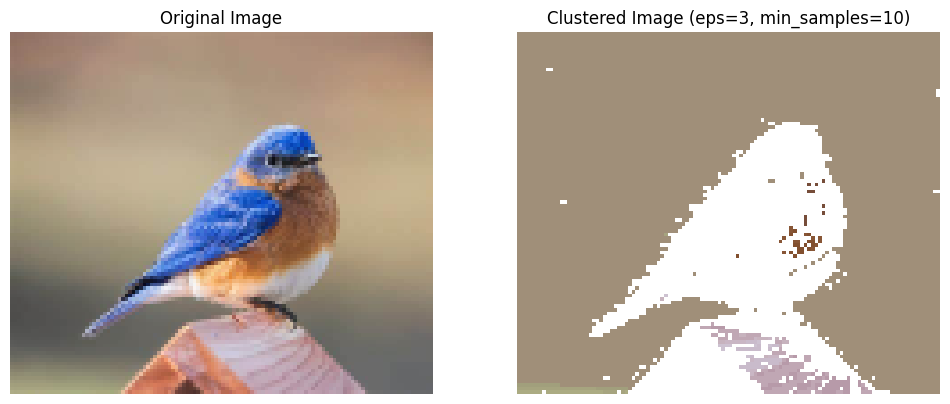

Trying eps=3, min_samples=15
RGB Space
Silhouette Score (eps=3, min_samples=15): -0.37747681083066514
Calinski-Harabasz Score (eps=3, min_samples=15): 81.1553314862603
Davies-Bouldin Score (eps=3, min_samples=15): 2.444578087277362


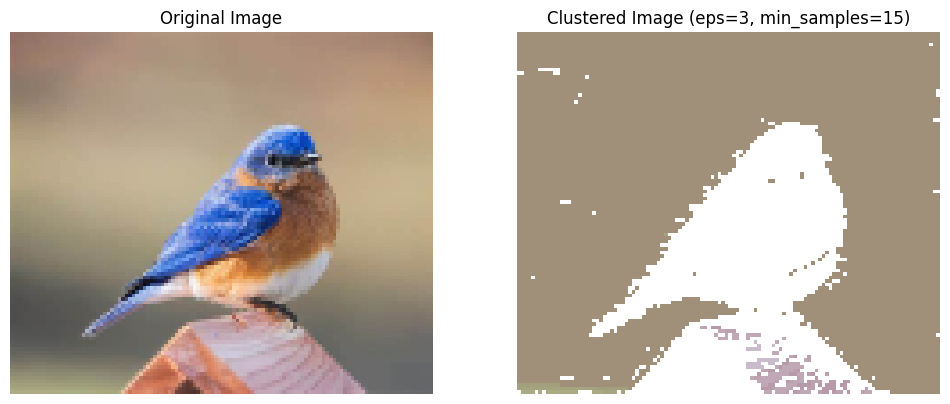

Trying eps=5, min_samples=5
RGB Space
Silhouette Score (eps=5, min_samples=5): -0.4920667594681357
Calinski-Harabasz Score (eps=5, min_samples=5): 85.53396168794148
Davies-Bouldin Score (eps=5, min_samples=5): 1.3464546419601462


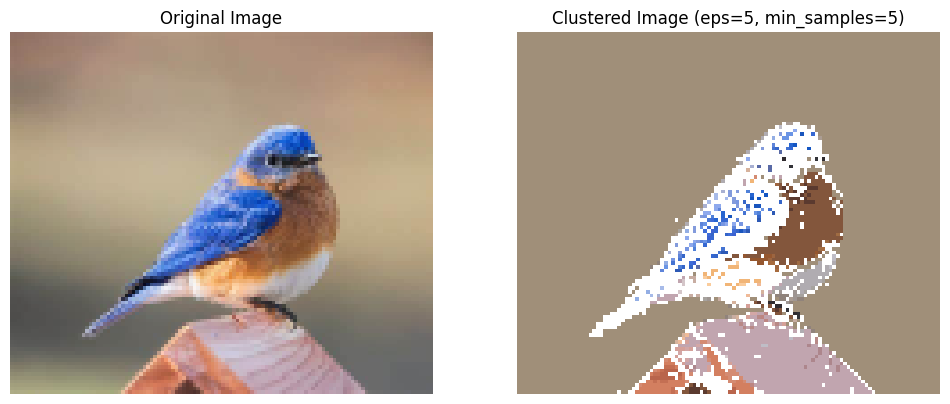

Trying eps=5, min_samples=10
RGB Space
Silhouette Score (eps=5, min_samples=10): -0.3020228233049853
Calinski-Harabasz Score (eps=5, min_samples=10): 194.30878963624997
Davies-Bouldin Score (eps=5, min_samples=10): 1.703147574591683


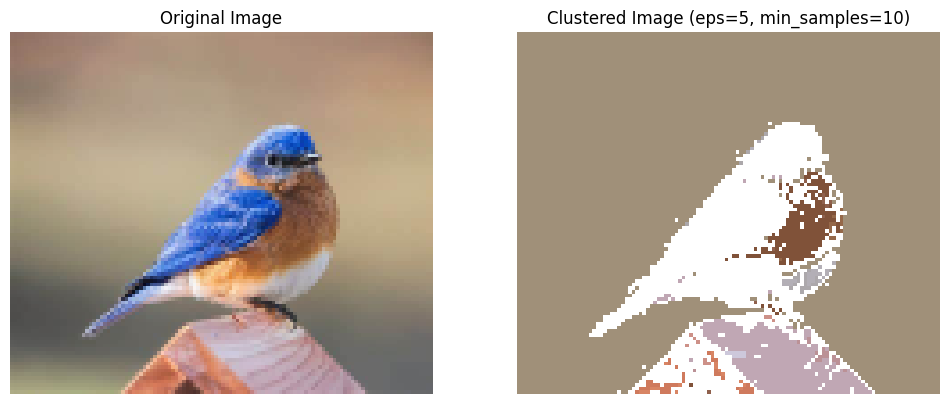

Trying eps=5, min_samples=15
RGB Space
Silhouette Score (eps=5, min_samples=15): -0.21680389649030102
Calinski-Harabasz Score (eps=5, min_samples=15): 195.15358160847677
Davies-Bouldin Score (eps=5, min_samples=15): 1.9396973560253368


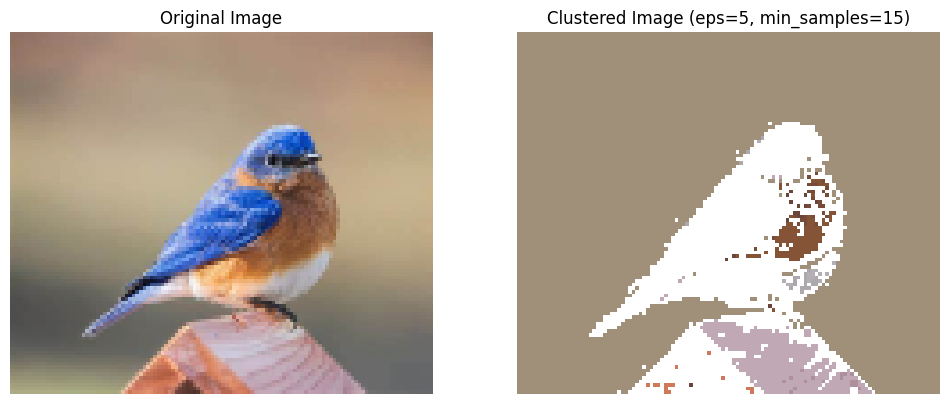

Trying eps=7, min_samples=5
RGB Space
Silhouette Score (eps=7, min_samples=5): -0.0891981343486835
Calinski-Harabasz Score (eps=7, min_samples=5): 184.60388388415484
Davies-Bouldin Score (eps=7, min_samples=5): 1.3133921481230744


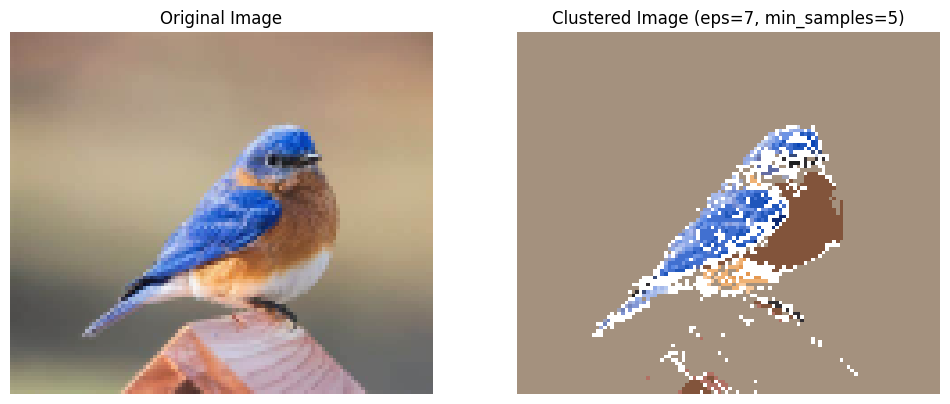

Trying eps=7, min_samples=10
RGB Space
Silhouette Score (eps=7, min_samples=10): -0.36802778570803
Calinski-Harabasz Score (eps=7, min_samples=10): 156.49734732049342
Davies-Bouldin Score (eps=7, min_samples=10): 1.4741782617498462


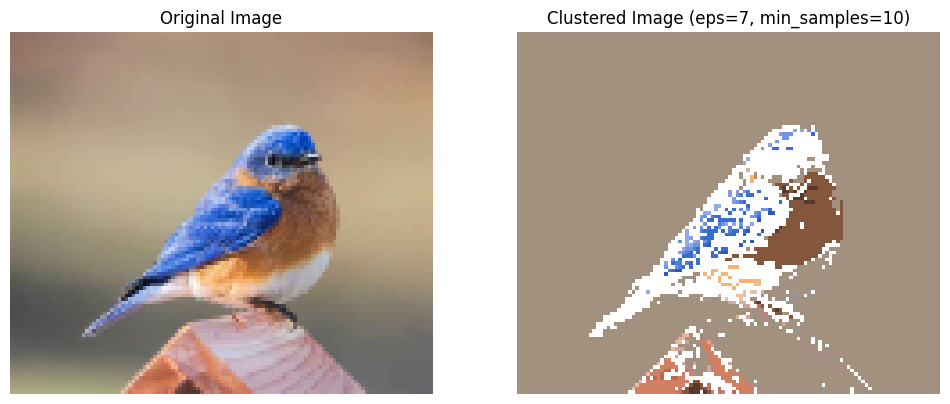

Trying eps=7, min_samples=15
RGB Space
Silhouette Score (eps=7, min_samples=15): -0.21667405149990565
Calinski-Harabasz Score (eps=7, min_samples=15): 338.62720408237584
Davies-Bouldin Score (eps=7, min_samples=15): 1.720113768728811


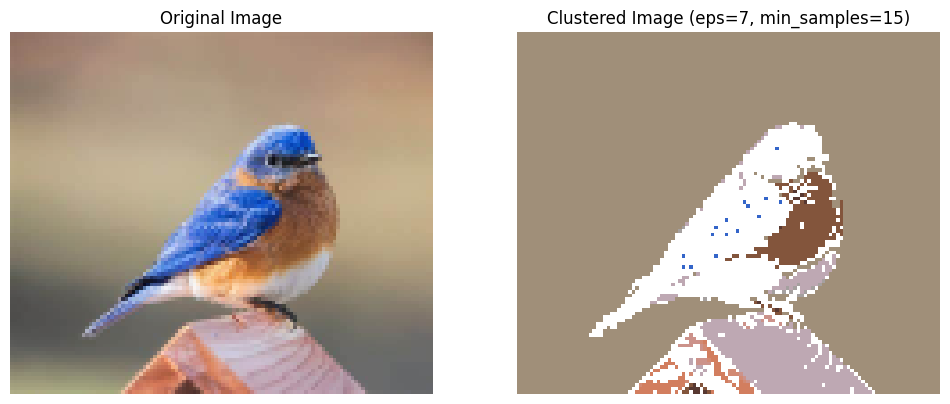

In [ ]:
import cv2
import numpy as np
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
import matplotlib.pyplot as plt

def dbscan_on_image_rgb(image, eps, min_samples):
    # Convert BGR to RGB
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Reshape the image to a 2D array of pixels and 3 color values (RGB)
    pixels = image_rgb.reshape((-1, 3))

    # DBSCAN clustering
    dbscan = DBSCAN(eps=eps, min_samples=min_samples).fit(pixels)

    # Get labels for each pixel
    labels = dbscan.labels_
    unique_labels = set(labels)
    unique_labels.discard(-1)
    n_clusters = len(unique_labels)

    # Initialize sum of colors for each cluster and pixel counts
    cluster_sums = np.zeros((n_clusters, 3), np.float64)
    cluster_counts = np.zeros(n_clusters, np.float64)

    # Sum up the pixel colors for each cluster
    for pixel, label in zip(pixels, labels):
        if label != -1:
            cluster_sums[label] += pixel
            cluster_counts[label] += 1

    # Calculate the average color of each cluster
    for i in range(n_clusters):
        if cluster_counts[i] > 0:
            cluster_sums[i] /= cluster_counts[i]

    # Assign the average color to each pixel in the cluster
    clustered_pixels = np.zeros_like(pixels)
    for i, label in enumerate(labels):
        if label != -1:
            clustered_pixels[i] = cluster_sums[label]
        else:
            clustered_pixels[i] = [255, 255, 255]

    # Reshape to the original image shape
    clustered_image = clustered_pixels.reshape(image_rgb.shape)

    return clustered_image, labels, n_clusters

# Path to the image file
image_path = '/content/bird.jpeg'
original_image = cv2.imread(image_path)

if original_image is None:
    print(f"Image not found at {image_path}")
else:
    # Resize the image more if necessary
    resized_image = cv2.resize(original_image, (0, 0), fx=0.25, fy=0.25, interpolation=cv2.INTER_AREA)
    pixels = resized_image.reshape((-1, 3))

    # Define the hyperparameters for DBSCAN
    eps_values = [3, 5, 7]
    min_samples_values = [5, 10, 15]

    # Apply DBSCAN with different hyperparameters
    for eps_val in eps_values:
        for min_samples_val in min_samples_values:
            print(f"Trying eps={eps_val}, min_samples={min_samples_val}")
            clustered_image, labels, n_clusters = dbscan_on_image_rgb(resized_image, eps_val, min_samples_val)

            # Only compute the metrics if there are clusters found
            if n_clusters > 1:
                silhouette_score_val = silhouette_score(pixels, labels)
                calinski_harabasz_score_val = calinski_harabasz_score(pixels, labels)
                davies_bouldin_score_val = davies_bouldin_score(pixels, labels)
            else:
                silhouette_score_val = None
                calinski_harabasz_score_val = None
                davies_bouldin_score_val = None

            # Print the evaluation scores
            print("================================================================================")
            print("RGB Space")
            print(f"Silhouette Score (eps={eps_val}, min_samples={min_samples_val}):", silhouette_score_val)
            print(f"Calinski-Harabasz Score (eps={eps_val}, min_samples={min_samples_val}):", calinski_harabasz_score_val)
            print(f"Davies-Bouldin Score (eps={eps_val}, min_samples={min_samples_val}):", davies_bouldin_score_val)
            print("================================================================================")

            # Display the original and clustered images
            plt.figure(figsize=(12, 6))
            plt.subplot(121), plt.imshow(cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB))
            plt.title('Original Image'), plt.axis('off')
            plt.subplot(122), plt.imshow(clustered_image)
            plt.title(f'Clustered Image (eps={eps_val}, min_samples={min_samples_val})'), plt.axis('off')
            plt.show()


Trying eps=3, min_samples=5
RGB Space
Silhouette Score (eps=3, min_samples=5): -0.7224884593896214
Calinski-Harabasz Score (eps=3, min_samples=5): 31.523336128252495
Davies-Bouldin Score (eps=3, min_samples=5): 2.6111727121769803


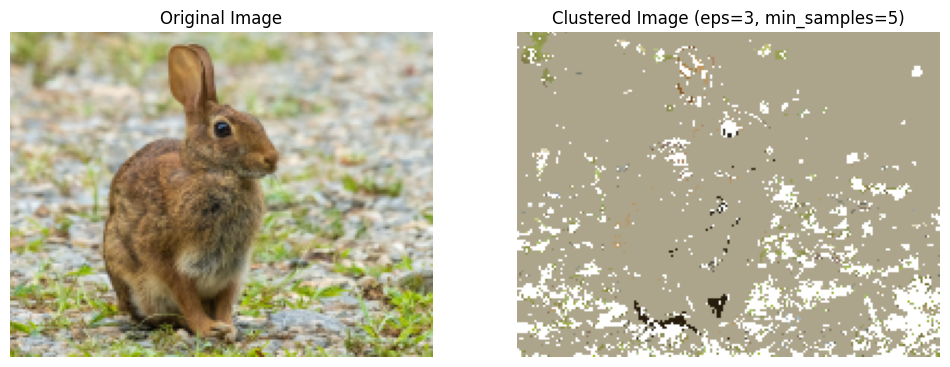

Trying eps=3, min_samples=10
RGB Space
Silhouette Score (eps=3, min_samples=10): -0.3306137587596972
Calinski-Harabasz Score (eps=3, min_samples=10): 1089.4835449229247
Davies-Bouldin Score (eps=3, min_samples=10): 1.9348727531962358


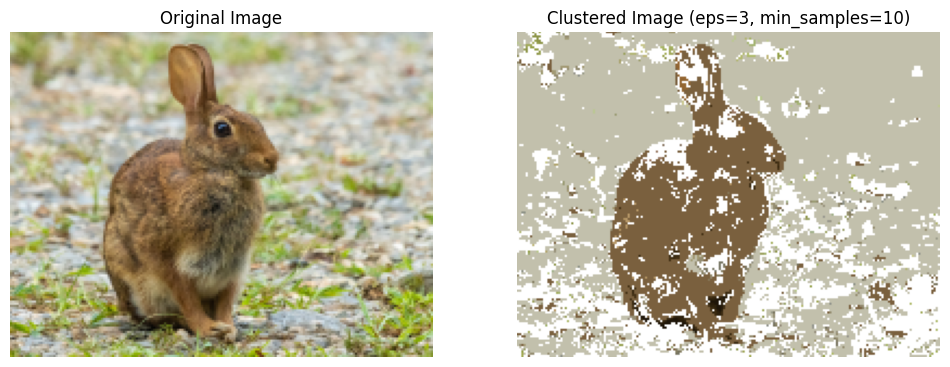

Trying eps=3, min_samples=15
RGB Space
Silhouette Score (eps=3, min_samples=15): -0.44255997865371327
Calinski-Harabasz Score (eps=3, min_samples=15): 2026.0106631185618
Davies-Bouldin Score (eps=3, min_samples=15): 1.7081834793615078


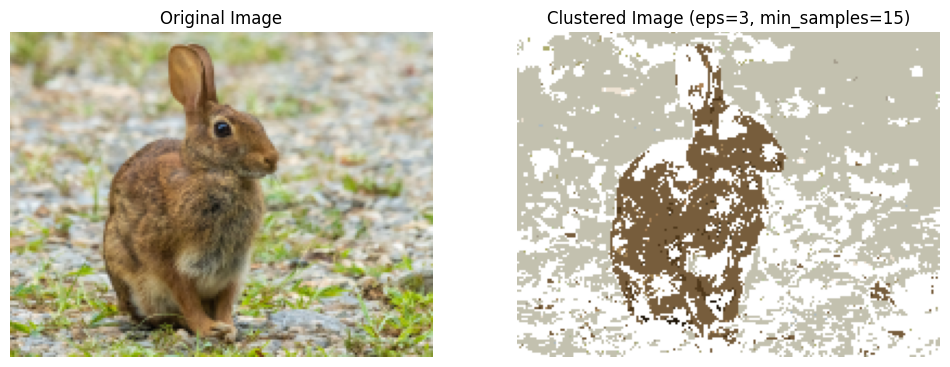

Trying eps=5, min_samples=5
RGB Space
Silhouette Score (eps=5, min_samples=5): -0.4395660361316663
Calinski-Harabasz Score (eps=5, min_samples=5): 37.34204163734947
Davies-Bouldin Score (eps=5, min_samples=5): 1.9064558266307634


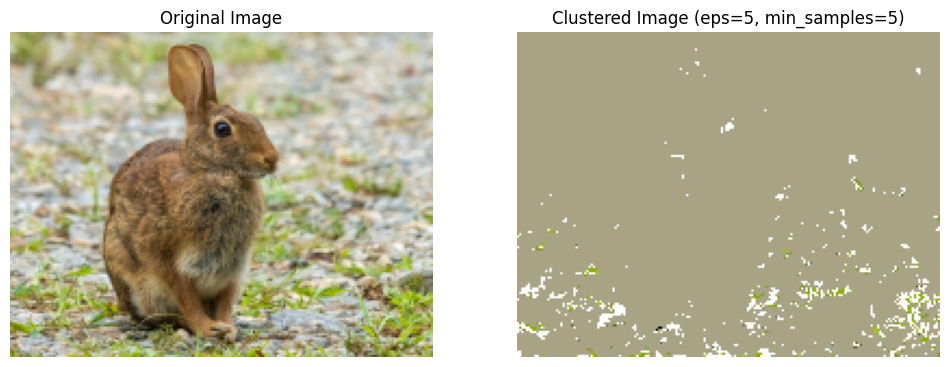

Trying eps=5, min_samples=10
RGB Space
Silhouette Score (eps=5, min_samples=10): -0.28909337103118155
Calinski-Harabasz Score (eps=5, min_samples=10): 125.31633624531538
Davies-Bouldin Score (eps=5, min_samples=10): 2.2344150244675984


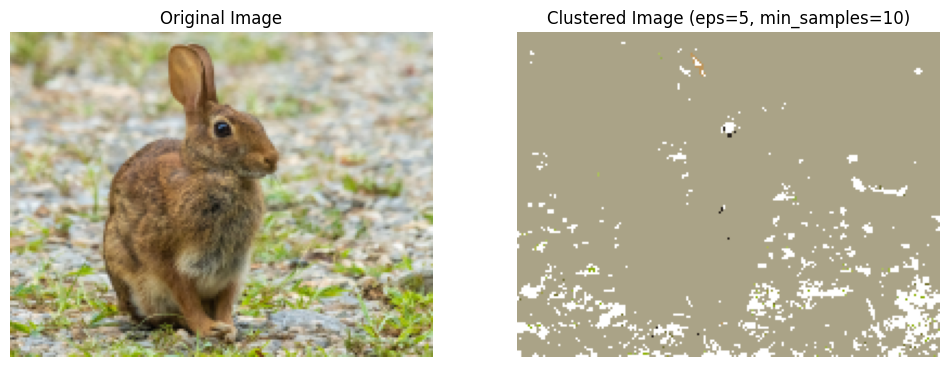

Trying eps=5, min_samples=15
RGB Space
Silhouette Score (eps=5, min_samples=15): -0.2394787277519335
Calinski-Harabasz Score (eps=5, min_samples=15): 301.4292591407095
Davies-Bouldin Score (eps=5, min_samples=15): 2.007442371677683


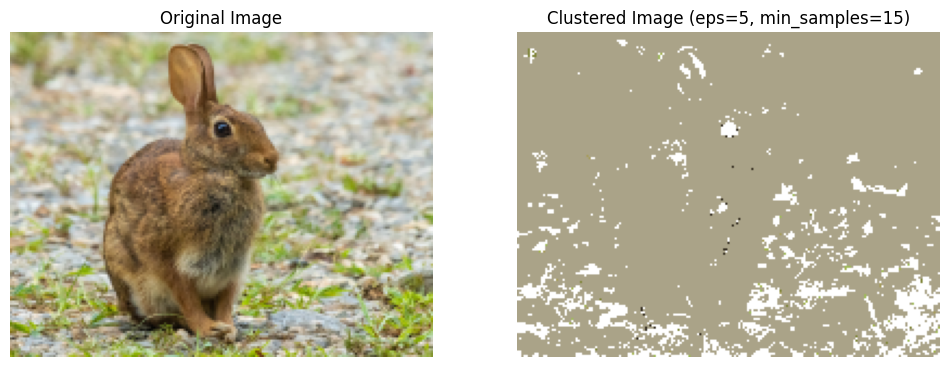

Trying eps=7, min_samples=5
RGB Space
Silhouette Score (eps=7, min_samples=5): -0.1240427199900554
Calinski-Harabasz Score (eps=7, min_samples=5): 45.863334491655436
Davies-Bouldin Score (eps=7, min_samples=5): 1.5854122115162248


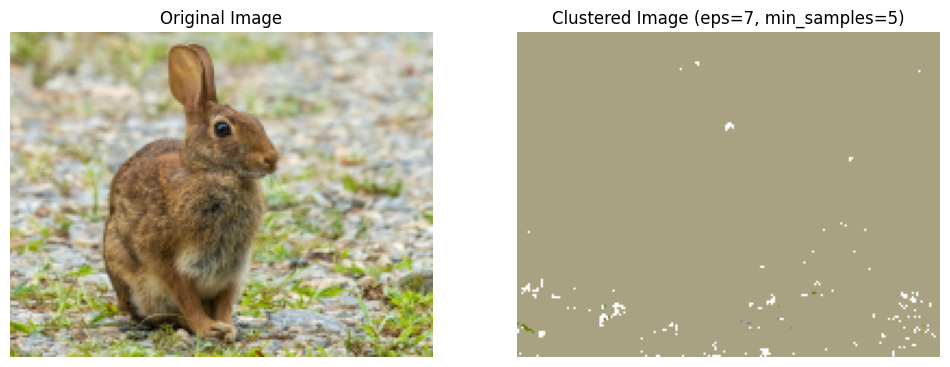

Trying eps=7, min_samples=10
RGB Space
Silhouette Score (eps=7, min_samples=10): 0.08564065509303084
Calinski-Harabasz Score (eps=7, min_samples=10): 180.51921526977134
Davies-Bouldin Score (eps=7, min_samples=10): 1.9513541603507154


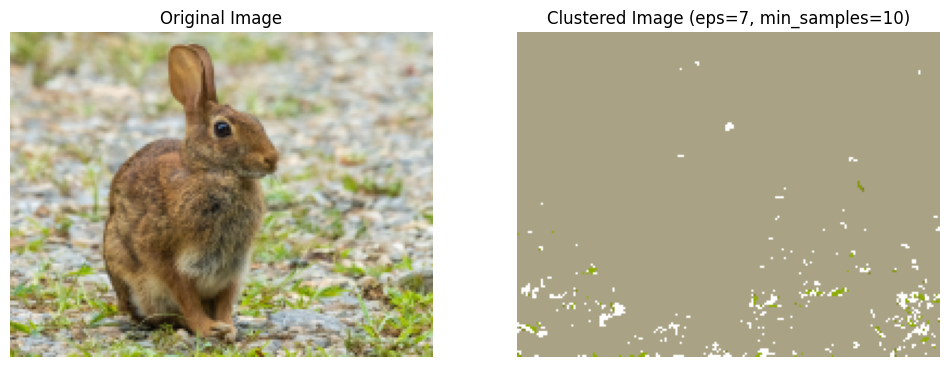

Trying eps=7, min_samples=15
RGB Space
Silhouette Score (eps=7, min_samples=15): 0.03265809307992484
Calinski-Harabasz Score (eps=7, min_samples=15): 203.85795499879643
Davies-Bouldin Score (eps=7, min_samples=15): 2.195333737263593


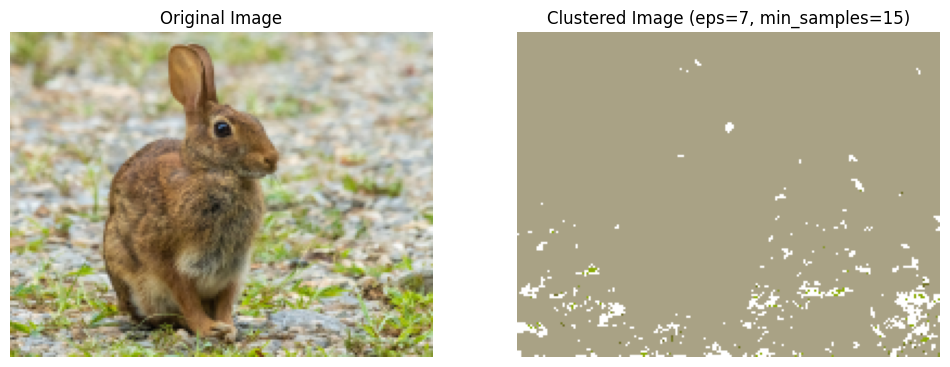

In [ ]:
import cv2
import numpy as np
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
import matplotlib.pyplot as plt

def dbscan_on_image_rgb(image, eps, min_samples):
    # Convert BGR to RGB
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Reshape the image to a 2D array of pixels and 3 color values (RGB)
    pixels = image_rgb.reshape((-1, 3))

    # DBSCAN clustering
    dbscan = DBSCAN(eps=eps, min_samples=min_samples).fit(pixels)

    # Get labels for each pixel
    labels = dbscan.labels_
    unique_labels = set(labels)
    unique_labels.discard(-1)
    n_clusters = len(unique_labels)

    # Initialize sum of colors for each cluster and pixel counts
    cluster_sums = np.zeros((n_clusters, 3), np.float64)
    cluster_counts = np.zeros(n_clusters, np.float64)

    # Sum up the pixel colors for each cluster
    for pixel, label in zip(pixels, labels):
        if label != -1:  # Ignore noise points
            cluster_sums[label] += pixel
            cluster_counts[label] += 1

    # Calculate the average color of each cluster
    for i in range(n_clusters):
        if cluster_counts[i] > 0:
            cluster_sums[i] /= cluster_counts[i]

    # Assign the average color to each pixel in the cluster
    clustered_pixels = np.zeros_like(pixels)
    for i, label in enumerate(labels):
        if label != -1:  # Ignore noise points
            clustered_pixels[i] = cluster_sums[label]
        else:
            clustered_pixels[i] = [255, 255, 255]

    # Reshape to the original image shape
    clustered_image = clustered_pixels.reshape(image_rgb.shape)

    return clustered_image, labels, n_clusters

# Path to the image file
image_path = '/content/rabbit.jpg'
original_image = cv2.imread(image_path)

if original_image is None:
    print(f"Image not found at {image_path}")
else:
    # Resize the image more if necessary
    resized_image = cv2.resize(original_image, (0, 0), fx=0.25, fy=0.25, interpolation=cv2.INTER_AREA)
    pixels = resized_image.reshape((-1, 3))

    # Define the hyperparameters for DBSCAN
    eps_values = [3, 5, 7]
    min_samples_values = [5, 10, 15]

    # Apply DBSCAN with different hyperparameters
    for eps_val in eps_values:
        for min_samples_val in min_samples_values:
            print(f"Trying eps={eps_val}, min_samples={min_samples_val}")
            clustered_image, labels, n_clusters = dbscan_on_image_rgb(resized_image, eps_val, min_samples_val)

            # Only compute the metrics if there are clusters found
            if n_clusters > 1:
                silhouette_score_val = silhouette_score(pixels, labels)
                calinski_harabasz_score_val = calinski_harabasz_score(pixels, labels)
                davies_bouldin_score_val = davies_bouldin_score(pixels, labels)
            else:
                silhouette_score_val = None
                calinski_harabasz_score_val = None
                davies_bouldin_score_val = None

            # Print the evaluation scores
            print("================================================================================")
            print("RGB Space")
            print(f"Silhouette Score (eps={eps_val}, min_samples={min_samples_val}):", silhouette_score_val)
            print(f"Calinski-Harabasz Score (eps={eps_val}, min_samples={min_samples_val}):", calinski_harabasz_score_val)
            print(f"Davies-Bouldin Score (eps={eps_val}, min_samples={min_samples_val}):", davies_bouldin_score_val)
            print("================================================================================")

            # Display the original and clustered images
            plt.figure(figsize=(12, 6))
            plt.subplot(121), plt.imshow(cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB))
            plt.title('Original Image'), plt.axis('off')
            plt.subplot(122), plt.imshow(clustered_image)
            plt.title(f'Clustered Image (eps={eps_val}, min_samples={min_samples_val})'), plt.axis('off')
            plt.show()


Trying eps=3, min_samples=5
RGB Space
Silhouette Score (eps=3, min_samples=5): -0.38910612672656053
Calinski-Harabasz Score (eps=3, min_samples=5): 1985.1227558687701
Davies-Bouldin Score (eps=3, min_samples=5): 1.6158244906293227


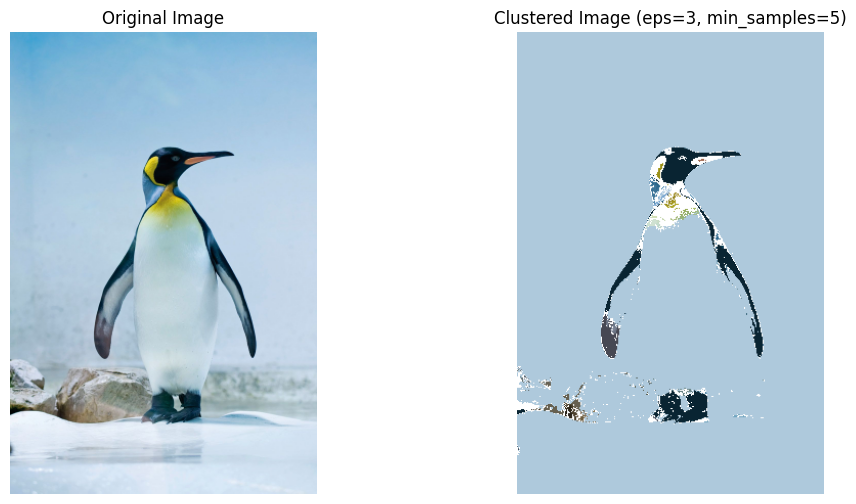

Trying eps=3, min_samples=10
RGB Space
Silhouette Score (eps=3, min_samples=10): -0.30815583068941127
Calinski-Harabasz Score (eps=3, min_samples=10): 3462.585088272696
Davies-Bouldin Score (eps=3, min_samples=10): 1.7692433304456583


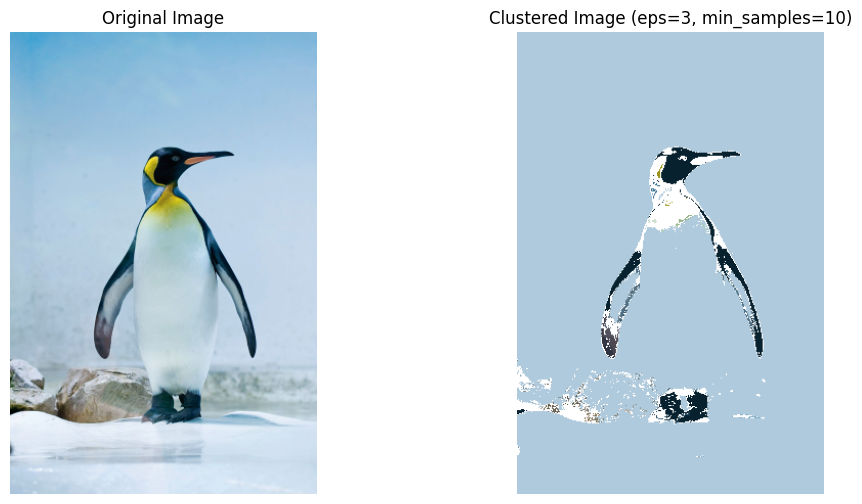

Trying eps=3, min_samples=15
RGB Space
Silhouette Score (eps=3, min_samples=15): 0.04202095160590942
Calinski-Harabasz Score (eps=3, min_samples=15): 7128.37276823516
Davies-Bouldin Score (eps=3, min_samples=15): 1.575387384175451


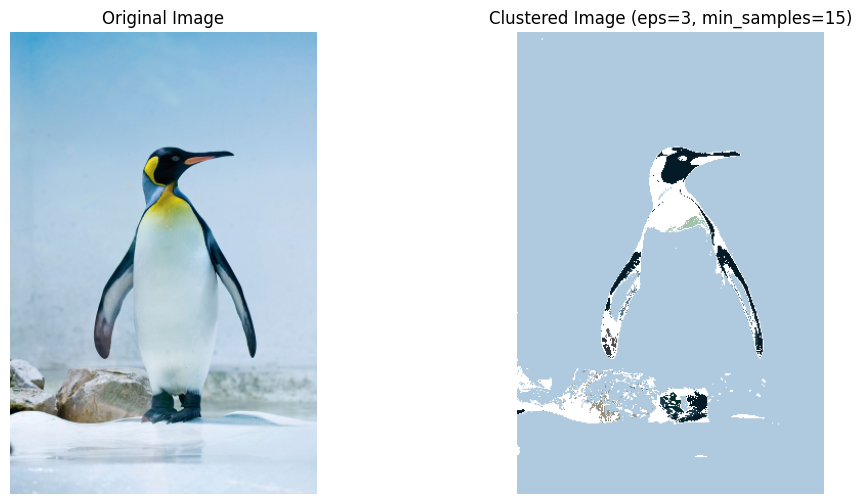

Trying eps=5, min_samples=5
RGB Space
Silhouette Score (eps=5, min_samples=5): 0.07233711731293345
Calinski-Harabasz Score (eps=5, min_samples=5): 233.67486946285203
Davies-Bouldin Score (eps=5, min_samples=5): 1.1884764394774776


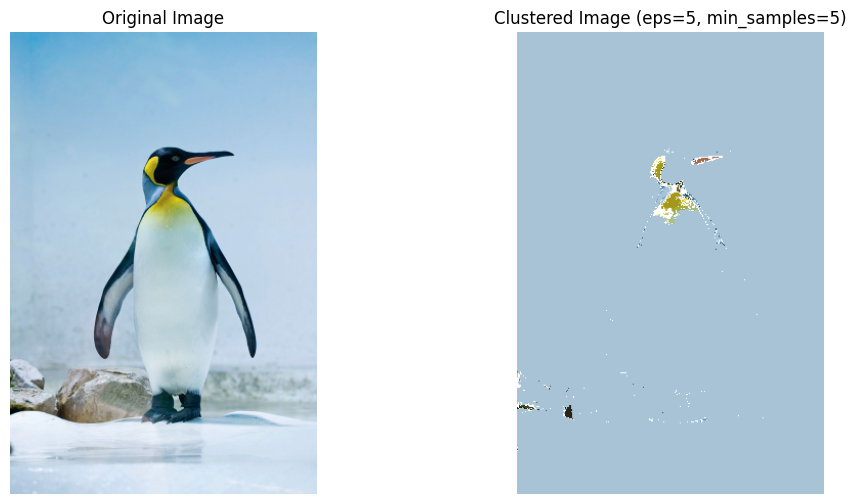

Trying eps=5, min_samples=10
RGB Space
Silhouette Score (eps=5, min_samples=10): 0.25092127312510776
Calinski-Harabasz Score (eps=5, min_samples=10): 814.3238417207825
Davies-Bouldin Score (eps=5, min_samples=10): 1.3901807762734677


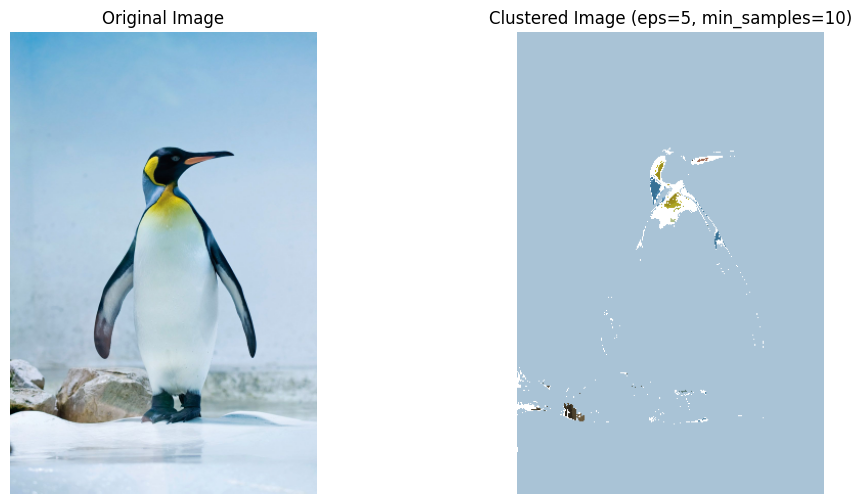

Trying eps=5, min_samples=15
RGB Space
Silhouette Score (eps=5, min_samples=15): 0.07764466318044176
Calinski-Harabasz Score (eps=5, min_samples=15): 1332.6737363715322
Davies-Bouldin Score (eps=5, min_samples=15): 1.3268834059597512


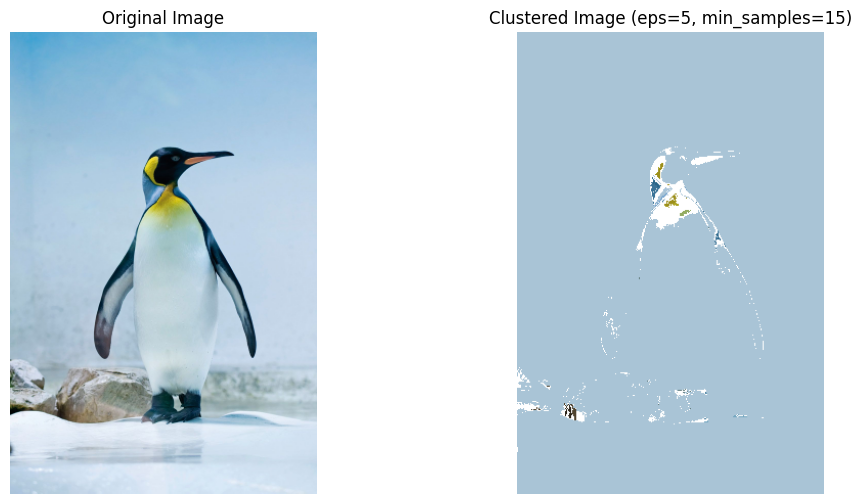

Trying eps=7, min_samples=5
RGB Space
Silhouette Score (eps=7, min_samples=5): 0.3438018765712432
Calinski-Harabasz Score (eps=7, min_samples=5): 182.3151921795958
Davies-Bouldin Score (eps=7, min_samples=5): 1.2329181364422104


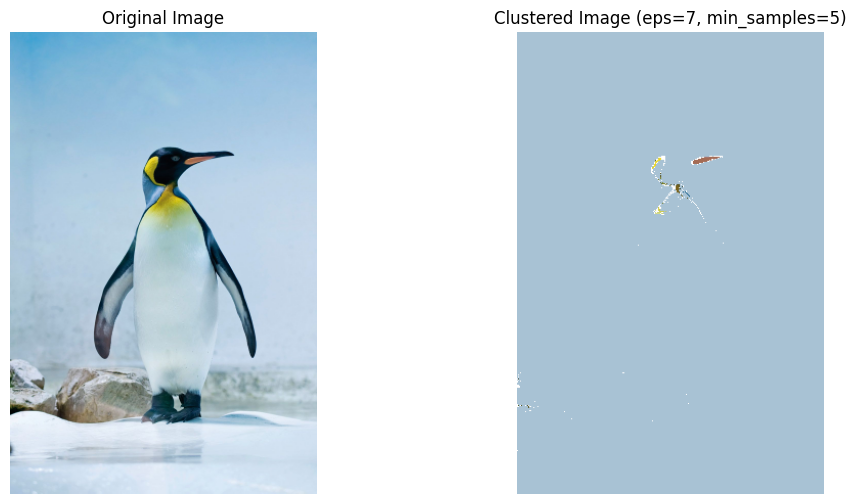

Trying eps=7, min_samples=10
RGB Space
Silhouette Score (eps=7, min_samples=10): 0.17229411061530342
Calinski-Harabasz Score (eps=7, min_samples=10): 424.65864359079114
Davies-Bouldin Score (eps=7, min_samples=10): 1.1772963600557216


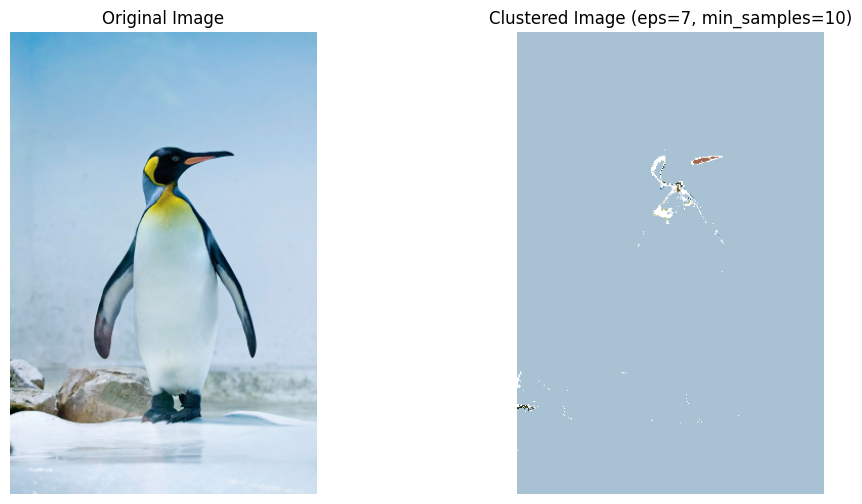

Trying eps=7, min_samples=15
RGB Space
Silhouette Score (eps=7, min_samples=15): 0.2664068185720622
Calinski-Harabasz Score (eps=7, min_samples=15): 890.7659007064666
Davies-Bouldin Score (eps=7, min_samples=15): 1.4836487834765284


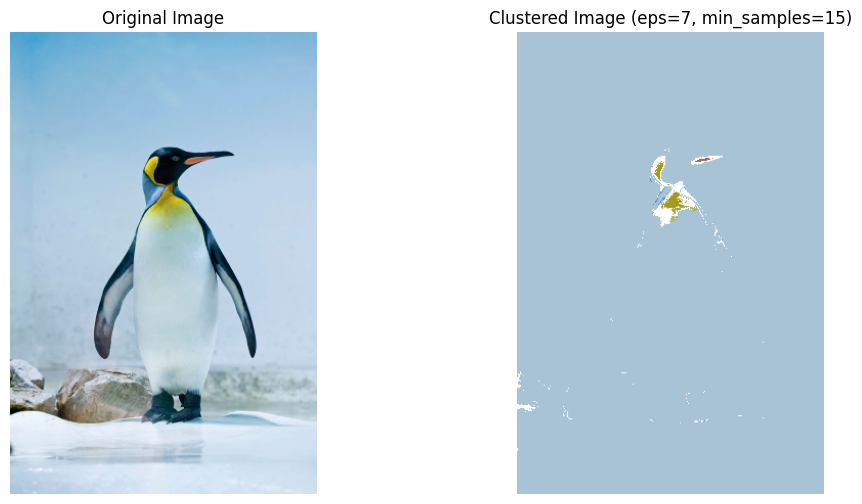

In [2]:
import cv2
import numpy as np
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
import matplotlib.pyplot as plt

def dbscan_on_image_rgb(image, eps, min_samples):
    # Convert BGR to RGB
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Reshape the image to a 2D array of pixels and 3 color values (RGB)
    pixels = image_rgb.reshape((-1, 3))

    # DBSCAN clustering
    dbscan = DBSCAN(eps=eps, min_samples=min_samples).fit(pixels)

    # Get labels for each pixel
    labels = dbscan.labels_
    unique_labels = set(labels)
    unique_labels.discard(-1)  # Remove the noise label if present
    n_clusters = len(unique_labels)

    # Initialize sum of colors for each cluster and pixel counts
    cluster_sums = np.zeros((n_clusters, 3), np.float64)
    cluster_counts = np.zeros(n_clusters, np.float64)

    # Sum up the pixel colors for each cluster
    for pixel, label in zip(pixels, labels):
        if label != -1:  # Ignore noise points
            cluster_sums[label] += pixel
            cluster_counts[label] += 1

    # Calculate the average color of each cluster
    for i in range(n_clusters):
        if cluster_counts[i] > 0:
            cluster_sums[i] /= cluster_counts[i]

    # Assign the average color to each pixel in the cluster
    clustered_pixels = np.zeros_like(pixels)
    for i, label in enumerate(labels):
        if label != -1:  # Ignore noise points
            clustered_pixels[i] = cluster_sums[label]
        else:
            clustered_pixels[i] = [255, 255, 255]

    # Reshape to the original image shape
    clustered_image = clustered_pixels.reshape(image_rgb.shape)

    return clustered_image, labels, n_clusters

# Path to the image file
image_path = '/content/penguin.jpeg'
original_image = cv2.imread(image_path)

if original_image is None:
    print(f"Image not found at {image_path}")
else:
    # Resize the image more if necessary
    resized_image = cv2.resize(original_image, (0, 0), fx=0.25, fy=0.25, interpolation=cv2.INTER_AREA)
    pixels = resized_image.reshape((-1, 3))

    # Define the hyperparameters for DBSCAN
    eps_values = [3, 5, 7]
    min_samples_values = [5, 10, 15]

    # Apply DBSCAN with different hyperparameters
    for eps_val in eps_values:
        for min_samples_val in min_samples_values:
            print(f"Trying eps={eps_val}, min_samples={min_samples_val}")
            clustered_image, labels, n_clusters = dbscan_on_image_rgb(resized_image, eps_val, min_samples_val)

            # Only compute the metrics if there are clusters found
            if n_clusters > 1:
                silhouette_score_val = silhouette_score(pixels, labels)
                calinski_harabasz_score_val = calinski_harabasz_score(pixels, labels)
                davies_bouldin_score_val = davies_bouldin_score(pixels, labels)
            else:
                silhouette_score_val = None
                calinski_harabasz_score_val = None
                davies_bouldin_score_val = None

            # Print the evaluation scores
            print("================================================================================")
            print("RGB Space")
            print(f"Silhouette Score (eps={eps_val}, min_samples={min_samples_val}):", silhouette_score_val)
            print(f"Calinski-Harabasz Score (eps={eps_val}, min_samples={min_samples_val}):", calinski_harabasz_score_val)
            print(f"Davies-Bouldin Score (eps={eps_val}, min_samples={min_samples_val}):", davies_bouldin_score_val)
            print("================================================================================")

            # Display the original and clustered images
            plt.figure(figsize=(12, 6))
            plt.subplot(121), plt.imshow(cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB))
            plt.title('Original Image'), plt.axis('off')
            plt.subplot(122), plt.imshow(clustered_image)
            plt.title(f'Clustered Image (eps={eps_val}, min_samples={min_samples_val})'), plt.axis('off')
            plt.show()


In the analysis,process of choosing the right parameters is crucial. When we used smaller values for the parameters eps and min_samples, the clustering results were not effective, with poor cluster separation. However, increasing min_samples while keeping eps constant led to improved clustering results. The clusters became more well-defined and separated from each other. The evaluation scores, such as Silhouette Score, Calinski-Harabasz Score, and Davies-Bouldin Score, confirmed these findings.

***Augmented Space***

Trying eps=3, min_samples=5
Augmented RGBXY Space
Silhouette Score (eps=3, min_samples=5): -0.5850430312054666
Calinski-Harabasz Score (eps=3, min_samples=5): 172.4754459722312
Davies-Bouldin Score (eps=3, min_samples=5): 1.3804457641476828


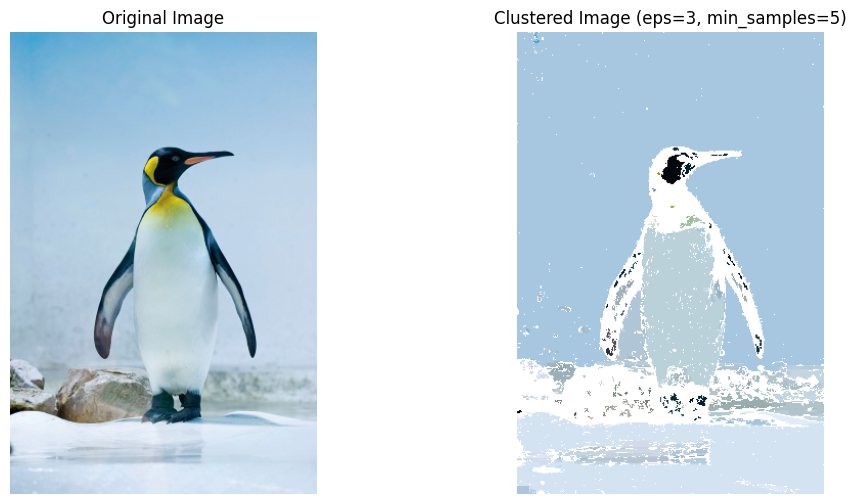

Trying eps=3, min_samples=10
Augmented RGBXY Space
Silhouette Score (eps=3, min_samples=10): -0.6356008969679454
Calinski-Harabasz Score (eps=3, min_samples=10): 383.70694947931173
Davies-Bouldin Score (eps=3, min_samples=10): 1.3883726846893554


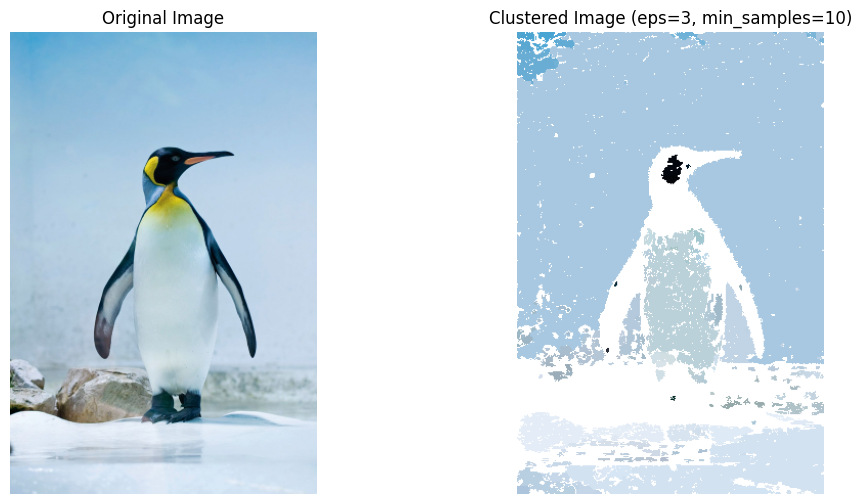

Trying eps=3, min_samples=15
Augmented RGBXY Space
Silhouette Score (eps=3, min_samples=15): -0.6336064455062674
Calinski-Harabasz Score (eps=3, min_samples=15): 307.5564775150069
Davies-Bouldin Score (eps=3, min_samples=15): 1.3012690071069777


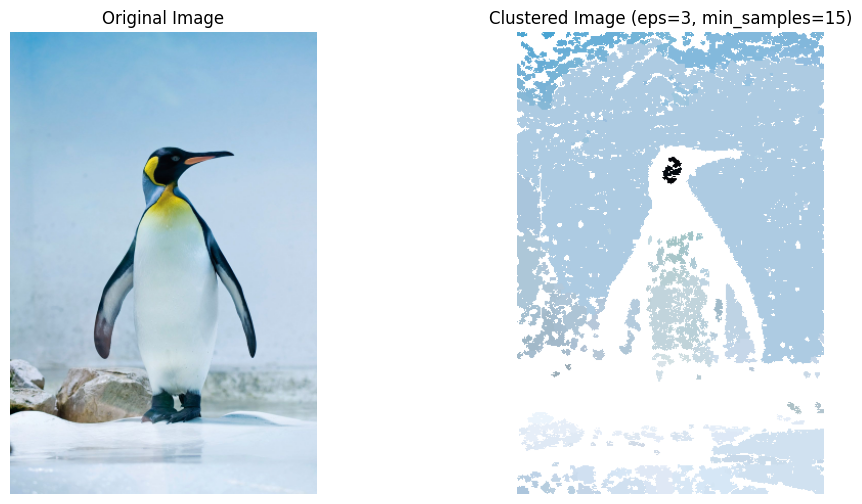

Trying eps=5, min_samples=5
Augmented RGBXY Space
Silhouette Score (eps=5, min_samples=5): -0.58729954103399
Calinski-Harabasz Score (eps=5, min_samples=5): 245.3615267569453
Davies-Bouldin Score (eps=5, min_samples=5): 1.4926216847143927


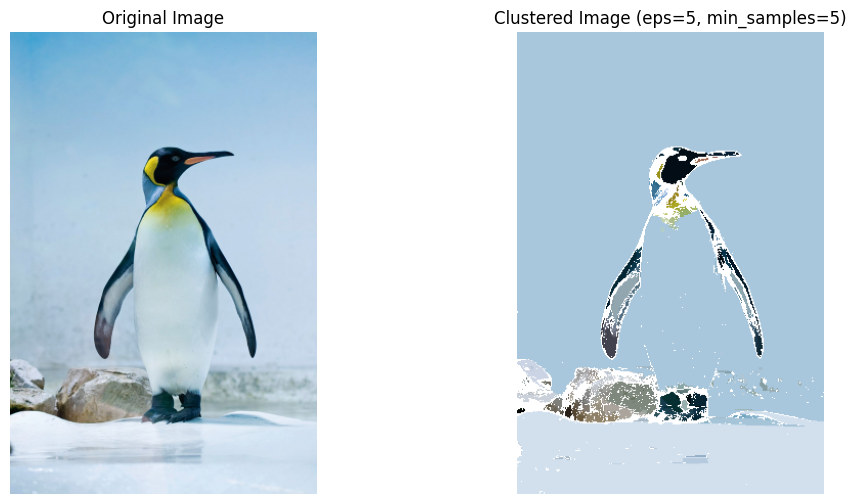

Trying eps=5, min_samples=10
Augmented RGBXY Space
Silhouette Score (eps=5, min_samples=10): -0.473841582823665
Calinski-Harabasz Score (eps=5, min_samples=10): 553.8758806912816
Davies-Bouldin Score (eps=5, min_samples=10): 1.3928510569344268


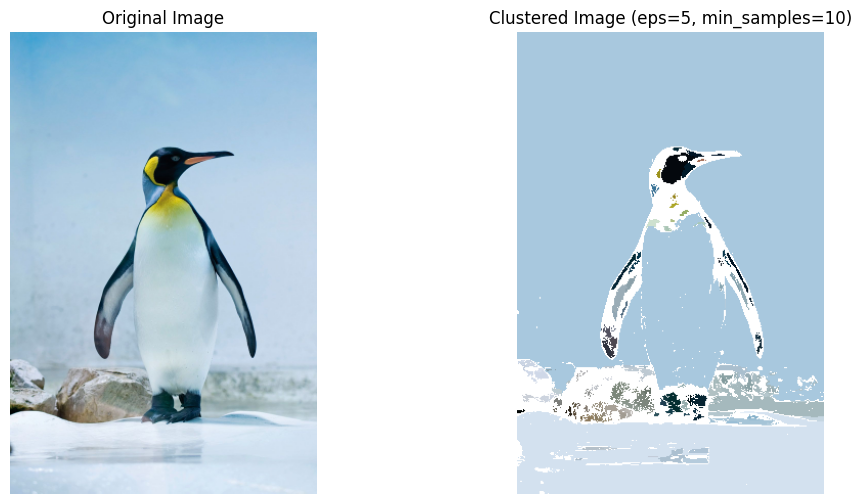

Trying eps=5, min_samples=15
Augmented RGBXY Space
Silhouette Score (eps=5, min_samples=15): -0.4664611232104883
Calinski-Harabasz Score (eps=5, min_samples=15): 928.7445763156195
Davies-Bouldin Score (eps=5, min_samples=15): 1.3821059259493063


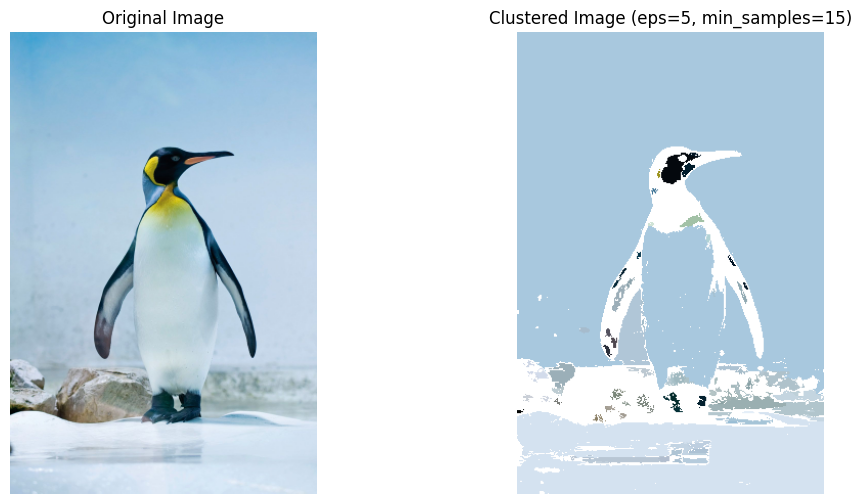

Trying eps=7, min_samples=5
Augmented RGBXY Space
Silhouette Score (eps=7, min_samples=5): -0.6081963812992365
Calinski-Harabasz Score (eps=7, min_samples=5): 120.17014864859395
Davies-Bouldin Score (eps=7, min_samples=5): 1.324798929089777


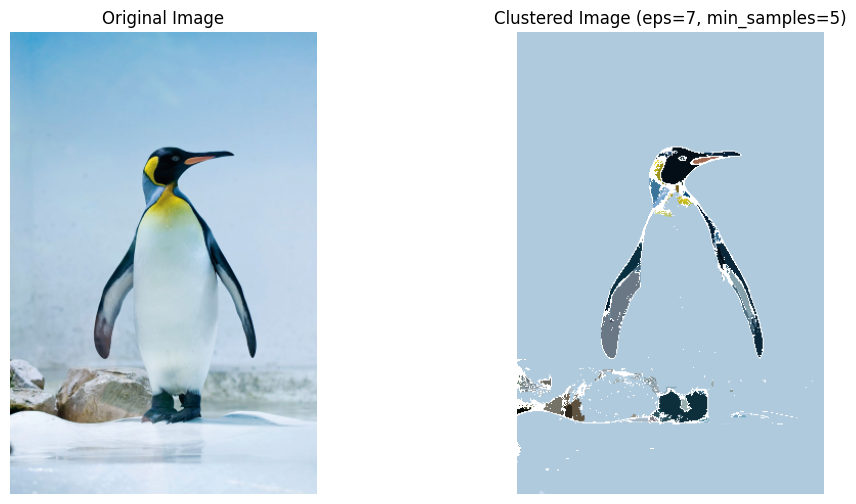

Trying eps=7, min_samples=10
Augmented RGBXY Space
Silhouette Score (eps=7, min_samples=10): -0.5282653963576689
Calinski-Harabasz Score (eps=7, min_samples=10): 258.6501673573668
Davies-Bouldin Score (eps=7, min_samples=10): 1.3328481139859842


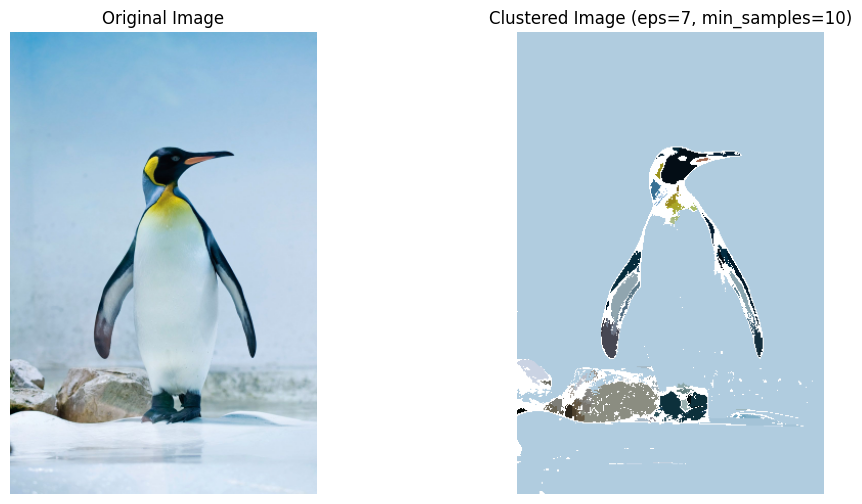

Trying eps=7, min_samples=15
Augmented RGBXY Space
Silhouette Score (eps=7, min_samples=15): -0.3515386426256674
Calinski-Harabasz Score (eps=7, min_samples=15): 1250.0906893531394
Davies-Bouldin Score (eps=7, min_samples=15): 1.2547417976036086


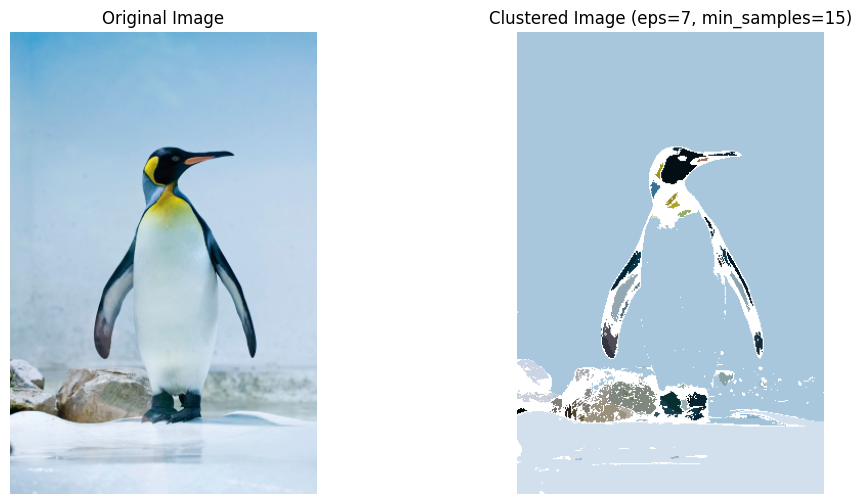

In [ ]:
import cv2
import numpy as np
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
import matplotlib.pyplot as plt

def dbscan_on_image_rgb(image, eps, min_samples):
    # Convert BGR to RGB
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Get the height and width of the image
    height, width = image_rgb.shape[:2]

    # Initialize an array to hold the augmented pixel data
    augmented_pixels = []

    # Loop over each pixel and append the x-y coordinates to its RGB values
    for y in range(height):
        for x in range(width):
            r, g, b = image_rgb[y, x]
            augmented_pixels.append([r, g, b, x, y])

    # Convert to numpy array for DBSCAN
    augmented_pixels = np.array(augmented_pixels)

    # DBSCAN clustering
    dbscan = DBSCAN(eps=eps, min_samples=min_samples).fit(augmented_pixels)

    # Get labels for each pixel
    labels = dbscan.labels_
    unique_labels = set(labels)
    unique_labels.discard(-1)
    n_clusters = len(unique_labels)

    # Initialize sum of colors for each cluster and pixel counts
    cluster_sums = np.zeros((n_clusters, 3), np.float64)
    cluster_counts = np.zeros(n_clusters, np.float64)

    # Sum up the pixel colors for each cluster
    for pixel, label in zip(augmented_pixels, labels):
        if label != -1:  # Ignore noise points
            cluster_sums[label] += pixel[:3]
            cluster_counts[label] += 1

    # Calculate the average color of each cluster
    for i in range(n_clusters):
        if cluster_counts[i] > 0:
            cluster_sums[i] /= cluster_counts[i]

    # Assign the average color to each pixel in the cluster
    clustered_pixels = np.zeros_like(image_rgb)
    index = 0
    for y in range(height):
        for x in range(width):
            label = labels[index]
            if label != -1:
                clustered_pixels[y, x] = cluster_sums[label]
            else:
                clustered_pixels[y, x] = [255, 255, 255]
            index += 1

    # Return the clustered image, augmented pixels, labels, and number of clusters
    return clustered_pixels, augmented_pixels, labels, n_clusters

# Path to the image file
image_path = '/content/penguin.jpeg'  # Replace with your image path
original_image = cv2.imread(image_path)

if original_image is None:
    print(f"Image not found at {image_path}")
else:
    # Resize the image more if necessary
    resized_image = cv2.resize(original_image, (0, 0), fx=0.25, fy=0.25, interpolation=cv2.INTER_AREA)

    # Define the hyperparameters for DBSCAN
    eps_values = [3, 5, 7]
    min_samples_values = [5, 10, 15]

    # Apply DBSCAN with different hyperparameters
    for eps_val in eps_values:
        for min_samples_val in min_samples_values:
            print(f"Trying eps={eps_val}, min_samples={min_samples_val}")
            clustered_image, augmented_pixels, labels, n_clusters = dbscan_on_image_rgb(resized_image, eps_val, min_samples_val)

            # Only compute the metrics if there are clusters found
            if n_clusters > 1:
                silhouette_score_val = silhouette_score(augmented_pixels, labels)
                calinski_harabasz_score_val = calinski_harabasz_score(augmented_pixels, labels)
                davies_bouldin_score_val = davies_bouldin_score(augmented_pixels, labels)
            else:
                silhouette_score_val = None
                calinski_harabasz_score_val = None
                davies_bouldin_score_val = None

            # Print the evaluation scores
            print("================================================================================")
            print("Augmented Space")
            print(f"Silhouette Score (eps={eps_val}, min_samples={min_samples_val}):", silhouette_score_val)
            print(f"Calinski-Harabasz Score (eps={eps_val}, min_samples={min_samples_val}):", calinski_harabasz_score_val)
            print(f"Davies-Bouldin Score (eps={eps_val}, min_samples={min_samples_val}):", davies_bouldin_score_val)
            print("================================================================================")

            # Display the original and clustered images
            plt.figure(figsize=(12, 6))
            plt.subplot(121), plt.imshow(cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB))
            plt.title('Original Image'), plt.axis('off')
            plt.subplot(122), plt.imshow(clustered_image)
            plt.title(f'Clustered Image (eps={eps_val}, min_samples={min_samples_val})'), plt.axis('off')
            plt.show()


Trying eps=3, min_samples=5
Augmented Space
Silhouette Score (eps=3, min_samples=5): -0.49849257370648975
Calinski-Harabasz Score (eps=3, min_samples=5): 87.07008753184347
Davies-Bouldin Score (eps=3, min_samples=5): 1.0864019812330654


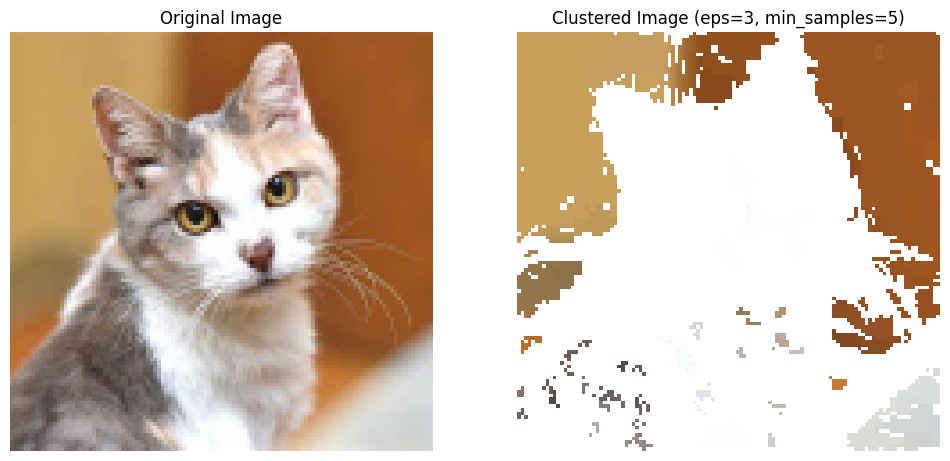

Trying eps=3, min_samples=10
Augmented Space
Silhouette Score (eps=3, min_samples=10): -0.4337609710298108
Calinski-Harabasz Score (eps=3, min_samples=10): 136.45991012783756
Davies-Bouldin Score (eps=3, min_samples=10): 1.0333954498030875


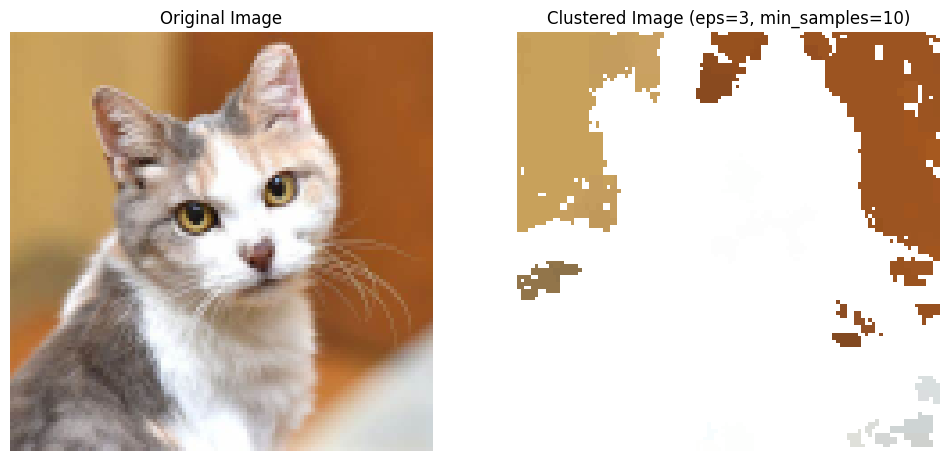

Trying eps=3, min_samples=15
Augmented Space
Silhouette Score (eps=3, min_samples=15): -0.4574605848617803
Calinski-Harabasz Score (eps=3, min_samples=15): 122.89859200332963
Davies-Bouldin Score (eps=3, min_samples=15): 1.2252905175272302


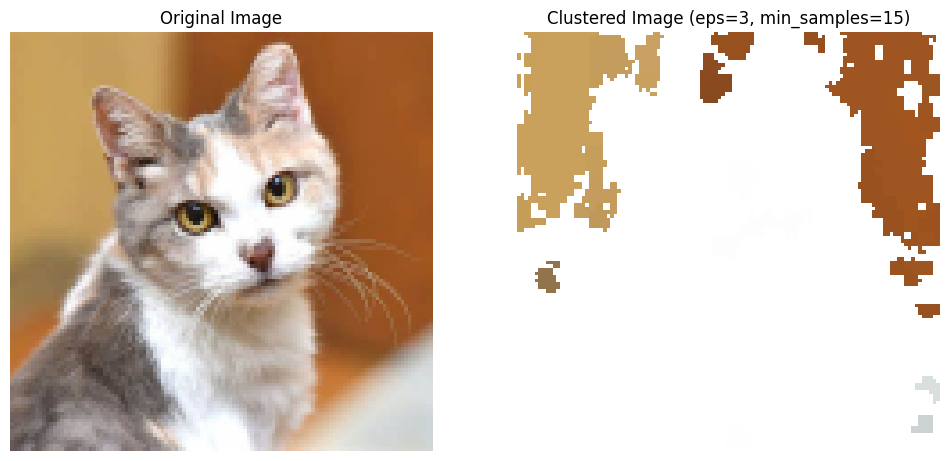

Trying eps=5, min_samples=5
Augmented Space
Silhouette Score (eps=5, min_samples=5): -0.3692101417681883
Calinski-Harabasz Score (eps=5, min_samples=5): 169.75125293716837
Davies-Bouldin Score (eps=5, min_samples=5): 1.3072045906835008


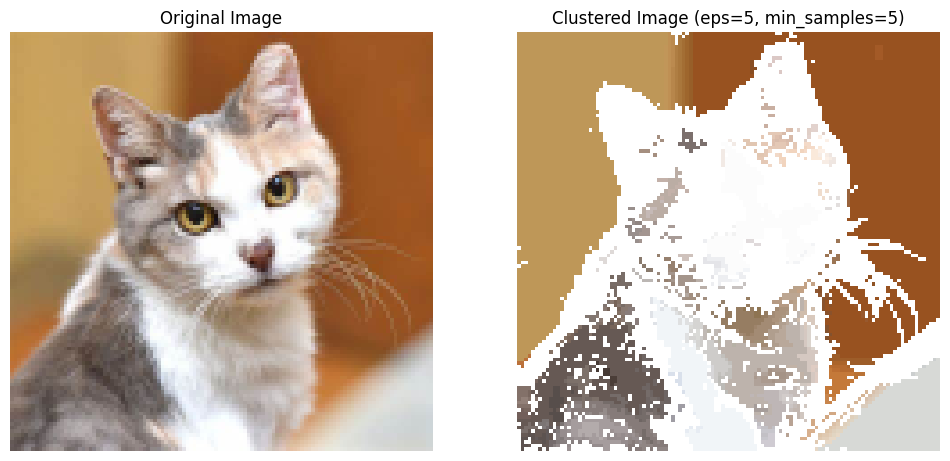

Trying eps=5, min_samples=10
Augmented Space
Silhouette Score (eps=5, min_samples=10): -0.33784071247690356
Calinski-Harabasz Score (eps=5, min_samples=10): 347.6707494359903
Davies-Bouldin Score (eps=5, min_samples=10): 1.1902275656153052


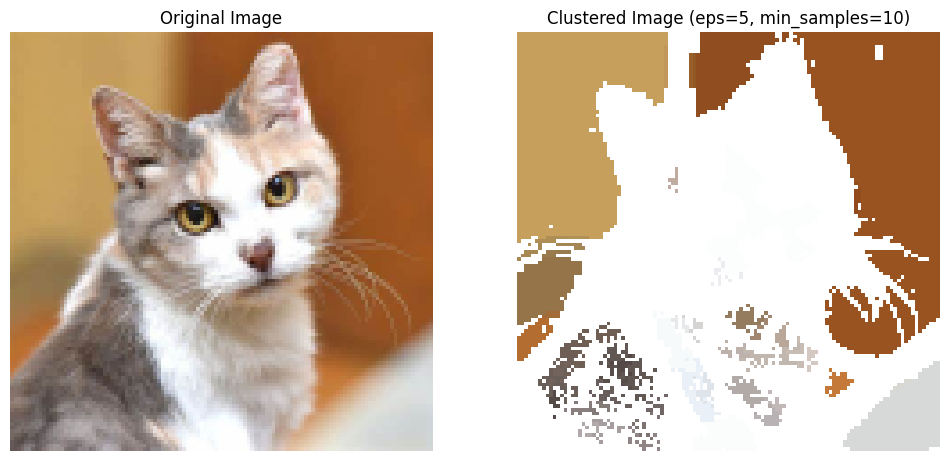

Trying eps=5, min_samples=15
Augmented Space
Silhouette Score (eps=5, min_samples=15): -0.19089456174638825
Calinski-Harabasz Score (eps=5, min_samples=15): 963.2084969360266
Davies-Bouldin Score (eps=5, min_samples=15): 0.991133824884321


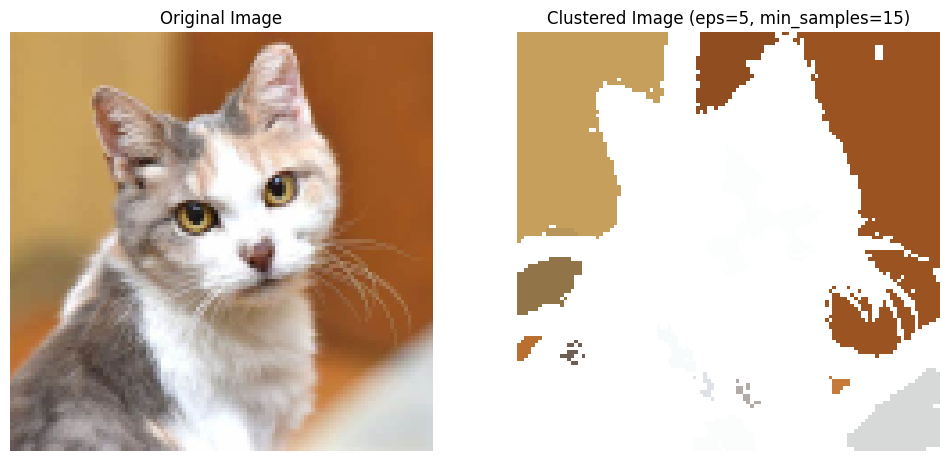

Trying eps=7, min_samples=5
Augmented Space
Silhouette Score (eps=7, min_samples=5): -0.25401551516104254
Calinski-Harabasz Score (eps=7, min_samples=5): 336.6579662976098
Davies-Bouldin Score (eps=7, min_samples=5): 1.5475525022447325


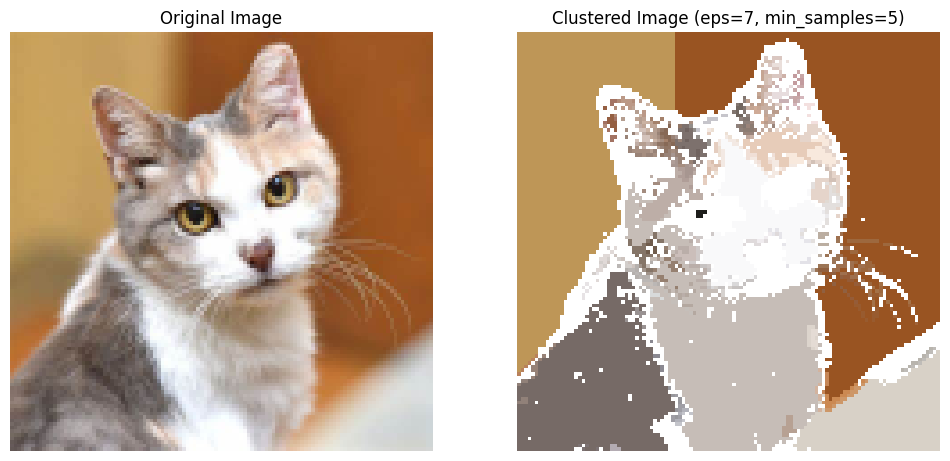

Trying eps=7, min_samples=10
Augmented Space
Silhouette Score (eps=7, min_samples=10): -0.1923237851953402
Calinski-Harabasz Score (eps=7, min_samples=10): 626.6703721889264
Davies-Bouldin Score (eps=7, min_samples=10): 1.417693953921412


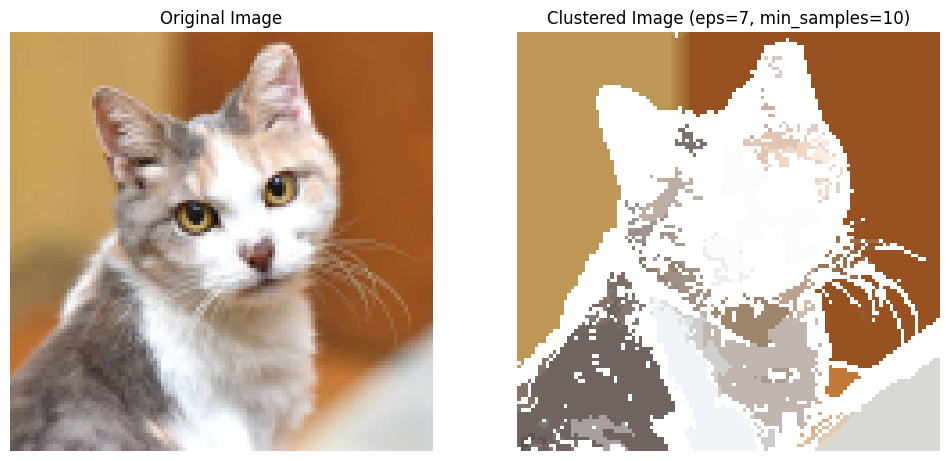

Trying eps=7, min_samples=15
Augmented Space
Silhouette Score (eps=7, min_samples=15): -0.11920112300843755
Calinski-Harabasz Score (eps=7, min_samples=15): 743.8564296603176
Davies-Bouldin Score (eps=7, min_samples=15): 1.5016570190950058


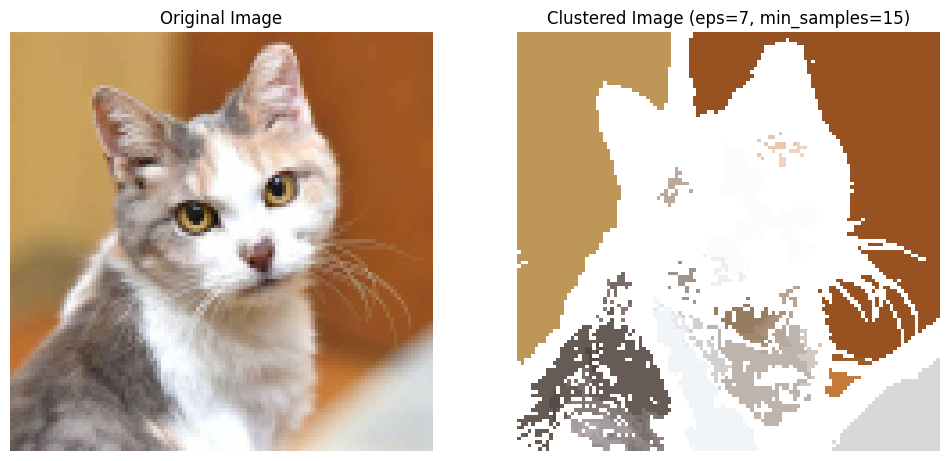

In [ ]:
import cv2
import numpy as np
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
import matplotlib.pyplot as plt

def dbscan_on_image_rgb(image, eps, min_samples):
    # Convert BGR to RGB
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Get the height and width of the image
    height, width = image_rgb.shape[:2]

    # Initialize an array to hold the augmented pixel data
    augmented_pixels = []

    # Loop over each pixel and append the x-y coordinates to its RGB values
    for y in range(height):
        for x in range(width):
            r, g, b = image_rgb[y, x]
            augmented_pixels.append([r, g, b, x, y])

    # Convert to numpy array for DBSCAN
    augmented_pixels = np.array(augmented_pixels)

    # DBSCAN clustering
    dbscan = DBSCAN(eps=eps, min_samples=min_samples).fit(augmented_pixels)

    # Get labels for each pixel
    labels = dbscan.labels_
    unique_labels = set(labels)
    unique_labels.discard(-1)
    n_clusters = len(unique_labels)

    # Initialize sum of colors for each cluster and pixel counts
    cluster_sums = np.zeros((n_clusters, 3), np.float64)
    cluster_counts = np.zeros(n_clusters, np.float64)

    # Sum up the pixel colors for each cluster
    for pixel, label in zip(augmented_pixels, labels):
        if label != -1:  # Ignore noise points
            cluster_sums[label] += pixel[:3]
            cluster_counts[label] += 1

    # Calculate the average color of each cluster
    for i in range(n_clusters):
        if cluster_counts[i] > 0:
            cluster_sums[i] /= cluster_counts[i]

    # Assign the average color to each pixel in the cluster
    clustered_pixels = np.zeros_like(image_rgb)
    index = 0
    for y in range(height):
        for x in range(width):
            label = labels[index]
            if label != -1:  # Ignore noise points
                clustered_pixels[y, x] = cluster_sums[label]
            else:
                clustered_pixels[y, x] = [255, 255, 255]
            index += 1

    # Return the clustered image, augmented pixels, labels, and number of clusters
    return clustered_pixels, augmented_pixels, labels, n_clusters

# Path to the image file
image_path = '/content/cat.jpeg'
original_image = cv2.imread(image_path)

if original_image is None:
    print(f"Image not found at {image_path}")
else:
    # Resize the image more if necessary
    resized_image = cv2.resize(original_image, (0, 0), fx=0.25, fy=0.25, interpolation=cv2.INTER_AREA)

    # Define the hyperparameters for DBSCAN
    eps_values = [3, 5, 7]
    min_samples_values = [5, 10, 15]

    # Apply DBSCAN with different hyperparameters
    for eps_val in eps_values:
        for min_samples_val in min_samples_values:
            print(f"Trying eps={eps_val}, min_samples={min_samples_val}")
            clustered_image, augmented_pixels, labels, n_clusters = dbscan_on_image_rgb(resized_image, eps_val, min_samples_val)

            # Only compute the metrics if there are clusters found
            if n_clusters > 1:
                silhouette_score_val = silhouette_score(augmented_pixels, labels)
                calinski_harabasz_score_val = calinski_harabasz_score(augmented_pixels, labels)
                davies_bouldin_score_val = davies_bouldin_score(augmented_pixels, labels)
            else:
                silhouette_score_val = None
                calinski_harabasz_score_val = None
                davies_bouldin_score_val = None

            # Print the evaluation scores
            print("================================================================================")
            print("Augmented Space")
            print(f"Silhouette Score (eps={eps_val}, min_samples={min_samples_val}):", silhouette_score_val)
            print(f"Calinski-Harabasz Score (eps={eps_val}, min_samples={min_samples_val}):", calinski_harabasz_score_val)
            print(f"Davies-Bouldin Score (eps={eps_val}, min_samples={min_samples_val}):", davies_bouldin_score_val)
            print("================================================================================")

            # Display the original and clustered images
            plt.figure(figsize=(12, 6))
            plt.subplot(121), plt.imshow(cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB))
            plt.title('Original Image'), plt.axis('off')
            plt.subplot(122), plt.imshow(clustered_image)
            plt.title(f'Clustered Image (eps={eps_val}, min_samples={min_samples_val})'), plt.axis('off')
            plt.show()


Trying eps=3, min_samples=5
Augmented Space
Silhouette Score (eps=3, min_samples=5): -0.3555821696967714
Calinski-Harabasz Score (eps=3, min_samples=5): 59.65992369736464
Davies-Bouldin Score (eps=3, min_samples=5): 1.4334199436611819


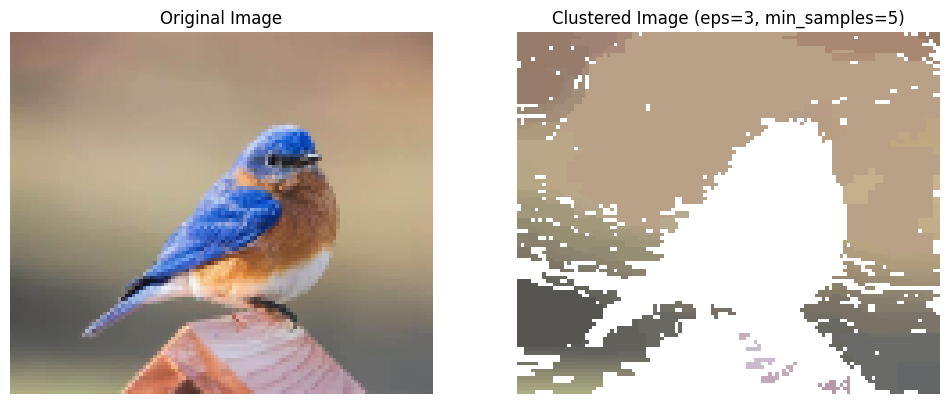

Trying eps=3, min_samples=10
Augmented Space
Silhouette Score (eps=3, min_samples=10): -0.3456171534548866
Calinski-Harabasz Score (eps=3, min_samples=10): 77.0524966405691
Davies-Bouldin Score (eps=3, min_samples=10): 1.235810156220686


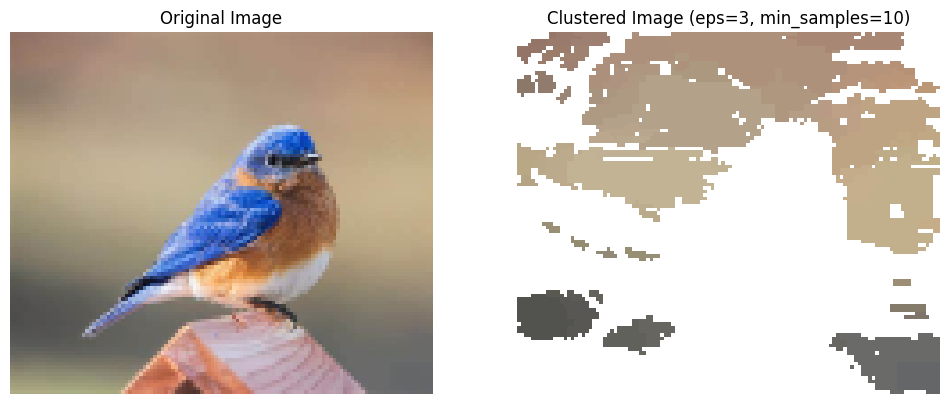

Trying eps=3, min_samples=15
Augmented Space
Silhouette Score (eps=3, min_samples=15): -0.38588008170934834
Calinski-Harabasz Score (eps=3, min_samples=15): 54.78347291106786
Davies-Bouldin Score (eps=3, min_samples=15): 1.232282452256966


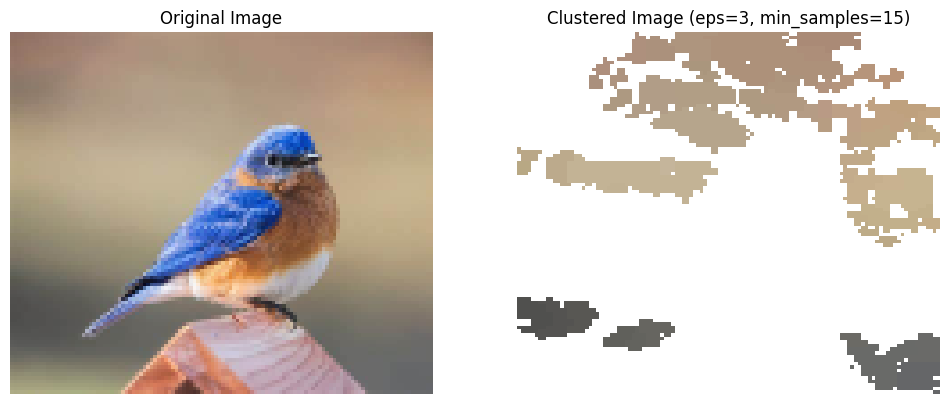

Trying eps=5, min_samples=5
Augmented Space
Silhouette Score (eps=5, min_samples=5): -0.423566689675431
Calinski-Harabasz Score (eps=5, min_samples=5): 40.59059210968977
Davies-Bouldin Score (eps=5, min_samples=5): 1.4619119161657173


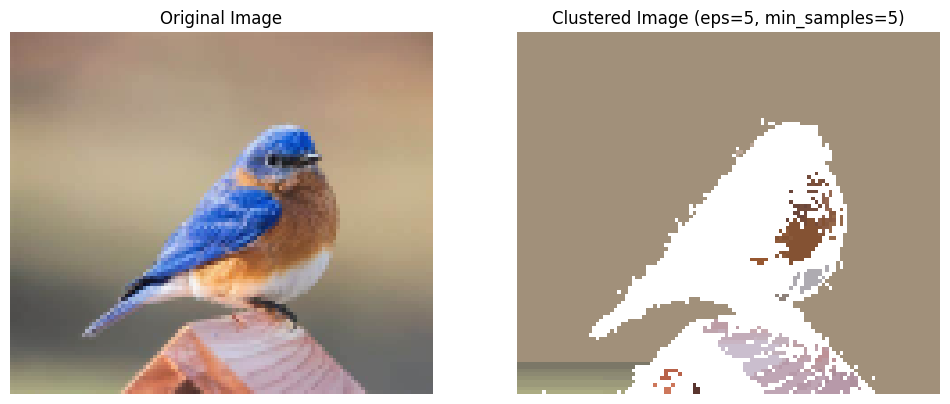

Trying eps=5, min_samples=10
Augmented Space
Silhouette Score (eps=5, min_samples=10): -0.192664684371572
Calinski-Harabasz Score (eps=5, min_samples=10): 127.68882234729485
Davies-Bouldin Score (eps=5, min_samples=10): 1.4217980182196903


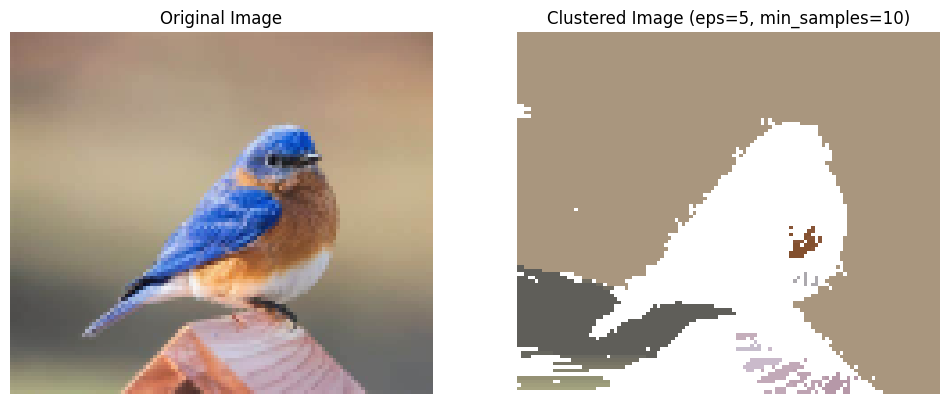

Trying eps=5, min_samples=15
Augmented Space
Silhouette Score (eps=5, min_samples=15): -0.07260018808425324
Calinski-Harabasz Score (eps=5, min_samples=15): 515.9759313406436
Davies-Bouldin Score (eps=5, min_samples=15): 1.4440652842221684


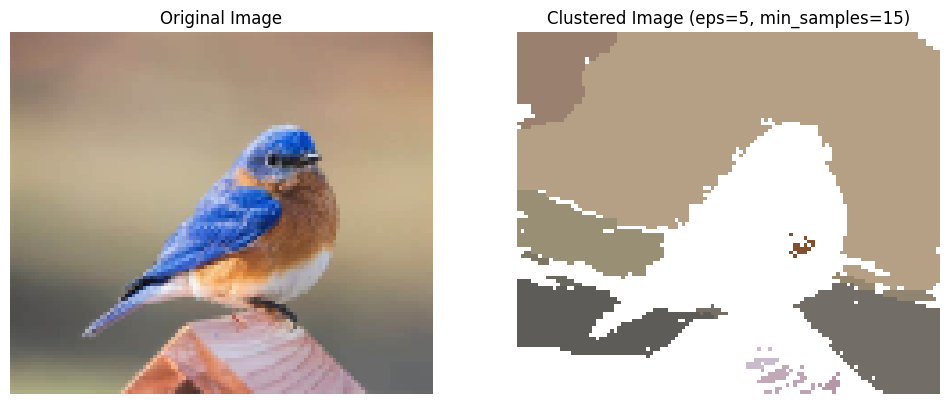

Trying eps=7, min_samples=5
Augmented Space
Silhouette Score (eps=7, min_samples=5): -0.3276298993587732
Calinski-Harabasz Score (eps=7, min_samples=5): 59.00573366335204
Davies-Bouldin Score (eps=7, min_samples=5): 1.375901789057468


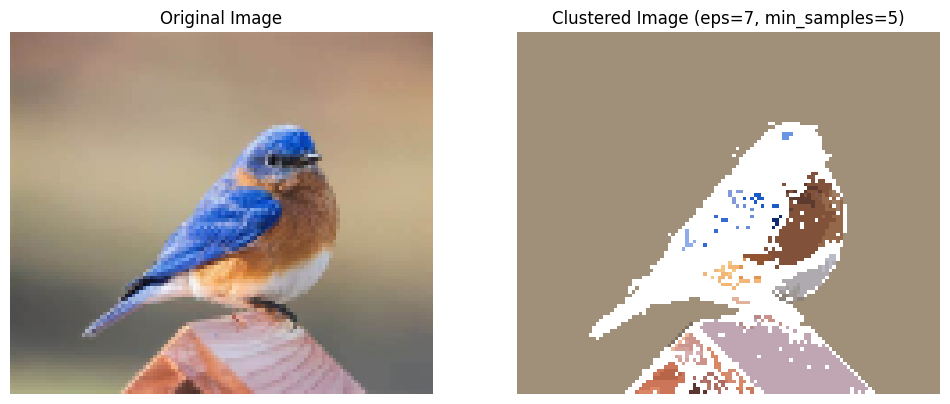

Trying eps=7, min_samples=10
Augmented Space
Silhouette Score (eps=7, min_samples=10): -0.21261344098997567
Calinski-Harabasz Score (eps=7, min_samples=10): 137.76466614819407
Davies-Bouldin Score (eps=7, min_samples=10): 1.6979583272113823


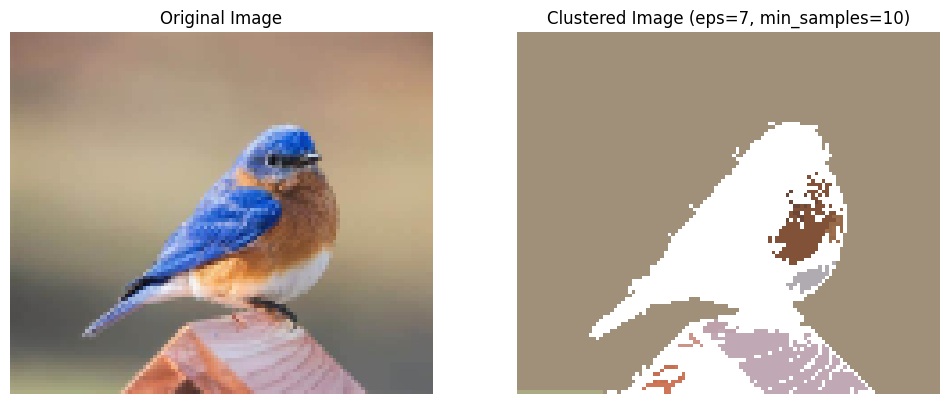

Trying eps=7, min_samples=15
Augmented Space
Silhouette Score (eps=7, min_samples=15): -0.2196387132205768
Calinski-Harabasz Score (eps=7, min_samples=15): 115.46222802089737
Davies-Bouldin Score (eps=7, min_samples=15): 1.7442319136400102


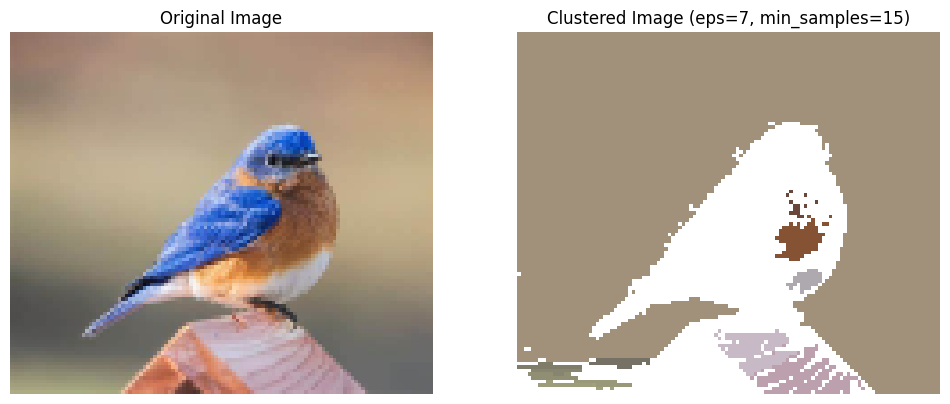

In [ ]:
import cv2
import numpy as np
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
import matplotlib.pyplot as plt

def dbscan_on_image_rgb(image, eps, min_samples):
    # Convert BGR to RGB
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Get the height and width of the image
    height, width = image_rgb.shape[:2]

    # Initialize an array to hold the augmented pixel data
    augmented_pixels = []

    # Loop over each pixel and append the x-y coordinates to its RGB values
    for y in range(height):
        for x in range(width):
            r, g, b = image_rgb[y, x]
            augmented_pixels.append([r, g, b, x, y])

    # Convert to numpy array for DBSCAN
    augmented_pixels = np.array(augmented_pixels)

    # DBSCAN clustering
    dbscan = DBSCAN(eps=eps, min_samples=min_samples).fit(augmented_pixels)

    # Get labels for each pixel
    labels = dbscan.labels_
    unique_labels = set(labels)
    unique_labels.discard(-1)
    n_clusters = len(unique_labels)

    # Initialize sum of colors for each cluster and pixel counts
    cluster_sums = np.zeros((n_clusters, 3), np.float64)
    cluster_counts = np.zeros(n_clusters, np.float64)

    # Sum up the pixel colors for each cluster
    for pixel, label in zip(augmented_pixels, labels):
        if label != -1:  # Ignore noise points
            cluster_sums[label] += pixel[:3]
            cluster_counts[label] += 1

    # Calculate the average color of each cluster
    for i in range(n_clusters):
        if cluster_counts[i] > 0:
            cluster_sums[i] /= cluster_counts[i]

    # Assign the average color to each pixel in the cluster
    clustered_pixels = np.zeros_like(image_rgb)
    index = 0
    for y in range(height):
        for x in range(width):
            label = labels[index]
            if label != -1:  # Ignore noise points
                clustered_pixels[y, x] = cluster_sums[label]
            else:
                clustered_pixels[y, x] = [255, 255, 255]
            index += 1

    # Return the clustered image, augmented pixels, labels, and number of clusters
    return clustered_pixels, augmented_pixels, labels, n_clusters

# Path to the image file
image_path = '/content/bird.jpeg'
original_image = cv2.imread(image_path)

if original_image is None:
    print(f"Image not found at {image_path}")
else:
    # Resize the image more if necessary
    resized_image = cv2.resize(original_image, (0, 0), fx=0.25, fy=0.25, interpolation=cv2.INTER_AREA)

    # Define the hyperparameters for DBSCAN
    eps_values = [3, 5, 7]
    min_samples_values = [5, 10, 15]

    # Apply DBSCAN with different hyperparameters
    for eps_val in eps_values:
        for min_samples_val in min_samples_values:
            print(f"Trying eps={eps_val}, min_samples={min_samples_val}")
            clustered_image, augmented_pixels, labels, n_clusters = dbscan_on_image_rgb(resized_image, eps_val, min_samples_val)

            # Only compute the metrics if there are clusters found
            if n_clusters > 1:
                silhouette_score_val = silhouette_score(augmented_pixels, labels)
                calinski_harabasz_score_val = calinski_harabasz_score(augmented_pixels, labels)
                davies_bouldin_score_val = davies_bouldin_score(augmented_pixels, labels)
            else:
                silhouette_score_val = None
                calinski_harabasz_score_val = None
                davies_bouldin_score_val = None

            # Print the evaluation scores
            print("================================================================================")
            print("Augmented Space")
            print(f"Silhouette Score (eps={eps_val}, min_samples={min_samples_val}):", silhouette_score_val)
            print(f"Calinski-Harabasz Score (eps={eps_val}, min_samples={min_samples_val}):", calinski_harabasz_score_val)
            print(f"Davies-Bouldin Score (eps={eps_val}, min_samples={min_samples_val}):", davies_bouldin_score_val)
            print("================================================================================")

            # Display the original and clustered images
            plt.figure(figsize=(12, 6))
            plt.subplot(121), plt.imshow(cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB))
            plt.title('Original Image'), plt.axis('off')
            plt.subplot(122), plt.imshow(clustered_image)
            plt.title(f'Clustered Image (eps={eps_val}, min_samples={min_samples_val})'), plt.axis('off')
            plt.show()


Trying eps=3, min_samples=5
Augmented Space
Silhouette Score (eps=3, min_samples=5): -0.6950253916516225
Calinski-Harabasz Score (eps=3, min_samples=5): 7.560880897756679
Davies-Bouldin Score (eps=3, min_samples=5): 0.9742484595249804


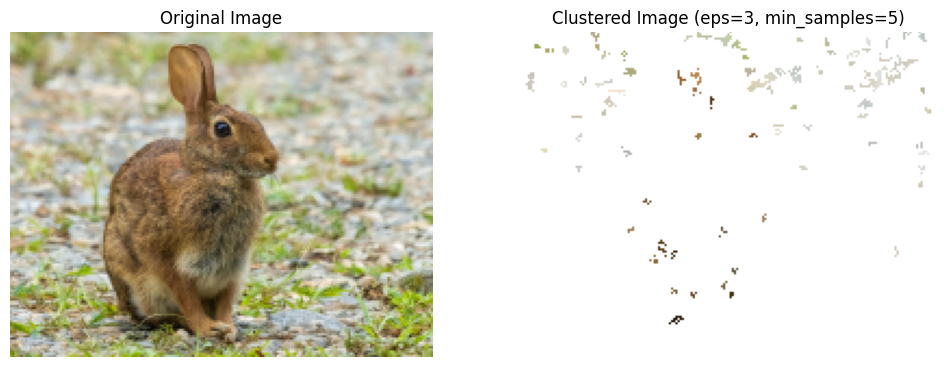

Trying eps=3, min_samples=10
Augmented Space
Silhouette Score (eps=3, min_samples=10): None
Calinski-Harabasz Score (eps=3, min_samples=10): None
Davies-Bouldin Score (eps=3, min_samples=10): None


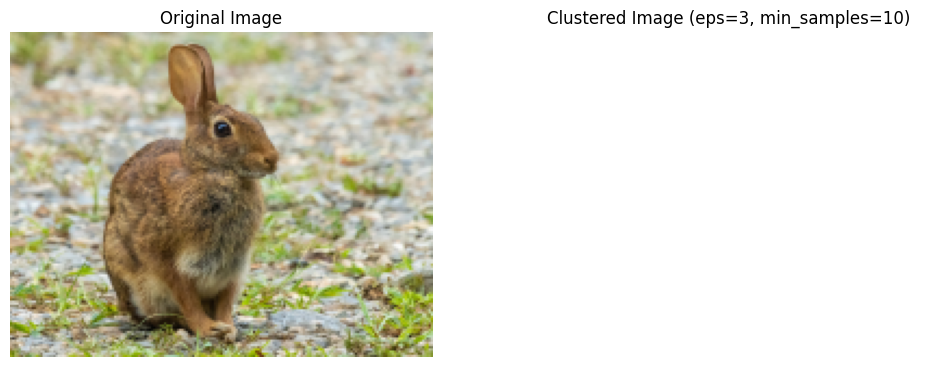

Trying eps=3, min_samples=15
Augmented Space
Silhouette Score (eps=3, min_samples=15): None
Calinski-Harabasz Score (eps=3, min_samples=15): None
Davies-Bouldin Score (eps=3, min_samples=15): None


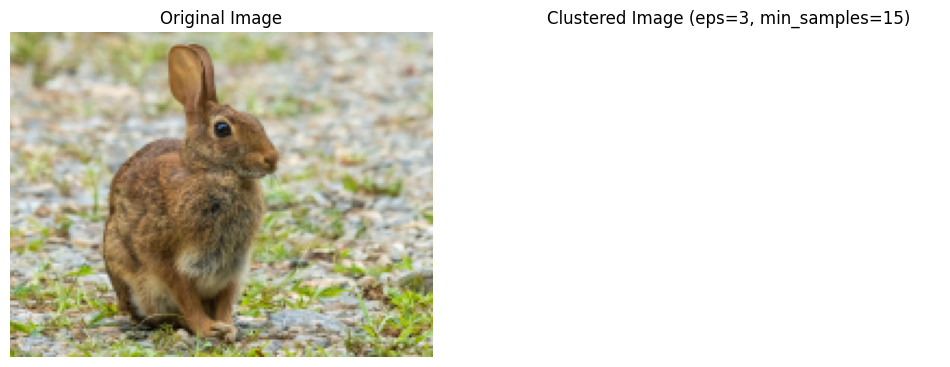

Trying eps=5, min_samples=5
Augmented Space
Silhouette Score (eps=5, min_samples=5): -0.4748627533417827
Calinski-Harabasz Score (eps=5, min_samples=5): 22.184616199074163
Davies-Bouldin Score (eps=5, min_samples=5): 1.0678839185597213


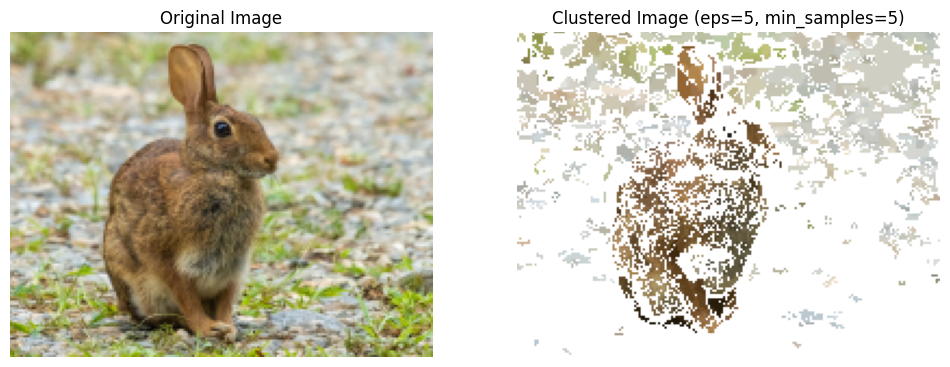

Trying eps=5, min_samples=10
Augmented Space
Silhouette Score (eps=5, min_samples=10): -0.5953181073617755
Calinski-Harabasz Score (eps=5, min_samples=10): 24.84916828941317
Davies-Bouldin Score (eps=5, min_samples=10): 0.9681514785332223


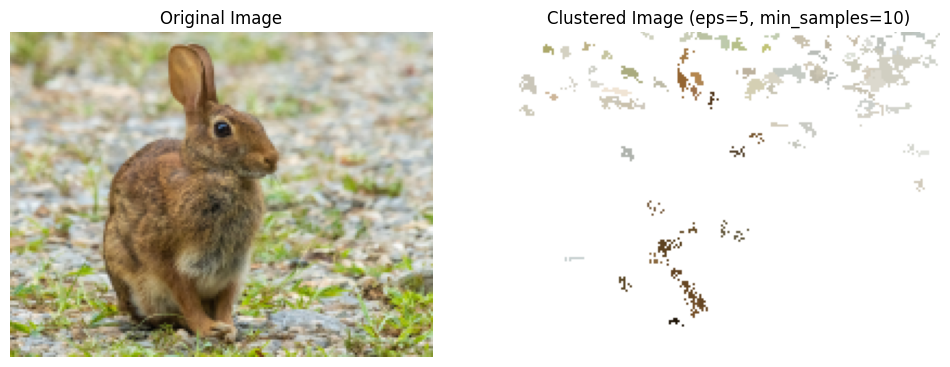

Trying eps=5, min_samples=15
Augmented Space
Silhouette Score (eps=5, min_samples=15): -0.49182741233137184
Calinski-Harabasz Score (eps=5, min_samples=15): 27.450455779789916
Davies-Bouldin Score (eps=5, min_samples=15): 1.1322812160928597


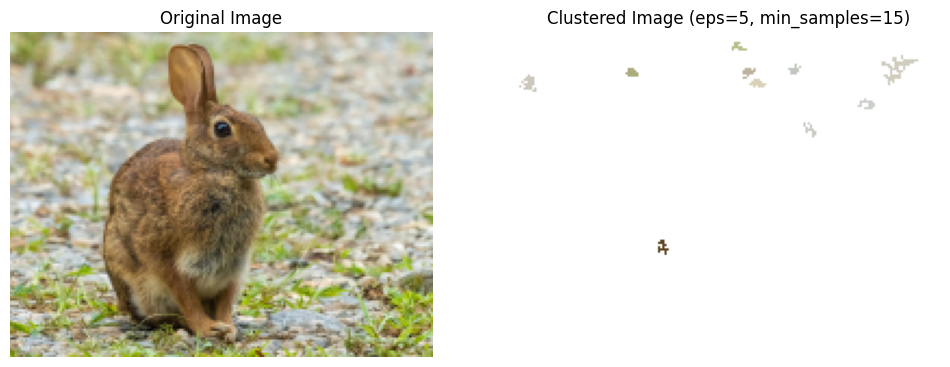

Trying eps=7, min_samples=5
Augmented Space
Silhouette Score (eps=7, min_samples=5): -0.4986880966471935
Calinski-Harabasz Score (eps=7, min_samples=5): 87.19554472416175
Davies-Bouldin Score (eps=7, min_samples=5): 1.2473455402923874


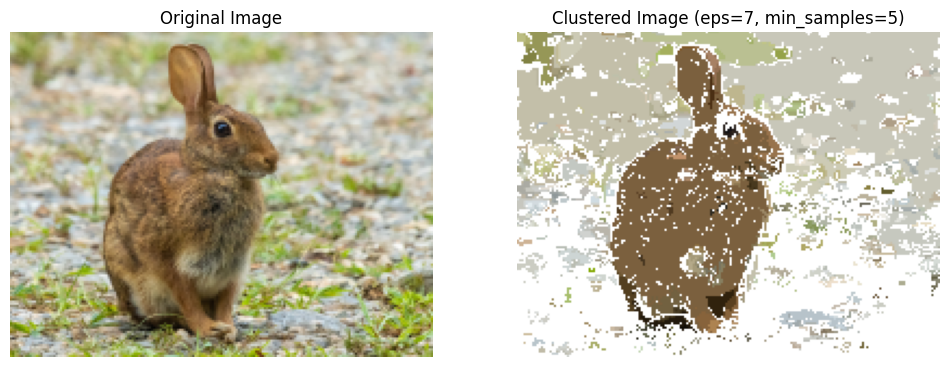

Trying eps=7, min_samples=10
Augmented Space
Silhouette Score (eps=7, min_samples=10): -0.483627543501564
Calinski-Harabasz Score (eps=7, min_samples=10): 80.33117807243018
Davies-Bouldin Score (eps=7, min_samples=10): 1.170045765217536


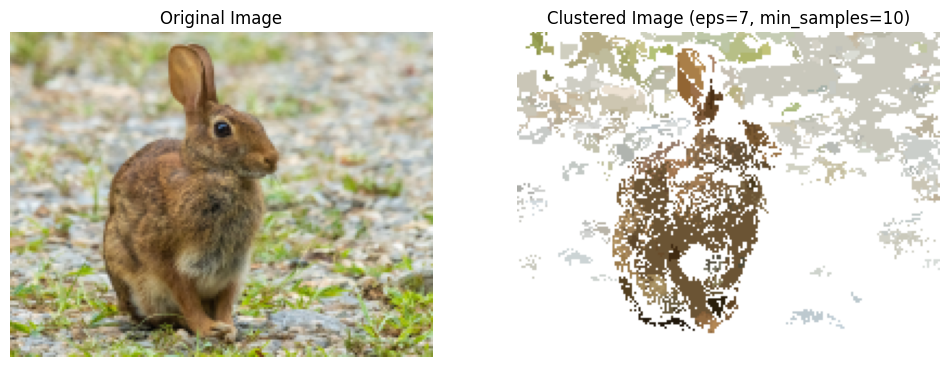

Trying eps=7, min_samples=15
Augmented Space
Silhouette Score (eps=7, min_samples=15): -0.5654878352768042
Calinski-Harabasz Score (eps=7, min_samples=15): 61.30263184822274
Davies-Bouldin Score (eps=7, min_samples=15): 1.1083561423638626


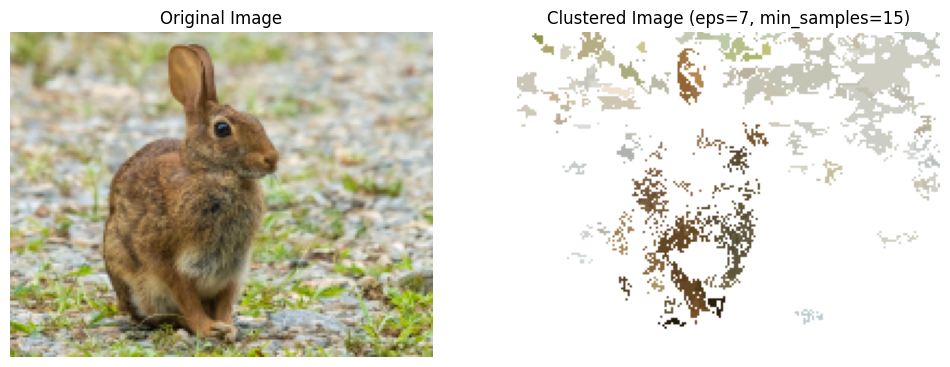

In [ ]:
import cv2
import numpy as np
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
import matplotlib.pyplot as plt

def dbscan_on_image_rgb(image, eps, min_samples):
    # Convert BGR to RGB
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Get the height and width of the image
    height, width = image_rgb.shape[:2]

    # Initialize an array to hold the augmented pixel data
    augmented_pixels = []

    # Loop over each pixel and append the x-y coordinates to its RGB values
    for y in range(height):
        for x in range(width):
            r, g, b = image_rgb[y, x]
            augmented_pixels.append([r, g, b, x, y])

    # Convert to numpy array for DBSCAN
    augmented_pixels = np.array(augmented_pixels)

    # DBSCAN clustering
    dbscan = DBSCAN(eps=eps, min_samples=min_samples).fit(augmented_pixels)

    # Get labels for each pixel
    labels = dbscan.labels_
    unique_labels = set(labels)
    unique_labels.discard(-1)
    n_clusters = len(unique_labels)

    # Initialize sum of colors for each cluster and pixel counts
    cluster_sums = np.zeros((n_clusters, 3), np.float64)
    cluster_counts = np.zeros(n_clusters, np.float64)

    # Sum up the pixel colors for each cluster
    for pixel, label in zip(augmented_pixels, labels):
        if label != -1:  # Ignore noise points
            cluster_sums[label] += pixel[:3]
            cluster_counts[label] += 1

    # Calculate the average color of each cluster
    for i in range(n_clusters):
        if cluster_counts[i] > 0:
            cluster_sums[i] /= cluster_counts[i]

    # Assign the average color to each pixel in the cluster
    clustered_pixels = np.zeros_like(image_rgb)
    index = 0
    for y in range(height):
        for x in range(width):
            label = labels[index]
            if label != -1:  # Ignore noise points
                clustered_pixels[y, x] = cluster_sums[label]
            else:
                clustered_pixels[y, x] = [255, 255, 255]
            index += 1

    # Return the clustered image, augmented pixels, labels, and number of clusters
    return clustered_pixels, augmented_pixels, labels, n_clusters

# Path to the image file
image_path = '/content/rabbit.jpg'
original_image = cv2.imread(image_path)

if original_image is None:
    print(f"Image not found at {image_path}")
else:
    # Resize the image more if necessary
    resized_image = cv2.resize(original_image, (0, 0), fx=0.25, fy=0.25, interpolation=cv2.INTER_AREA)

    # Define the hyperparameters for DBSCAN
    eps_values = [3, 5, 7]
    min_samples_values = [5, 10, 15]

    # Apply DBSCAN with different hyperparameters
    for eps_val in eps_values:
        for min_samples_val in min_samples_values:
            print(f"Trying eps={eps_val}, min_samples={min_samples_val}")
            clustered_image, augmented_pixels, labels, n_clusters = dbscan_on_image_rgb(resized_image, eps_val, min_samples_val)

            # Only compute the metrics if there are clusters found
            if n_clusters > 1:
                silhouette_score_val = silhouette_score(augmented_pixels, labels)
                calinski_harabasz_score_val = calinski_harabasz_score(augmented_pixels, labels)
                davies_bouldin_score_val = davies_bouldin_score(augmented_pixels, labels)
            else:
                silhouette_score_val = None
                calinski_harabasz_score_val = None
                davies_bouldin_score_val = None

            # Print the evaluation scores
            print("================================================================================")
            print("Augmented Space")
            print(f"Silhouette Score (eps={eps_val}, min_samples={min_samples_val}):", silhouette_score_val)
            print(f"Calinski-Harabasz Score (eps={eps_val}, min_samples={min_samples_val}):", calinski_harabasz_score_val)
            print(f"Davies-Bouldin Score (eps={eps_val}, min_samples={min_samples_val}):", davies_bouldin_score_val)
            print("================================================================================")

            # Display the original and clustered images
            plt.figure(figsize=(12, 6))
            plt.subplot(121), plt.imshow(cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB))
            plt.title('Original Image'), plt.axis('off')
            plt.subplot(122), plt.imshow(clustered_image)
            plt.title(f'Clustered Image (eps={eps_val}, min_samples={min_samples_val})'), plt.axis('off')
            plt.show()


In training using DBSCAN with different parameter combinations in the augmented space, we observed varying results. When we adjusted the eps (density parameter) and min_samples (minimum number of data points) values, the clustering quality changed. For example, smaller eps and min_samples values led to lower Silhouette Scores, indicating poorly separated clusters. Conversely, larger min_samples values generally improved the clustering quality, resulting in higher Silhouette Scores and Calinski-Harabasz Scores, indicating better-defined and more compact clusters. The Davies-Bouldin Score also provided insights into the similarity between clusters.

***Standarization Space***

Trying eps=0.1, min_samples=5
Std Space
Silhouette Coefficient: -0.566
Calinski-Harabasz Index: 35.051
Davies-Bouldin Index: 1.968


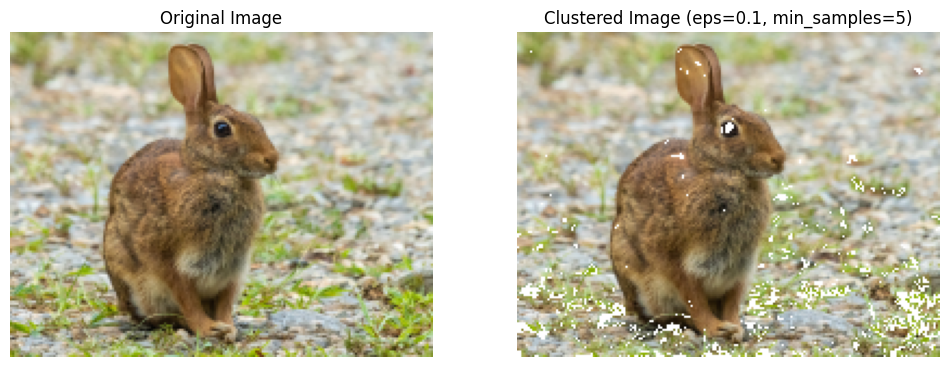

Trying eps=0.1, min_samples=10
Std Space
Silhouette Coefficient: -0.421
Calinski-Harabasz Index: 198.324
Davies-Bouldin Index: 1.910


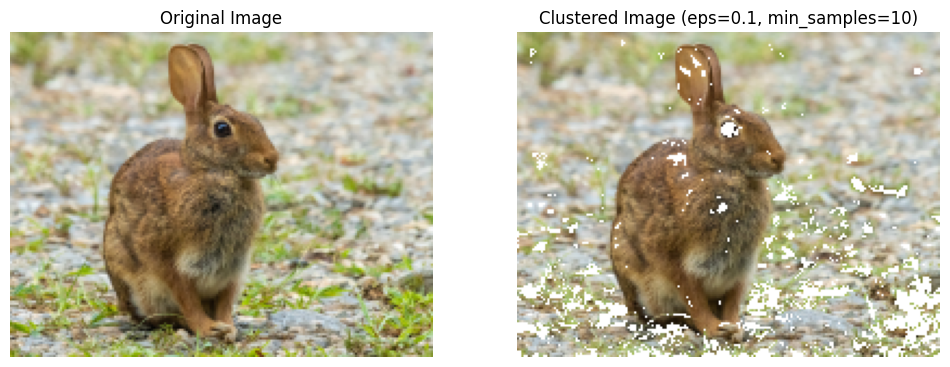

Trying eps=0.1, min_samples=15
Std Space
Silhouette Coefficient: -0.445
Calinski-Harabasz Index: 305.952
Davies-Bouldin Index: 2.697


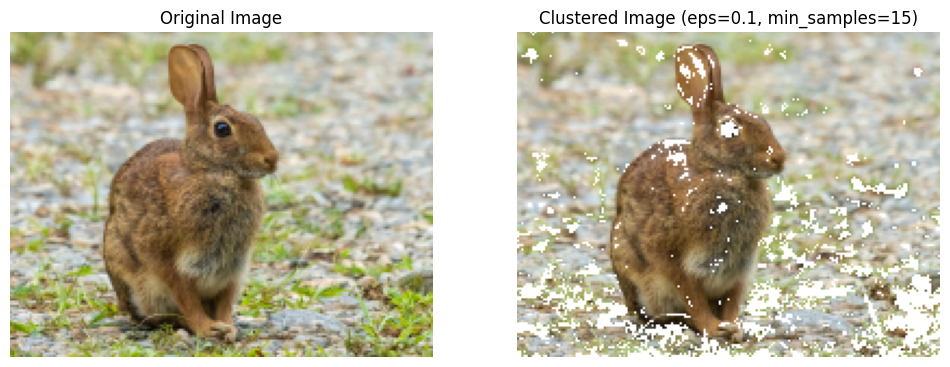

Trying eps=0.2, min_samples=5
Std Space
Silhouette Coefficient: -0.076
Calinski-Harabasz Index: 25.685
Davies-Bouldin Index: 1.851


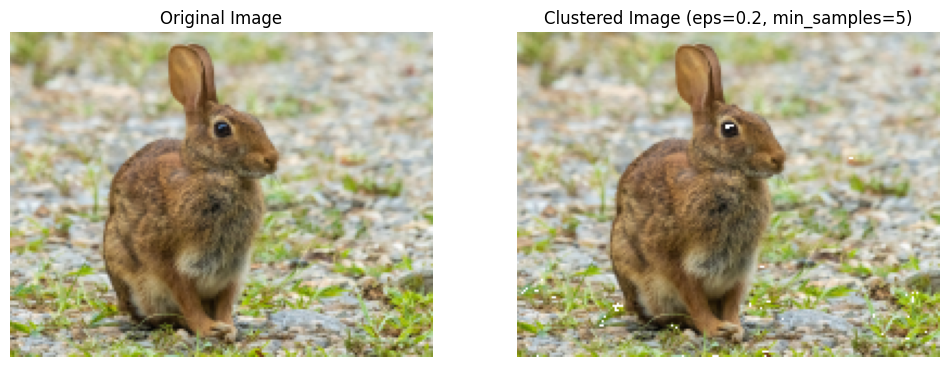

Trying eps=0.2, min_samples=10
Std Space
Silhouette Coefficient: 0.215
Calinski-Harabasz Index: 163.314
Davies-Bouldin Index: 1.754


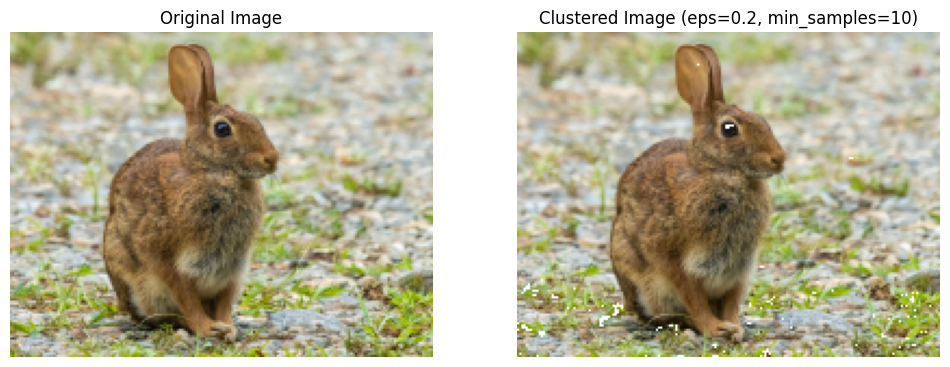

Trying eps=0.2, min_samples=15
Std Space
Silhouette Coefficient: 0.222
Calinski-Harabasz Index: 262.697
Davies-Bouldin Index: 1.756


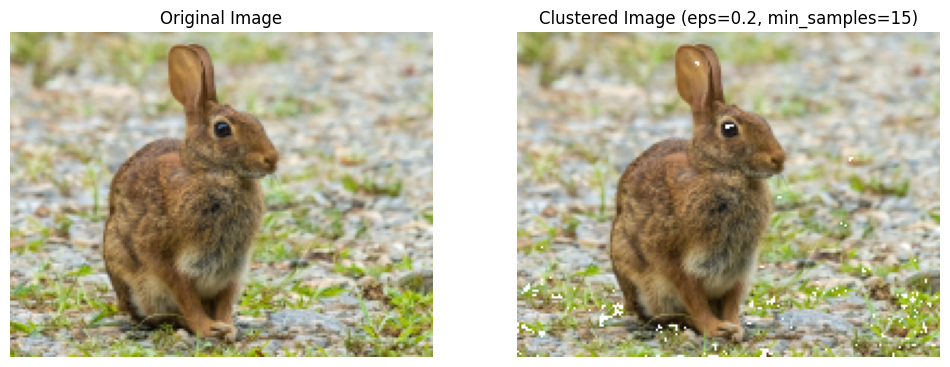

Trying eps=0.5, min_samples=5
Std Space
Silhouette Coefficient: 0.231
Calinski-Harabasz Index: 6.703
Davies-Bouldin Index: 0.866


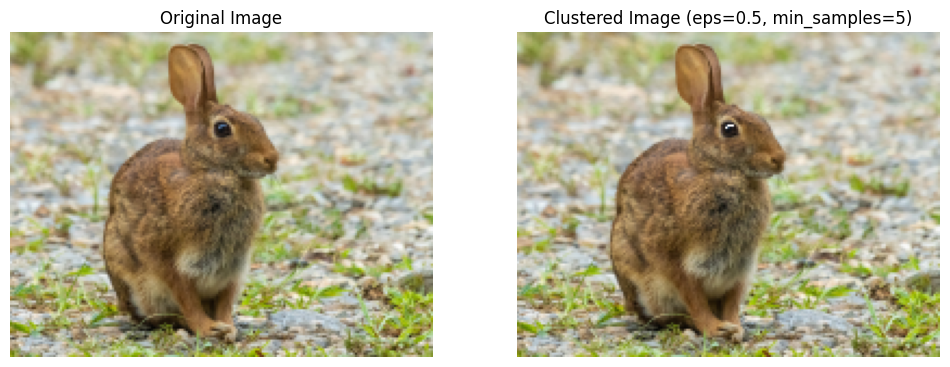

Trying eps=0.5, min_samples=10
Std Space
Silhouette Coefficient: 0.263
Calinski-Harabasz Index: 9.930
Davies-Bouldin Index: 0.896


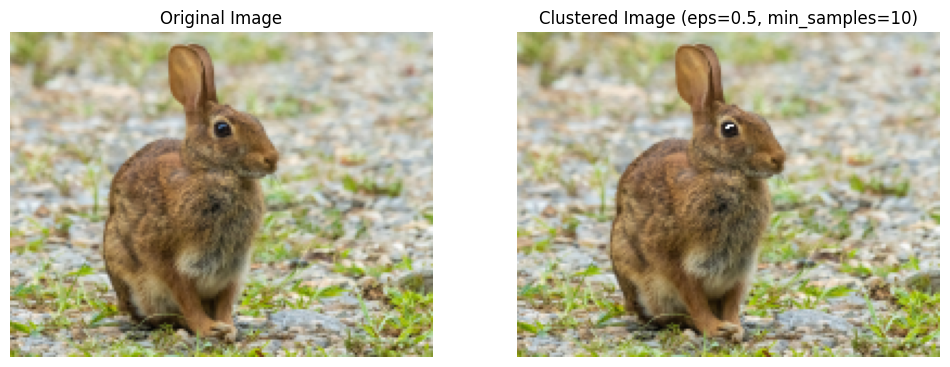

Trying eps=0.5, min_samples=15
Std Space
Silhouette Coefficient: 0.263
Calinski-Harabasz Index: 9.930
Davies-Bouldin Index: 0.896


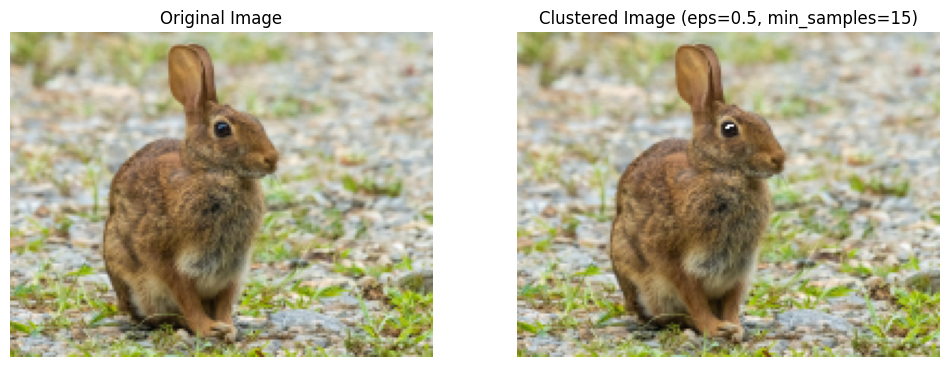

In [ ]:
import cv2
import numpy as np
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
import matplotlib.pyplot as plt

def dbscan_on_image_rgb(image, eps, min_samples):
    # Convert BGR to RGB
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Reshape the image to a 2D array of RGB values
    pixels = image_rgb.reshape(-1, 3)

    # Standardize the RGB values
    scaler = StandardScaler()
    pixels_standardized = scaler.fit_transform(pixels)

    # DBSCAN clustering
    dbscan = DBSCAN(eps=eps, min_samples=min_samples).fit(pixels_standardized)

    # Get labels for each pixel
    labels = dbscan.labels_

    # Inverse transform to get original colors
    pixels_original_colorspace = scaler.inverse_transform(pixels_standardized).astype(np.uint8)

    # Assign the original color to each pixel in the image
    clustered_pixels = np.zeros_like(pixels)
    for i, label in enumerate(labels):
        if label != -1:
            clustered_pixels[i] = pixels_original_colorspace[i]
        else:
            clustered_pixels[i] = [255, 255, 255]

    # Reshape clustered_pixels back to the original image shape
    clustered_image = clustered_pixels.reshape(image_rgb.shape)

    # Return the clustered image and labels
    return clustered_image, labels

# Load and preprocess the image
image_path = '/content/rabbit.jpg'
original_image = cv2.imread(image_path)

if original_image is None:
    print(f"Image not found at {image_path}")
else:
    # Resize the image more if necessary
    resized_image = cv2.resize(original_image, (0, 0), fx=0.25, fy=0.25, interpolation=cv2.INTER_AREA)

    # Define the hyperparameters for DBSCAN
    eps_values = [0.1, 0.2, 0.5]
    min_samples_values = [5, 10, 15]

    # Apply DBSCAN with different hyperparameters
    for eps_val in eps_values:
        for min_samples_val in min_samples_values:
            print(f"Trying eps={eps_val}, min_samples={min_samples_val}")
            clustered_image, labels = dbscan_on_image_rgb(resized_image, eps_val, min_samples_val)

            # Evaluate clustering if not all points are considered noise
            if len(set(labels)) > 1:
                silhouette_val = silhouette_score(pixels, labels)
                calinski_harabasz_val = calinski_harabasz_score(pixels, labels)
                davies_bouldin_val = davies_bouldin_score(pixels, labels)

                # Display evaluation metrics
                print("================================================================================")
                print("Std Space")
                print(f"Silhouette Coefficient: {silhouette_val:.3f}")
                print(f"Calinski-Harabasz Index: {calinski_harabasz_val:.3f}")
                print(f"Davies-Bouldin Index: {davies_bouldin_val:.3f}")
                print("================================================================================")

            else:
                print("All points labeled as noise or only one cluster.")

            # Display the original and clustered images
            plt.figure(figsize=(12, 6))
            plt.subplot(121), plt.imshow(cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB))
            plt.title('Original Image'), plt.axis('off')
            plt.subplot(122), plt.imshow(clustered_image)
            plt.title(f'Clustered Image (eps={eps_val}, min_samples={min_samples_val})'), plt.axis('off')
            plt.show()


Trying eps=0.1, min_samples=5
Evaluation Metrics
Silhouette Coefficient: -0.444
Calinski-Harabasz Index: 39.122
Davies-Bouldin Index: 2.133


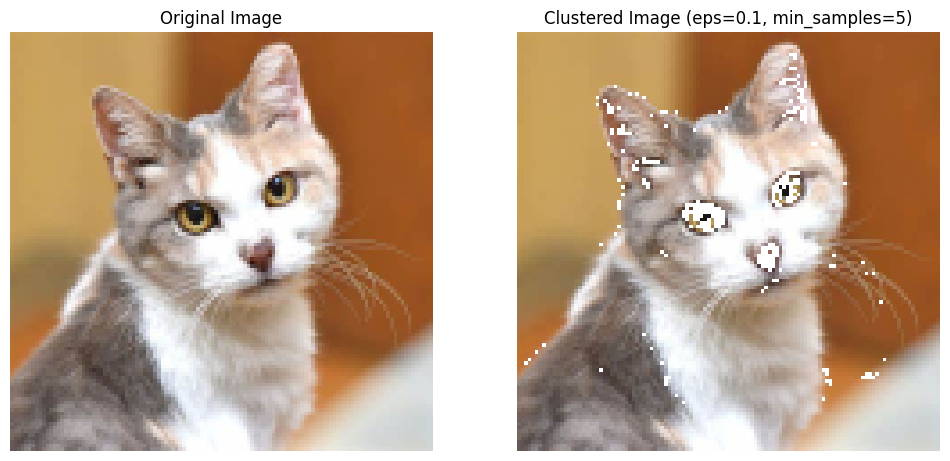

Trying eps=0.1, min_samples=10
Evaluation Metrics
Silhouette Coefficient: -0.275
Calinski-Harabasz Index: 56.547
Davies-Bouldin Index: 3.251


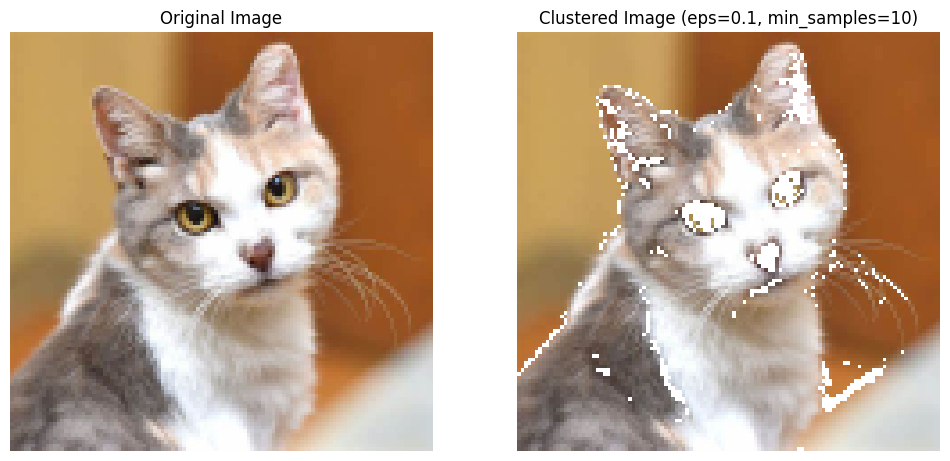

Trying eps=0.1, min_samples=15
Evaluation Metrics
Silhouette Coefficient: -0.512
Calinski-Harabasz Index: 29.716
Davies-Bouldin Index: 3.566


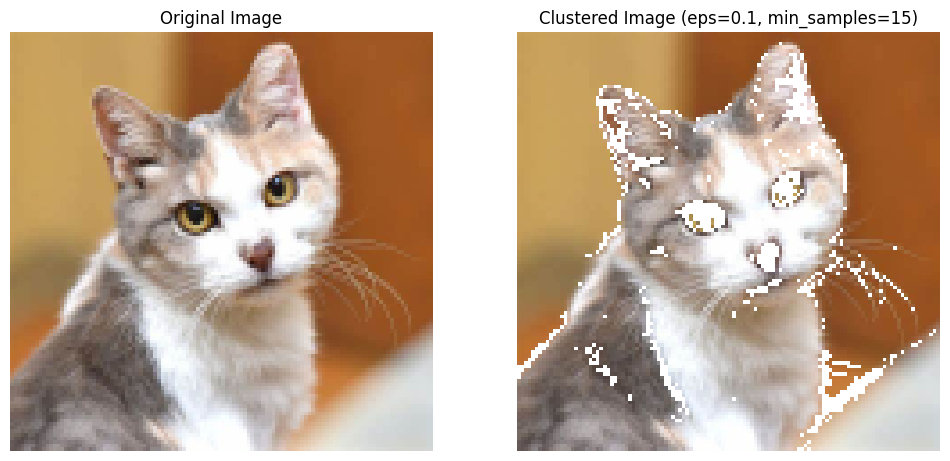

Trying eps=0.2, min_samples=5
Evaluation Metrics
Silhouette Coefficient: 0.134
Calinski-Harabasz Index: 36.883
Davies-Bouldin Index: 1.171


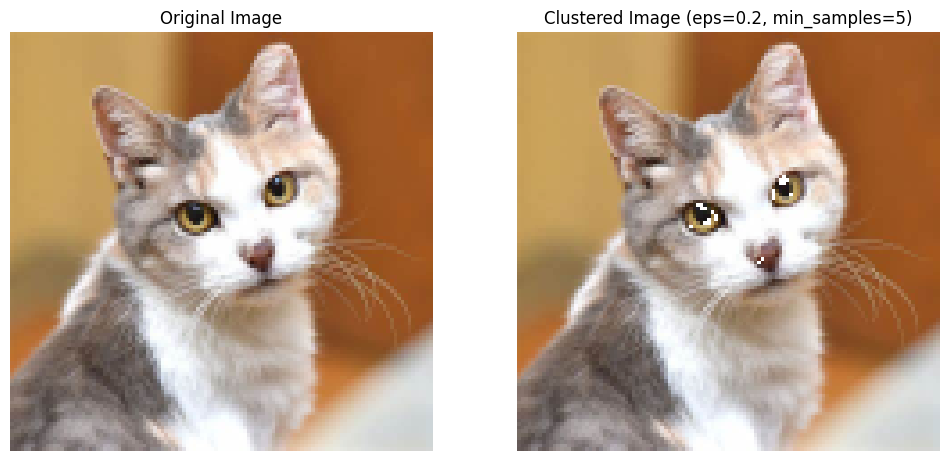

Trying eps=0.2, min_samples=10
Evaluation Metrics
Silhouette Coefficient: 0.211
Calinski-Harabasz Index: 107.910
Davies-Bouldin Index: 1.030


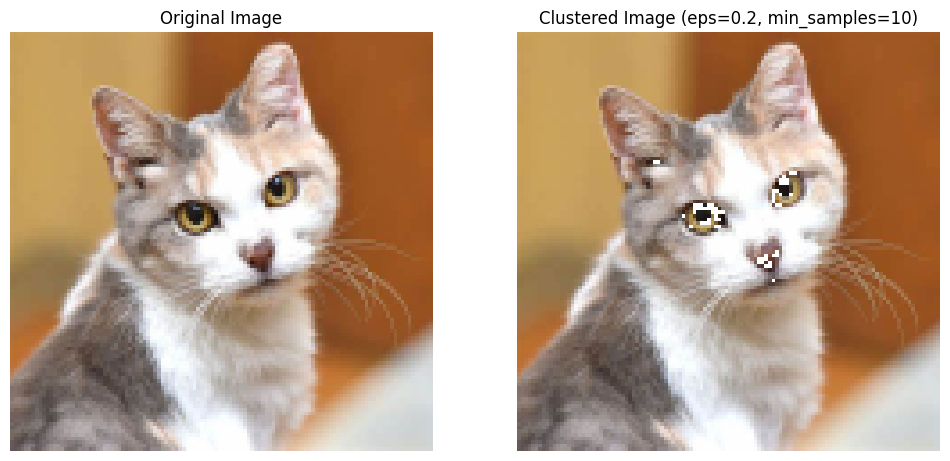

Trying eps=0.2, min_samples=15
Evaluation Metrics
Silhouette Coefficient: 0.227
Calinski-Harabasz Index: 164.812
Davies-Bouldin Index: 0.836


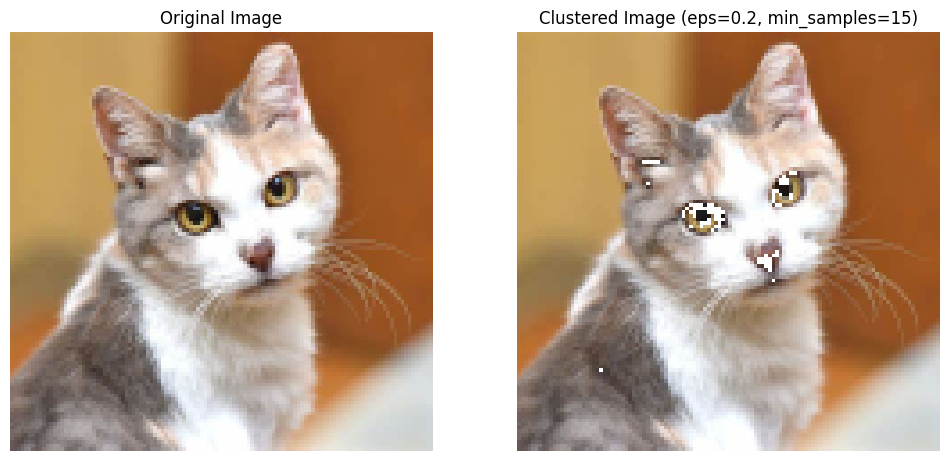

Trying eps=0.5, min_samples=5
Evaluation Metrics
Silhouette Coefficient: 0.068
Calinski-Harabasz Index: 1.049
Davies-Bouldin Index: 0.863


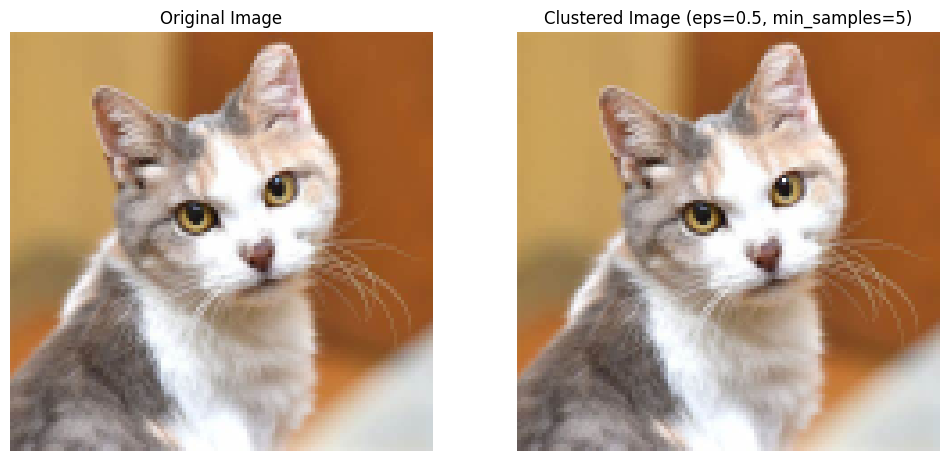

Trying eps=0.5, min_samples=10
Evaluation Metrics
Silhouette Coefficient: 0.068
Calinski-Harabasz Index: 1.049
Davies-Bouldin Index: 0.863


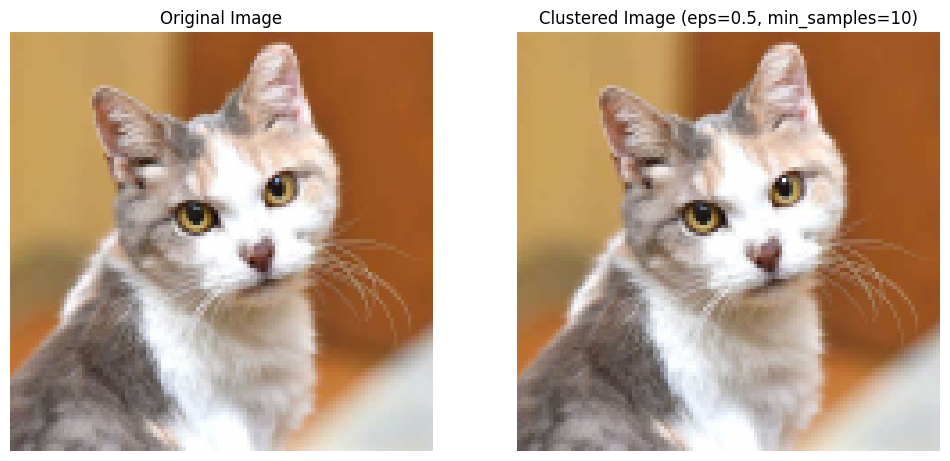

Trying eps=0.5, min_samples=15
Evaluation Metrics
Silhouette Coefficient: 0.068
Calinski-Harabasz Index: 1.049
Davies-Bouldin Index: 0.863


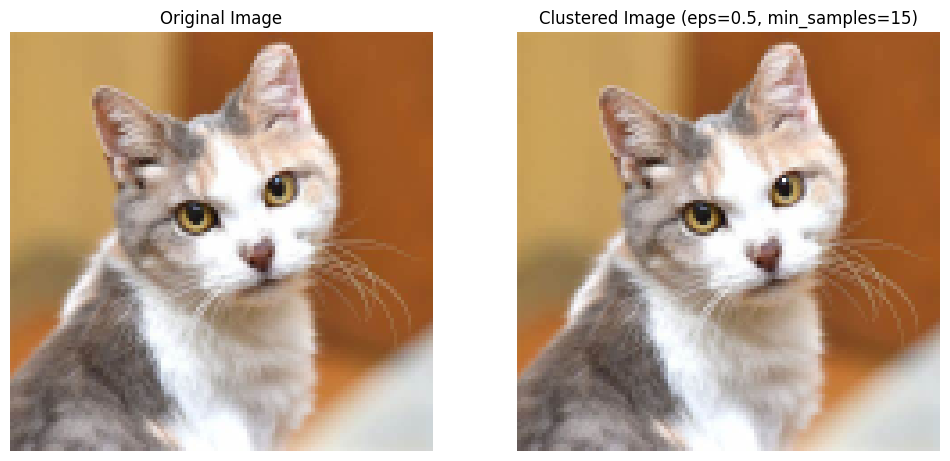

In [ ]:
import cv2
import numpy as np
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
import matplotlib.pyplot as plt

def dbscan_on_image_rgb(image, eps, min_samples):
    # Convert BGR to RGB
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Reshape the image to a 2D array of RGB values
    pixels = image_rgb.reshape(-1, 3)

    # Standardize the RGB values
    scaler = StandardScaler()
    pixels_standardized = scaler.fit_transform(pixels)

    # DBSCAN clustering
    dbscan = DBSCAN(eps=eps, min_samples=min_samples).fit(pixels_standardized)

    # Get labels for each pixel
    labels = dbscan.labels_

    # Inverse transform to get original colors
    pixels_original_colorspace = scaler.inverse_transform(pixels_standardized).astype(np.uint8)

    # Assign the original color to each pixel in the image
    clustered_pixels = np.zeros_like(pixels)
    for i, label in enumerate(labels):
        if label != -1:
            clustered_pixels[i] = pixels_original_colorspace[i]
        else:
            clustered_pixels[i] = [255, 255, 255]  # White for noise points

    # Reshape clustered_pixels back to the original image shape
    clustered_image = clustered_pixels.reshape(image_rgb.shape)

    # Return the clustered image, labels, and the original pixels array
    return clustered_image, labels, pixels

# Load and preprocess the image
image_path = '/content/cat.jpeg'
original_image = cv2.imread(image_path)

if original_image is None:
    print(f"Image not found at {image_path}")
else:
    # Resize the image if necessary
    resized_image = cv2.resize(original_image, (0, 0), fx=0.25, fy=0.25, interpolation=cv2.INTER_AREA)

    # Define the hyperparameters for DBSCAN
    eps_values = [0.1, 0.2, 0.5]
    min_samples_values = [5, 10, 15]

    # Apply DBSCAN with different hyperparameters
    for eps_val in eps_values:
        for min_samples_val in min_samples_values:
            print(f"Trying eps={eps_val}, min_samples={min_samples_val}")
            clustered_image, labels, pixels = dbscan_on_image_rgb(resized_image, eps_val, min_samples_val)

            # Evaluate clustering if not all points are considered noise
            if len(set(labels)) > 1:
                silhouette_val = silhouette_score(pixels, labels)
                calinski_harabasz_val = calinski_harabasz_score(pixels, labels)
                davies_bouldin_val = davies_bouldin_score(pixels, labels)

                # Display evaluation metrics
                print("================================================================================")
                print("Evaluation Metrics")
                print(f"Silhouette Coefficient: {silhouette_val:.3f}")
                print(f"Calinski-Harabasz Index: {calinski_harabasz_val:.3f}")
                print(f"Davies-Bouldin Index: {davies_bouldin_val:.3f}")
                print("================================================================================")
            else:
                print("All points labeled as noise or only one cluster.")

            # Display the original and clustered images
            plt.figure(figsize=(12, 6))
            plt.subplot(121), plt.imshow(cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB))
            plt.title('Original Image'), plt.axis('off')
            plt.subplot(122), plt.imshow(clustered_image)
            plt.title(f'Clustered Image (eps={eps_val}, min_samples={min_samples_val})'), plt.axis('off')
            plt.show()


Trying eps=0.1, min_samples=5
Evaluation Metrics
Silhouette Coefficient: -0.491
Calinski-Harabasz Index: 76.459
Davies-Bouldin Index: 1.453


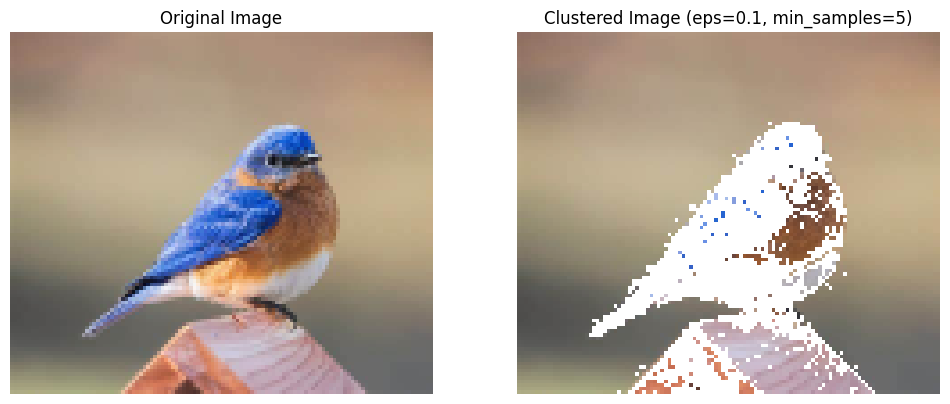

Trying eps=0.1, min_samples=10
Evaluation Metrics
Silhouette Coefficient: -0.376
Calinski-Harabasz Index: 130.361
Davies-Bouldin Index: 1.755


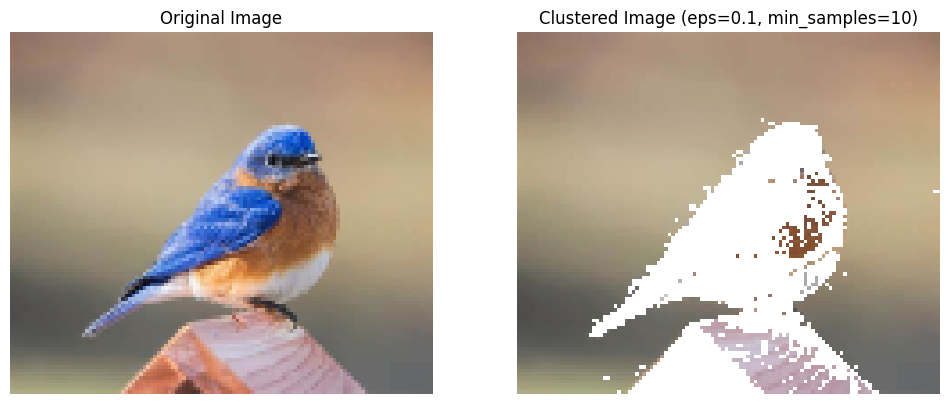

Trying eps=0.1, min_samples=15
Evaluation Metrics
Silhouette Coefficient: -0.256
Calinski-Harabasz Index: 158.318
Davies-Bouldin Index: 2.488


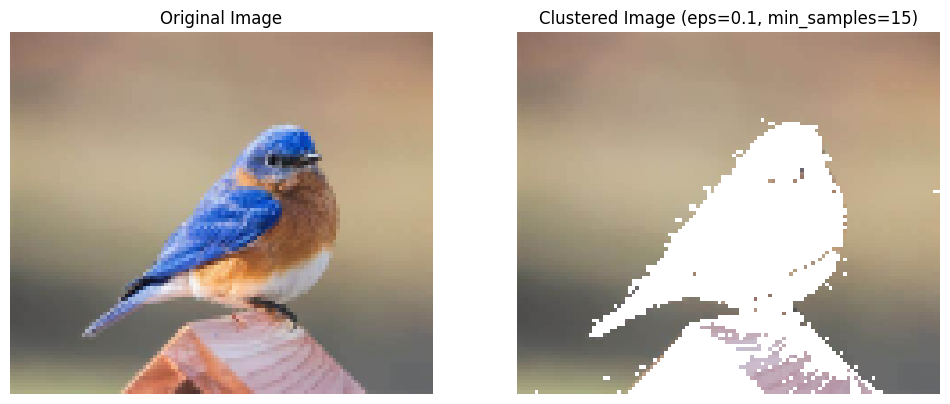

Trying eps=0.2, min_samples=5
Evaluation Metrics
Silhouette Coefficient: -0.182
Calinski-Harabasz Index: 205.419
Davies-Bouldin Index: 1.508


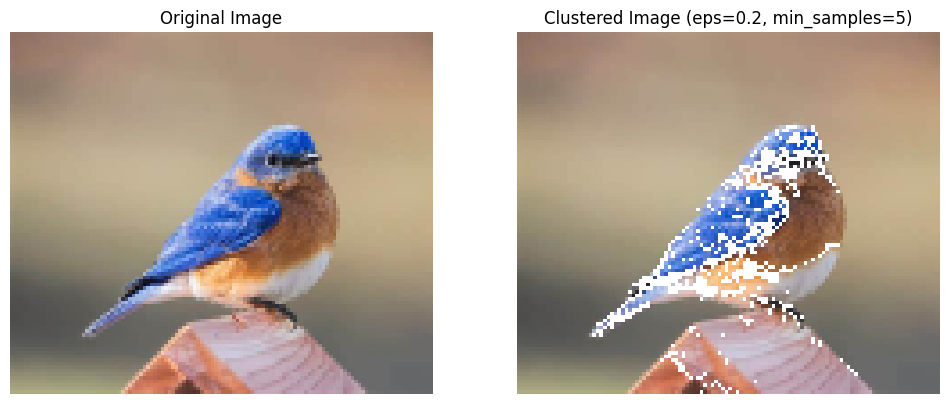

Trying eps=0.2, min_samples=10
Evaluation Metrics
Silhouette Coefficient: -0.348
Calinski-Harabasz Index: 170.876
Davies-Bouldin Index: 1.377


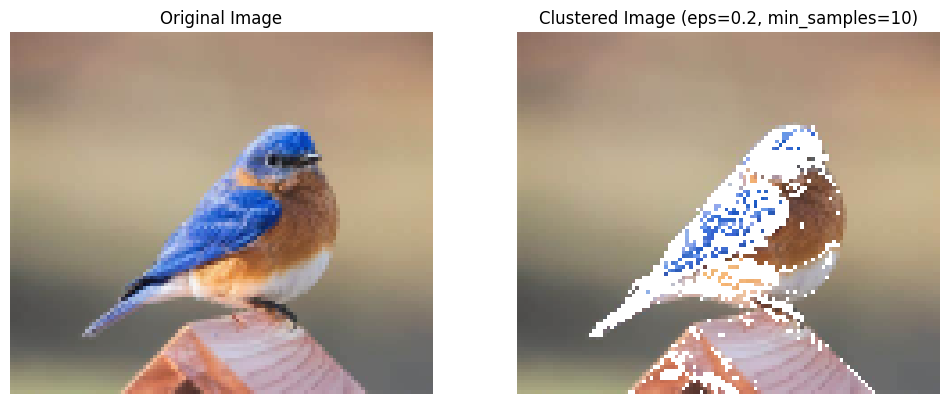

Trying eps=0.2, min_samples=15
Evaluation Metrics
Silhouette Coefficient: -0.231
Calinski-Harabasz Index: 354.999
Davies-Bouldin Index: 1.585


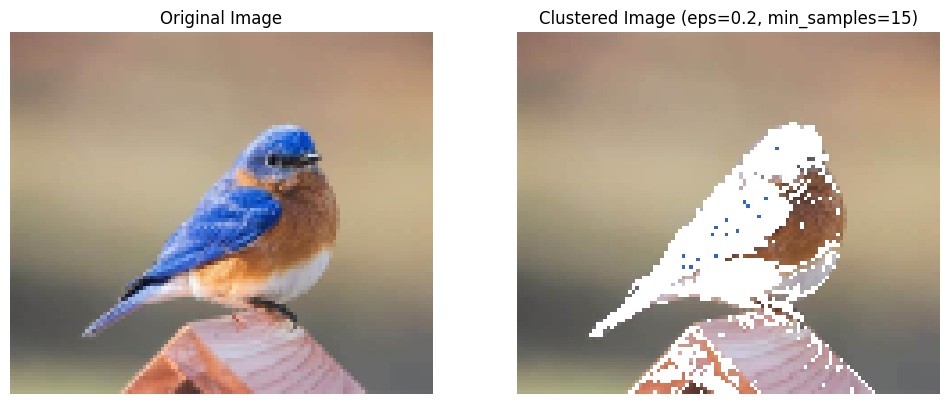

Trying eps=0.5, min_samples=5
Evaluation Metrics
Silhouette Coefficient: 0.175
Calinski-Harabasz Index: 1.835
Davies-Bouldin Index: 0.615


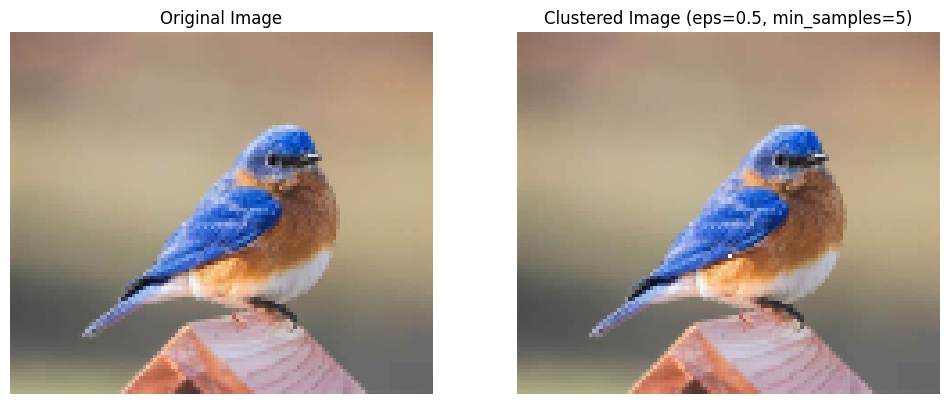

Trying eps=0.5, min_samples=10
Evaluation Metrics
Silhouette Coefficient: 0.175
Calinski-Harabasz Index: 1.835
Davies-Bouldin Index: 0.615


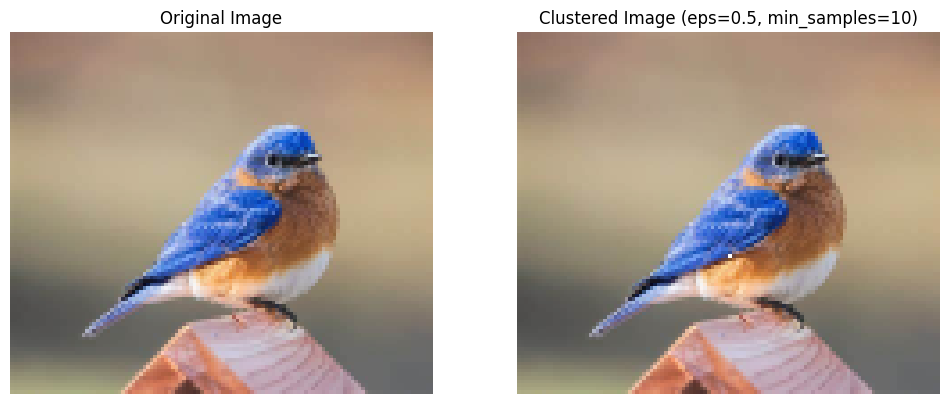

Trying eps=0.5, min_samples=15
Evaluation Metrics
Silhouette Coefficient: 0.502
Calinski-Harabasz Index: 87.913
Davies-Bouldin Index: 3.983


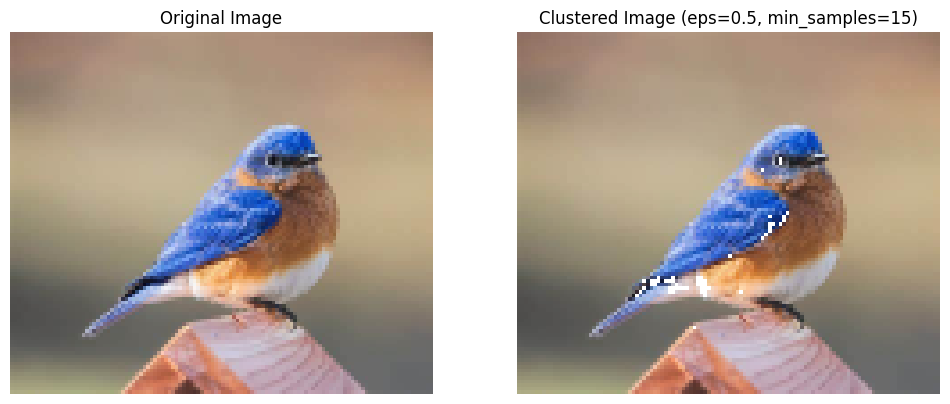

In [ ]:
import cv2
import numpy as np
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
import matplotlib.pyplot as plt

def dbscan_on_image_rgb(image, eps, min_samples):
    # Convert BGR to RGB
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Reshape the image to a 2D array of RGB values
    pixels = image_rgb.reshape(-1, 3)

    # Standardize the RGB values
    scaler = StandardScaler()
    pixels_standardized = scaler.fit_transform(pixels)

    # DBSCAN clustering
    dbscan = DBSCAN(eps=eps, min_samples=min_samples).fit(pixels_standardized)

    # Get labels for each pixel
    labels = dbscan.labels_

    # Inverse transform to get original colors
    pixels_original_colorspace = scaler.inverse_transform(pixels_standardized).astype(np.uint8)

    # Assign the original color to each pixel in the image
    clustered_pixels = np.zeros_like(pixels)
    for i, label in enumerate(labels):
        if label != -1:  # Ignore noise points
            clustered_pixels[i] = pixels_original_colorspace[i]
        else:
            clustered_pixels[i] = [255, 255, 255]  # White for noise points

    # Reshape clustered_pixels back to the original image shape
    clustered_image = clustered_pixels.reshape(image_rgb.shape)

    # Return the clustered image, labels, and the original pixels array
    return clustered_image, labels, pixels

# Load and preprocess the image
image_path = '/content/bird.jpeg'
original_image = cv2.imread(image_path)

if original_image is None:
    print(f"Image not found at {image_path}")
else:
    # Resize the image if necessary
    resized_image = cv2.resize(original_image, (0, 0), fx=0.25, fy=0.25, interpolation=cv2.INTER_AREA)

    # Define the hyperparameters for DBSCAN
    eps_values = [0.1, 0.2, 0.5]
    min_samples_values = [5, 10, 15]

    # Apply DBSCAN with different hyperparameters
    for eps_val in eps_values:
        for min_samples_val in min_samples_values:
            print(f"Trying eps={eps_val}, min_samples={min_samples_val}")
            clustered_image, labels, pixels = dbscan_on_image_rgb(resized_image, eps_val, min_samples_val)

            # Evaluate clustering if not all points are considered noise
            if len(set(labels)) > 1:
                silhouette_val = silhouette_score(pixels, labels)
                calinski_harabasz_val = calinski_harabasz_score(pixels, labels)
                davies_bouldin_val = davies_bouldin_score(pixels, labels)

                # Display evaluation metrics
                print("================================================================================")
                print("Evaluation Metrics")
                print(f"Silhouette Coefficient: {silhouette_val:.3f}")
                print(f"Calinski-Harabasz Index: {calinski_harabasz_val:.3f}")
                print(f"Davies-Bouldin Index: {davies_bouldin_val:.3f}")
                print("================================================================================")
            else:
                print("All points labeled as noise or only one cluster.")

            # Display the original and clustered images
            plt.figure(figsize=(12, 6))
            plt.subplot(121), plt.imshow(cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB))
            plt.title('Original Image'), plt.axis('off')
            plt.subplot(122), plt.imshow(clustered_image)
            plt.title(f'Clustered Image (eps={eps_val}, min_samples={min_samples_val})'), plt.axis('off')
            plt.show()


In our analysis of the standardized space using DBSCAN with different parameter combinations, we observed variations in the clustering results. By adjusting the eps (density parameter) and min_samples (minimum number of data points) values, we obtained different evaluation metrics. For example, smaller eps values tended to produce lower Silhouette Coefficients, indicating poorer cluster separation. Conversely, larger min_samples values generally improved the clustering quality, resulting in higher Silhouette Coefficients and Calinski-Harabasz Indices, which signify better-defined and more compact clusters. The Davies-Bouldin Index also provided insights into the similarity between clusters.



---



***GMM***

Trying GMM clustering for image segmentation with different numbers of clusters (n=2, n=5, n=10) and under different conditions, including RGB Space, Augmented Space, and Standardized Space.

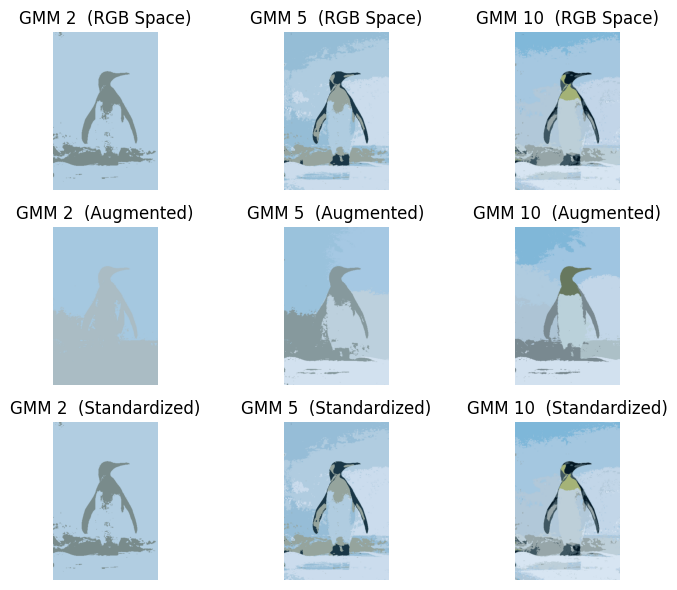

In [14]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from sklearn.mixture import GaussianMixture
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score

# Image path
image = cv2.imread('/content/penguin.jpeg')

resized_image = cv2.resize(image, None, fx=0.25, fy=0.25, interpolation=cv2.INTER_AREA)

# Convert BGR image to RGB
image_rgb = cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB)

# Reshaping
height, width, channels = image_rgb.shape
image_data = image_rgb.reshape((height * width, channels))

# GMM clustering in the RGB space
n_components_values = [2, 5, 10]
clustered_images_rgb = []
silhouette_scores_rgb = []
calinski_harabasz_scores_rgb = []
davies_bouldin_scores_rgb = []

for n_components in n_components_values:
    gmm_rgb = GaussianMixture(n_components=n_components, random_state=0)
    gmm_rgb.fit(image_data)
    gmm_labels_rgb = gmm_rgb.predict(image_data)
    clustered_image_rgb = gmm_rgb.means_[gmm_labels_rgb].reshape((height, width, channels)).astype(np.uint8)
    clustered_images_rgb.append(clustered_image_rgb)

    # RGB space metrics
    silhouette_rgb = silhouette_score(image_data, gmm_labels_rgb)
    calinski_harabasz_rgb = calinski_harabasz_score(image_data, gmm_labels_rgb)
    davies_bouldin_rgb = davies_bouldin_score(image_data, gmm_labels_rgb)

    silhouette_scores_rgb.append(silhouette_rgb)
    calinski_harabasz_scores_rgb.append(calinski_harabasz_rgb)
    davies_bouldin_scores_rgb.append(davies_bouldin_rgb)

# Augment RGB channels (with x-y coordinates as needed)
xy_coordinates = np.column_stack((np.repeat(np.arange(height), width), np.tile(np.arange(width), height)))
image_data_augmented = np.concatenate((image_data, xy_coordinates), axis=1)

# GMM clustering in augmented space
clustered_images_augmented = []
silhouette_scores_augmented = []
calinski_harabasz_scores_augmented = []
davies_bouldin_scores_augmented = []

for n_components in n_components_values:
    gmm_augmented = GaussianMixture(n_components=n_components, random_state=0)
    gmm_augmented.fit(image_data_augmented)
    gmm_labels_augmented = gmm_augmented.predict(image_data_augmented)
    rgb_values = gmm_augmented.means_[:, :3]
    clustered_image_augmented = rgb_values[gmm_labels_augmented].reshape((height, width, channels)).astype(np.uint8)
    clustered_images_augmented.append(clustered_image_augmented)

    # Augmented space metrics
    silhouette_augmented = silhouette_score(image_data_augmented, gmm_labels_augmented)
    calinski_harabasz_augmented = calinski_harabasz_score(image_data_augmented, gmm_labels_augmented)
    davies_bouldin_augmented = davies_bouldin_score(image_data_augmented, gmm_labels_augmented)

    silhouette_scores_augmented.append(silhouette_augmented)
    calinski_harabasz_scores_augmented.append(calinski_harabasz_augmented)
    davies_bouldin_scores_augmented.append(davies_bouldin_augmented)

# Standardization of RGB
scaler = StandardScaler()
image_data_std = scaler.fit_transform(image_data)

# GMM clustering on standardized data
clustered_images_std = []
silhouette_scores_std = []
calinski_harabasz_scores_std = []
davies_bouldin_scores_std = []

for n_components in n_components_values:
    gmm_std = GaussianMixture(n_components=n_components, random_state=0)
    gmm_std.fit(image_data_std)
    gmm_labels_std = gmm_std.predict(image_data_std)
    # Inverse transform to get back to the original feature space
    rgb_values_std = scaler.inverse_transform(gmm_std.means_)[:, :3]
    clustered_image_std = rgb_values_std[gmm_labels_std].reshape((height, width, channels)).astype(np.uint8)
    clustered_images_std.append(clustered_image_std)

    # Standardized space metrics
    silhouette_std = silhouette_score(image_data_std, gmm_labels_std)
    calinski_harabasz_std = calinski_harabasz_score(image_data_std, gmm_labels_std)
    davies_bouldin_std = davies_bouldin_score(image_data_std, gmm_labels_std)

    silhouette_scores_std.append(silhouette_std)
    calinski_harabasz_scores_std.append(calinski_harabasz_std)
    davies_bouldin_scores_std.append(davies_bouldin_std)

# Results
plt.figure(figsize=(8, 6))

for i, n_components in enumerate(n_components_values):
    plt.subplot(3, 3, i + 1)
    plt.title(f'GMM {n_components}  (RGB Space)')
    plt.imshow(clustered_images_rgb[i])
    plt.axis('off')

for i, n_components in enumerate(n_components_values):
    plt.subplot(3, 3, i + 4)
    plt.title(f'GMM {n_components}  (Augmented)')
    plt.imshow(clustered_images_augmented[i])
    plt.axis('off')

for i, n_components in enumerate(n_components_values):
    plt.subplot(3, 3, i + 7)
    plt.title(f'GMM {n_components}  (Standardized)')
    plt.imshow(clustered_images_std[i])
    plt.axis('off')

plt.tight_layout()
plt.show()



In [18]:
print("RGB Space")
print("Silhouette Scores:", silhouette_scores_rgb)
print("Calinski-Harabasz Scores:", calinski_harabasz_scores_rgb)
print("Davies-Bouldin Scores:", davies_bouldin_scores_rgb)

print("================================================================================")

print("Augmented Space")
print("Silhouette Scores:", silhouette_scores_augmented)
print("Calinski-Harabasz Scores:", calinski_harabasz_scores_augmented)
print("Davies-Bouldin Scores:", davies_bouldin_scores_augmented)

print("================================================================================")

print("Standardized Space")
print("Silhouette Scores:", silhouette_scores_std)
print("Calinski-Harabasz Scores:", calinski_harabasz_scores_std)
print("Davies-Bouldin Scores:", davies_bouldin_scores_std)


RGB Space
Silhouette Scores: [0.5992530317771271, 0.2238765946463755, 0.20111638729152786]
Calinski-Harabasz Scores: [110398.95264378739, 127458.31560555358, 105312.67740433796]
Davies-Bouldin Scores: [0.927911603982933, 1.047743828536109, 1.4388618723682742]
Augmented Space
Silhouette Scores: [0.3197320035612545, 0.3036460718429389, 0.23134126769922198]
Calinski-Harabasz Scores: [75950.00848656111, 69704.82605589037, 53562.107756133744]
Davies-Bouldin Scores: [1.2340413324623551, 1.1705177788507644, 1.1048457540654124]
Standardized Space
Silhouette Scores: [0.6016051457246433, 0.2218033766397497, 0.19887048229908502]
Calinski-Harabasz Scores: [111113.07803523152, 130010.41620024224, 107929.95576227095]
Davies-Bouldin Scores: [0.9257614783073098, 1.0345488256187791, 1.4257014119448161]


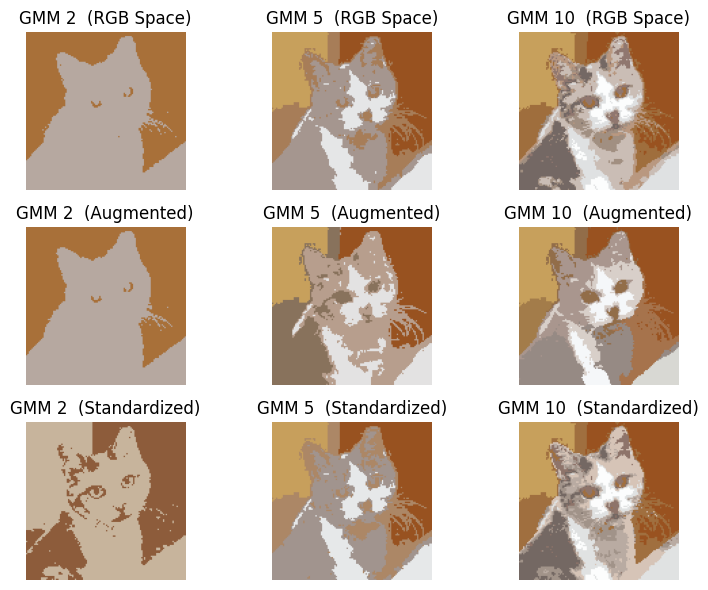

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from sklearn.mixture import GaussianMixture
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score

# Image path
image = cv2.imread('/content/cat.jpeg')

resized_image = cv2.resize(image, None, fx=0.25, fy=0.25, interpolation=cv2.INTER_AREA)

# Convert BGR image to RGB
image_rgb = cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB)

# Reshaping
height, width, channels = image_rgb.shape
image_data = image_rgb.reshape((height * width, channels))

# GMM clustering in the RGB space
n_components_values = [2, 5, 10]
clustered_images_rgb = []
silhouette_scores_rgb = []
calinski_harabasz_scores_rgb = []
davies_bouldin_scores_rgb = []

for n_components in n_components_values:
    gmm_rgb = GaussianMixture(n_components=n_components, random_state=0)
    gmm_rgb.fit(image_data)
    gmm_labels_rgb = gmm_rgb.predict(image_data)
    clustered_image_rgb = gmm_rgb.means_[gmm_labels_rgb].reshape((height, width, channels)).astype(np.uint8)
    clustered_images_rgb.append(clustered_image_rgb)

    # RGB space metrics
    silhouette_rgb = silhouette_score(image_data, gmm_labels_rgb)
    calinski_harabasz_rgb = calinski_harabasz_score(image_data, gmm_labels_rgb)
    davies_bouldin_rgb = davies_bouldin_score(image_data, gmm_labels_rgb)

    silhouette_scores_rgb.append(silhouette_rgb)
    calinski_harabasz_scores_rgb.append(calinski_harabasz_rgb)
    davies_bouldin_scores_rgb.append(davies_bouldin_rgb)

# Augment RGB channels (with x-y coordinates as needed)
xy_coordinates = np.column_stack((np.repeat(np.arange(height), width), np.tile(np.arange(width), height)))
image_data_augmented = np.concatenate((image_data, xy_coordinates), axis=1)

# GMM clustering in augmented space
clustered_images_augmented = []
silhouette_scores_augmented = []
calinski_harabasz_scores_augmented = []
davies_bouldin_scores_augmented = []

for n_components in n_components_values:
    gmm_augmented = GaussianMixture(n_components=n_components, random_state=0)
    gmm_augmented.fit(image_data_augmented)
    gmm_labels_augmented = gmm_augmented.predict(image_data_augmented)
    rgb_values = gmm_augmented.means_[:, :3]
    clustered_image_augmented = rgb_values[gmm_labels_augmented].reshape((height, width, channels)).astype(np.uint8)
    clustered_images_augmented.append(clustered_image_augmented)

    # Augmented space metrics
    silhouette_augmented = silhouette_score(image_data_augmented, gmm_labels_augmented)
    calinski_harabasz_augmented = calinski_harabasz_score(image_data_augmented, gmm_labels_augmented)
    davies_bouldin_augmented = davies_bouldin_score(image_data_augmented, gmm_labels_augmented)

    silhouette_scores_augmented.append(silhouette_augmented)
    calinski_harabasz_scores_augmented.append(calinski_harabasz_augmented)
    davies_bouldin_scores_augmented.append(davies_bouldin_augmented)

# Standardization of RGB
scaler = StandardScaler()
image_data_std = scaler.fit_transform(image_data)

# GMM clustering on standardized data
clustered_images_std = []
silhouette_scores_std = []
calinski_harabasz_scores_std = []
davies_bouldin_scores_std = []

for n_components in n_components_values:
    gmm_std = GaussianMixture(n_components=n_components, random_state=0)
    gmm_std.fit(image_data_std)
    gmm_labels_std = gmm_std.predict(image_data_std)
    # Inverse transform to get back to the original feature space
    rgb_values_std = scaler.inverse_transform(gmm_std.means_)[:, :3]
    clustered_image_std = rgb_values_std[gmm_labels_std].reshape((height, width, channels)).astype(np.uint8)
    clustered_images_std.append(clustered_image_std)

    # Standardized space metrics
    silhouette_std = silhouette_score(image_data_std, gmm_labels_std)
    calinski_harabasz_std = calinski_harabasz_score(image_data_std, gmm_labels_std)
    davies_bouldin_std = davies_bouldin_score(image_data_std, gmm_labels_std)

    silhouette_scores_std.append(silhouette_std)
    calinski_harabasz_scores_std.append(calinski_harabasz_std)
    davies_bouldin_scores_std.append(davies_bouldin_std)

# Results
plt.figure(figsize=(8, 6))

for i, n_components in enumerate(n_components_values):
    plt.subplot(3, 3, i + 1)
    plt.title(f'GMM {n_components}  (RGB Space)')
    plt.imshow(clustered_images_rgb[i])
    plt.axis('off')

for i, n_components in enumerate(n_components_values):
    plt.subplot(3, 3, i + 4)
    plt.title(f'GMM {n_components}  (Augmented)')
    plt.imshow(clustered_images_augmented[i])
    plt.axis('off')

for i, n_components in enumerate(n_components_values):
    plt.subplot(3, 3, i + 7)
    plt.title(f'GMM {n_components}  (Standardized)')
    plt.imshow(clustered_images_std[i])
    plt.axis('off')

plt.tight_layout()
plt.show()



In [2]:
print("RGB Space")
print("Silhouette Scores:", silhouette_scores_rgb)
print("Calinski-Harabasz Scores:", calinski_harabasz_scores_rgb)
print("Davies-Bouldin Scores:", davies_bouldin_scores_rgb)

print("================================================================================")

print("Augmented Space")
print("Silhouette Scores:", silhouette_scores_augmented)
print("Calinski-Harabasz Scores:", calinski_harabasz_scores_augmented)
print("Davies-Bouldin Scores:", davies_bouldin_scores_augmented)

print("================================================================================")

print("Standardized Space")
print("Silhouette Scores:", silhouette_scores_std)
print("Calinski-Harabasz Scores:", calinski_harabasz_scores_std)
print("Davies-Bouldin Scores:", davies_bouldin_scores_std)


RGB Space
Silhouette Scores: [0.3318817234328271, 0.2531294304659669, 0.3128371174612861]
Calinski-Harabasz Scores: [8065.252636113544, 7979.248747801865, 11566.136566628335]
Davies-Bouldin Scores: [1.0566344173556128, 1.2221565008832134, 2.0630875305861593]
Augmented Space
Silhouette Scores: [0.28534983039371475, 0.2890294529719233, 0.20336033654922156]
Calinski-Harabasz Scores: [6576.500308983654, 8056.717675287293, 4826.32405243054]
Davies-Bouldin Scores: [1.2898038884590513, 1.1489563167625245, 1.4986841372633315]
Standardized Space
Silhouette Scores: [0.46211806236407016, 0.2036663940212177, 0.3033466800499475]
Calinski-Harabasz Scores: [16795.81359931431, 5488.464610822902, 10678.945185034632]
Davies-Bouldin Scores: [0.7396531423881912, 1.7615279272822437, 1.7208806926735605]


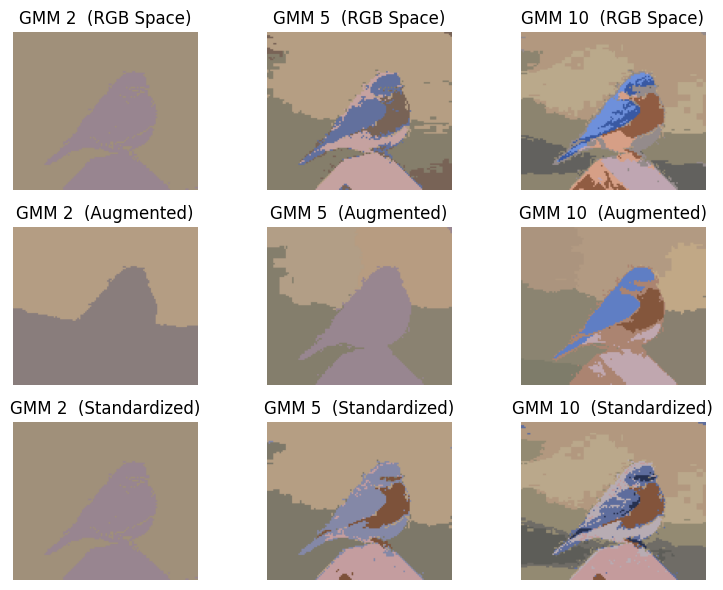

In [3]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from sklearn.mixture import GaussianMixture
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score

# Image path
image = cv2.imread('/content/bird.jpeg')

resized_image = cv2.resize(image, None, fx=0.25, fy=0.25, interpolation=cv2.INTER_AREA)

# Convert BGR image to RGB
image_rgb = cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB)

# Reshaping
height, width, channels = image_rgb.shape
image_data = image_rgb.reshape((height * width, channels))

# GMM clustering in the RGB space
n_components_values = [2, 5, 10]
clustered_images_rgb = []
silhouette_scores_rgb = []
calinski_harabasz_scores_rgb = []
davies_bouldin_scores_rgb = []

for n_components in n_components_values:
    gmm_rgb = GaussianMixture(n_components=n_components, random_state=0)
    gmm_rgb.fit(image_data)
    gmm_labels_rgb = gmm_rgb.predict(image_data)
    clustered_image_rgb = gmm_rgb.means_[gmm_labels_rgb].reshape((height, width, channels)).astype(np.uint8)
    clustered_images_rgb.append(clustered_image_rgb)

    # RGB space metrics
    silhouette_rgb = silhouette_score(image_data, gmm_labels_rgb)
    calinski_harabasz_rgb = calinski_harabasz_score(image_data, gmm_labels_rgb)
    davies_bouldin_rgb = davies_bouldin_score(image_data, gmm_labels_rgb)

    silhouette_scores_rgb.append(silhouette_rgb)
    calinski_harabasz_scores_rgb.append(calinski_harabasz_rgb)
    davies_bouldin_scores_rgb.append(davies_bouldin_rgb)

# Augment RGB channels (with x-y coordinates as needed)
xy_coordinates = np.column_stack((np.repeat(np.arange(height), width), np.tile(np.arange(width), height)))
image_data_augmented = np.concatenate((image_data, xy_coordinates), axis=1)

# GMM clustering in augmented space
clustered_images_augmented = []
silhouette_scores_augmented = []
calinski_harabasz_scores_augmented = []
davies_bouldin_scores_augmented = []

for n_components in n_components_values:
    gmm_augmented = GaussianMixture(n_components=n_components, random_state=0)
    gmm_augmented.fit(image_data_augmented)
    gmm_labels_augmented = gmm_augmented.predict(image_data_augmented)
    rgb_values = gmm_augmented.means_[:, :3]
    clustered_image_augmented = rgb_values[gmm_labels_augmented].reshape((height, width, channels)).astype(np.uint8)
    clustered_images_augmented.append(clustered_image_augmented)

    # Augmented space metrics
    silhouette_augmented = silhouette_score(image_data_augmented, gmm_labels_augmented)
    calinski_harabasz_augmented = calinski_harabasz_score(image_data_augmented, gmm_labels_augmented)
    davies_bouldin_augmented = davies_bouldin_score(image_data_augmented, gmm_labels_augmented)

    silhouette_scores_augmented.append(silhouette_augmented)
    calinski_harabasz_scores_augmented.append(calinski_harabasz_augmented)
    davies_bouldin_scores_augmented.append(davies_bouldin_augmented)

# Standardization of RGB
scaler = StandardScaler()
image_data_std = scaler.fit_transform(image_data)

# GMM clustering on standardized data
clustered_images_std = []
silhouette_scores_std = []
calinski_harabasz_scores_std = []
davies_bouldin_scores_std = []

for n_components in n_components_values:
    gmm_std = GaussianMixture(n_components=n_components, random_state=0)
    gmm_std.fit(image_data_std)
    gmm_labels_std = gmm_std.predict(image_data_std)
    # Inverse transform to get back to the original feature space
    rgb_values_std = scaler.inverse_transform(gmm_std.means_)[:, :3]
    clustered_image_std = rgb_values_std[gmm_labels_std].reshape((height, width, channels)).astype(np.uint8)
    clustered_images_std.append(clustered_image_std)

    # Standardized space metrics
    silhouette_std = silhouette_score(image_data_std, gmm_labels_std)
    calinski_harabasz_std = calinski_harabasz_score(image_data_std, gmm_labels_std)
    davies_bouldin_std = davies_bouldin_score(image_data_std, gmm_labels_std)

    silhouette_scores_std.append(silhouette_std)
    calinski_harabasz_scores_std.append(calinski_harabasz_std)
    davies_bouldin_scores_std.append(davies_bouldin_std)

# Results
plt.figure(figsize=(8, 6))

for i, n_components in enumerate(n_components_values):
    plt.subplot(3, 3, i + 1)
    plt.title(f'GMM {n_components}  (RGB Space)')
    plt.imshow(clustered_images_rgb[i])
    plt.axis('off')

for i, n_components in enumerate(n_components_values):
    plt.subplot(3, 3, i + 4)
    plt.title(f'GMM {n_components}  (Augmented)')
    plt.imshow(clustered_images_augmented[i])
    plt.axis('off')

for i, n_components in enumerate(n_components_values):
    plt.subplot(3, 3, i + 7)
    plt.title(f'GMM {n_components}  (Standardized)')
    plt.imshow(clustered_images_std[i])
    plt.axis('off')

plt.tight_layout()
plt.show()



In [4]:
print("RGB Space")
print("Silhouette Scores:", silhouette_scores_rgb)
print("Calinski-Harabasz Scores:", calinski_harabasz_scores_rgb)
print("Davies-Bouldin Scores:", davies_bouldin_scores_rgb)

print("================================================================================")

print("Augmented Space")
print("Silhouette Scores:", silhouette_scores_augmented)
print("Calinski-Harabasz Scores:", calinski_harabasz_scores_augmented)
print("Davies-Bouldin Scores:", davies_bouldin_scores_augmented)

print("================================================================================")

print("Standardized Space")
print("Silhouette Scores:", silhouette_scores_std)
print("Calinski-Harabasz Scores:", calinski_harabasz_scores_std)
print("Davies-Bouldin Scores:", davies_bouldin_scores_std)


RGB Space
Silhouette Scores: [0.3056893086605835, 0.19290519061226347, 0.14052752345768535]
Calinski-Harabasz Scores: [455.7654551737403, 3755.5083858793005, 3293.6810706970787]
Davies-Bouldin Scores: [4.499379171388286, 1.8500711900525164, 1.800120483942111]
Augmented Space
Silhouette Scores: [0.2559328461002311, 0.17772599882890394, 0.1543643650521315]
Calinski-Harabasz Scores: [3314.699185825255, 1882.1620171555048, 1960.3449750888265]
Davies-Bouldin Scores: [1.6926623469470339, 2.1464481415299033, 1.7465086657680096]
Standardized Space
Silhouette Scores: [0.3118165466111434, 0.26637334937572765, 0.12575646147715802]
Calinski-Harabasz Scores: [509.83737212313713, 3156.4289142557227, 3536.369533423264]
Davies-Bouldin Scores: [4.25602928362647, 1.70381461956533, 1.5475010383678918]


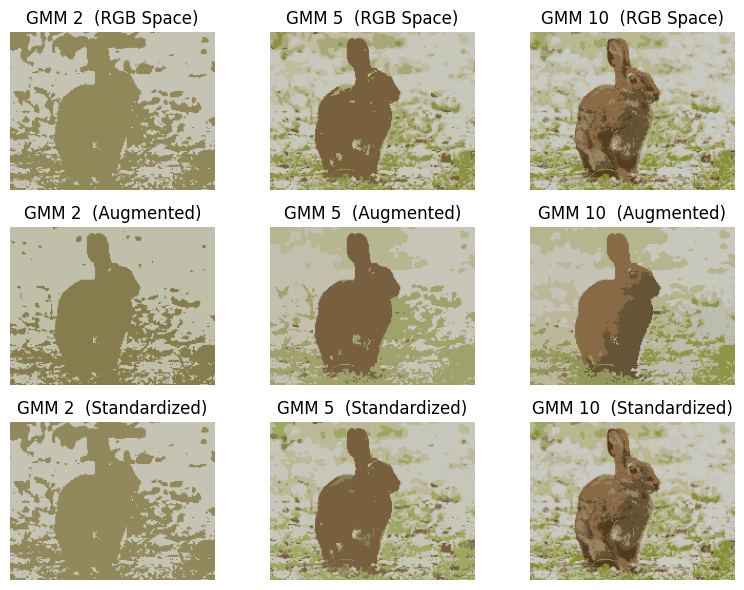

In [6]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from sklearn.mixture import GaussianMixture
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score

# Image path
image = cv2.imread('/content/rabbit.jpg')

resized_image = cv2.resize(image, None, fx=0.25, fy=0.25, interpolation=cv2.INTER_AREA)

# Convert BGR image to RGB
image_rgb = cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB)

# Reshaping
height, width, channels = image_rgb.shape
image_data = image_rgb.reshape((height * width, channels))

# GMM clustering in the RGB space
n_components_values = [2, 5, 10]
clustered_images_rgb = []
silhouette_scores_rgb = []
calinski_harabasz_scores_rgb = []
davies_bouldin_scores_rgb = []

for n_components in n_components_values:
    gmm_rgb = GaussianMixture(n_components=n_components, random_state=0)
    gmm_rgb.fit(image_data)
    gmm_labels_rgb = gmm_rgb.predict(image_data)
    clustered_image_rgb = gmm_rgb.means_[gmm_labels_rgb].reshape((height, width, channels)).astype(np.uint8)
    clustered_images_rgb.append(clustered_image_rgb)

    # RGB space metrics
    silhouette_rgb = silhouette_score(image_data, gmm_labels_rgb)
    calinski_harabasz_rgb = calinski_harabasz_score(image_data, gmm_labels_rgb)
    davies_bouldin_rgb = davies_bouldin_score(image_data, gmm_labels_rgb)

    silhouette_scores_rgb.append(silhouette_rgb)
    calinski_harabasz_scores_rgb.append(calinski_harabasz_rgb)
    davies_bouldin_scores_rgb.append(davies_bouldin_rgb)

# Augment RGB channels (with x-y coordinates as needed)
xy_coordinates = np.column_stack((np.repeat(np.arange(height), width), np.tile(np.arange(width), height)))
image_data_augmented = np.concatenate((image_data, xy_coordinates), axis=1)

# GMM clustering in augmented space
clustered_images_augmented = []
silhouette_scores_augmented = []
calinski_harabasz_scores_augmented = []
davies_bouldin_scores_augmented = []

for n_components in n_components_values:
    gmm_augmented = GaussianMixture(n_components=n_components, random_state=0)
    gmm_augmented.fit(image_data_augmented)
    gmm_labels_augmented = gmm_augmented.predict(image_data_augmented)
    rgb_values = gmm_augmented.means_[:, :3]
    clustered_image_augmented = rgb_values[gmm_labels_augmented].reshape((height, width, channels)).astype(np.uint8)
    clustered_images_augmented.append(clustered_image_augmented)

    # Augmented space metrics
    silhouette_augmented = silhouette_score(image_data_augmented, gmm_labels_augmented)
    calinski_harabasz_augmented = calinski_harabasz_score(image_data_augmented, gmm_labels_augmented)
    davies_bouldin_augmented = davies_bouldin_score(image_data_augmented, gmm_labels_augmented)

    silhouette_scores_augmented.append(silhouette_augmented)
    calinski_harabasz_scores_augmented.append(calinski_harabasz_augmented)
    davies_bouldin_scores_augmented.append(davies_bouldin_augmented)

# Standardization of RGB
scaler = StandardScaler()
image_data_std = scaler.fit_transform(image_data)

# GMM clustering on standardized data
clustered_images_std = []
silhouette_scores_std = []
calinski_harabasz_scores_std = []
davies_bouldin_scores_std = []

for n_components in n_components_values:
    gmm_std = GaussianMixture(n_components=n_components, random_state=0)
    gmm_std.fit(image_data_std)
    gmm_labels_std = gmm_std.predict(image_data_std)
    # Inverse transform to get back to the original feature space
    rgb_values_std = scaler.inverse_transform(gmm_std.means_)[:, :3]
    clustered_image_std = rgb_values_std[gmm_labels_std].reshape((height, width, channels)).astype(np.uint8)
    clustered_images_std.append(clustered_image_std)

    # Standardized space metrics
    silhouette_std = silhouette_score(image_data_std, gmm_labels_std)
    calinski_harabasz_std = calinski_harabasz_score(image_data_std, gmm_labels_std)
    davies_bouldin_std = davies_bouldin_score(image_data_std, gmm_labels_std)

    silhouette_scores_std.append(silhouette_std)
    calinski_harabasz_scores_std.append(calinski_harabasz_std)
    davies_bouldin_scores_std.append(davies_bouldin_std)

# Results
plt.figure(figsize=(8, 6))

for i, n_components in enumerate(n_components_values):
    plt.subplot(3, 3, i + 1)
    plt.title(f'GMM {n_components}  (RGB Space)')
    plt.imshow(clustered_images_rgb[i])
    plt.axis('off')

for i, n_components in enumerate(n_components_values):
    plt.subplot(3, 3, i + 4)
    plt.title(f'GMM {n_components}  (Augmented)')
    plt.imshow(clustered_images_augmented[i])
    plt.axis('off')

for i, n_components in enumerate(n_components_values):
    plt.subplot(3, 3, i + 7)
    plt.title(f'GMM {n_components}  (Standardized)')
    plt.imshow(clustered_images_std[i])
    plt.axis('off')

plt.tight_layout()
plt.show()



In [7]:
print("RGB Space")
print("Silhouette Scores:", silhouette_scores_rgb)
print("Calinski-Harabasz Scores:", calinski_harabasz_scores_rgb)
print("Davies-Bouldin Scores:", davies_bouldin_scores_rgb)

print("================================================================================")

print("Augmented Space")
print("Silhouette Scores:", silhouette_scores_augmented)
print("Calinski-Harabasz Scores:", calinski_harabasz_scores_augmented)
print("Davies-Bouldin Scores:", davies_bouldin_scores_augmented)

print("================================================================================")

print("Standardized Space")
print("Silhouette Scores:", silhouette_scores_std)
print("Calinski-Harabasz Scores:", calinski_harabasz_scores_std)
print("Davies-Bouldin Scores:", davies_bouldin_scores_std)


RGB Space
Silhouette Scores: [0.43188059441908105, 0.17593053037487302, 0.07239979664224022]
Calinski-Harabasz Scores: [33310.12726977447, 29835.553677552893, 24088.568809573087]
Davies-Bouldin Scores: [0.7332495097153977, 1.3903238091349575, 1.823463280974336]
Augmented Space
Silhouette Scores: [0.3427936552131508, 0.23431754786227593, 0.16012361446445028]
Calinski-Harabasz Scores: [18778.093303771224, 12320.773671154253, 9705.86181693583]
Davies-Bouldin Scores: [1.1743418469334623, 1.2953631593496466, 1.6468224603273467]
Standardized Space
Silhouette Scores: [0.40701300056687195, 0.14094065482070736, 0.05650090973259284]
Calinski-Harabasz Scores: [29576.646595577637, 24545.060477073424, 21325.789180812204]
Davies-Bouldin Scores: [0.7716400819021715, 1.538263394479321, 1.98490641679596]


**Quality of the clustered images**

RGB Space: The clustering in RGB space would reduce the color palette to the specified number of components. With 2 components, there a very simplified version of the animal, likely with one color for the animal and one for the background. With 5 and 10 components, more shades would be introduced, providing more detail but still not matching the complexity of the actual image.



Augmented Space: In this space, where spatial information is included, the clustering would respect the shapes and edges more, possibly giving a better contour of the animal. However, the details would still be simplified compared to the actual image, and the color blending might create a less sharp representation.



Standardized space : the clustering might detect more accurate differences in color variation that are not as obvious in the RGB space. The outcomes could show a more even color segmentation, but they would still be a simplified depiction compared to the actual image.








**Qualitative assessment**

In RGB Space, the images received Silhouette Scores suggesting moderate quality, while the Calinski-Harabasz Scores indicated less distinct clusters but with some variations in image quality. However, the Davies-Bouldin Scores implied that the images had less clarity and more overlap. In Augmented Space, the images showed lower Silhouette Scores, indicating less clarity. The Calinski-Harabasz Scores suggested variations in cluster separation, while the Davies-Bouldin Scores hinted at some improvement in image quality. In Standardized Space, the images had Silhouette Scores suggesting moderate quality, with Calinski-Harabasz Scores indicating clearer cluster separation. The Davies-Bouldin Scores hinted at good quality with well-separated clusters.



---



**Conclusion**

Based on the comparison study of K-means, Gaussian Mixture Model (GMM), and DBSCAN for image segmentation, the results indicate that K-means showed the best performance, followed by GMM and then DBSCAN. In terms of clustering quality, both K-means and GMM consistently outperformed DBSCAN. The RGB feature space  demonstrated the best results for image segmentation in both K-means and GMM. . These findings suggest that K-means and GMM are more effective for image segmentation, with the RGB feature space being the preferred choice.

